In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib
import matplotlib as mpl
import matplotlib.patches as mpatches
import numpy as np
import json
mpl.rcParams['figure.dpi'] = 300
mpl.rcParams['text.usetex'] = True

In [2]:
matplotlib.rc('xtick', labelsize=25) 
matplotlib.rc('ytick', labelsize=25) 
plt.rcParams.update({'font.size': 25})
plt.rcParams.update({'legend.fontsize': 25})

In [3]:
df = pd.read_excel("MEGA_list_of_languages 2_with_daa.xlsx", "MistralAI")

In [4]:
df.rename(columns={"Metrics_x": "Metrics"}, inplace=True)

In [5]:
df_numbers = pd.read_excel("MEGA_list_of_languages 2_with_daa.xlsx", "MistralAI")

lang_info = pd.read_csv("lang_info_all 3.csv")
lang_info["Language"] = lang_info["Language"].apply(lambda x: x.lower())
lang_info


langcode_to_family = lang_info.set_index("ISO code")["Language Family"].to_dict()
langname_to_family = lang_info.set_index("Language")["Language Family"].to_dict()

langcode_to_script = lang_info.set_index("ISO code")["Language Script"].to_dict()
langname_to_script = lang_info.set_index("Language")["Language Script"].to_dict()

def get_lang_family(lang):
    # lang = lang.split("_")[0]
    if "chinese" in lang:
        lang = "mandarin"
    #     if lang == "english" or lang == "en":
    #         return "English"
    if lang in langcode_to_family:
        return langcode_to_family[lang]
    if lang in langname_to_family:
        return langname_to_family[lang]
    return None


def get_lang_script(lang):
    # lang = lang.split("_")[0]
    if "chinese" in lang:
        lang = "mandarin"
    if lang in langcode_to_script:
        return langcode_to_script[lang]
    if lang in langname_to_script:
        return langname_to_script[lang]
    return None

/tmp/ipykernel_3543547/3071937819.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(df_lang_group,x = "Language Class", alpha = 0.7, edgecolor="black", linewidth=1.2, palette="Greens")


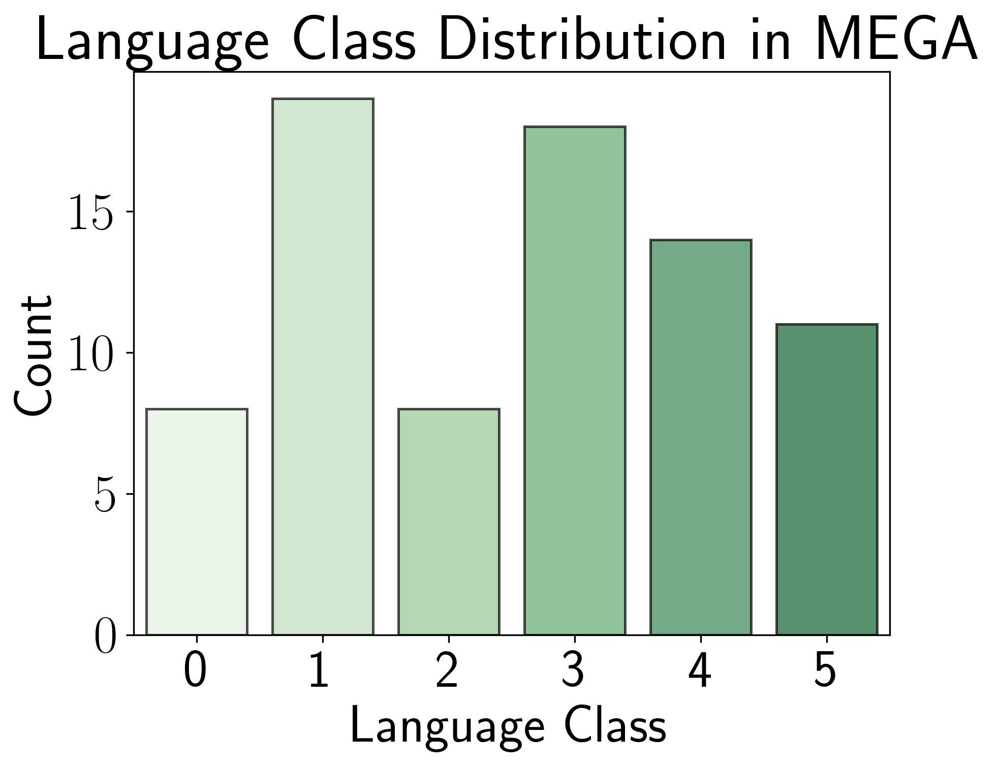

In [6]:
df_lang_group = df.groupby("Language")[["Language Class", "Language Script"]].first().reset_index()
df_lang_group = df_lang_group.dropna(axis=0, subset=["Language Class"])
df_lang_group["Language Class"] = df_lang_group["Language Class"].astype(int)
sns.countplot(df_lang_group,x = "Language Class", alpha = 0.7, edgecolor="black", linewidth=1.2, palette="Greens")
plt.title("Language Class Distribution in MEGA")
plt.ylabel("Count")
plt.savefig("../results/MEGA Results/class_dist.pdf", dpi=300, bbox_inches="tight")
plt.savefig("../results/MEGA Results/class_dist.png", dpi=300, bbox_inches="tight")

In [7]:
lang_info_df = pd.read_csv("lang_info_all 3.csv")
lang_info_df.head()

,Language,Language Family,Language Script,ISO code,Countries
0,Afrikaans,IE: Germanic,Latin,af,"['South Africa', 'Namibia']"
1,Amharic,Afro-Asiatic,Ge'ez (Ethiopic),am,['Ethiopia']
2,Arabic,Afro-Asiatic,Arabic,ar,['Arab League countries']
3,Assamese,IE: Indo-Aryan,Assamese (Brahmic),as,"['India', 'Bangladesh']"
4,Azerbaijani,Turkic,Latin,az,['Azerbaijan']


In [8]:
df_w_lang_fams = pd.merge(df, lang_info_df, left_on = "Language Code", right_on = "ISO code").rename(columns={"Language Script_x": "Language Script"})
df_w_lang_fams.rename(columns={"Metrics_x": "Metrics"}, inplace=True)

df_w_lang_fams

,Dataset,Task,Language_x,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,...,Metrics_y,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,Finetuned mBART/M2M100,Language_y,Language Family,Language Script_y,ISO code,Countries
0,AfriQA,Question Answering,Bemba,NaN,bem,0.0,Latin,NaN,NaN,NaN,...,F1 Score,0.019032,NaN,NaN,NaN,Bemba,Bantu,Latin,bem,['Zambia']
1,AfriQA,Question Answering,Fon,NaN,fon,0.0,Latin,NaN,NaN,NaN,...,F1 Score,0.056181,NaN,NaN,NaN,Fon,Niger-Congo,Latin,fon,['Benin']
2,AfriQA,Question Answering,Hausa,NaN,ha,2.0,Latin,NaN,NaN,NaN,...,F1 Score,0.004167,NaN,NaN,NaN,Hausa,Afro-Asiatic,Latin (Ajami),ha,"['Nigeria', 'Niger']"
3,XLSum,Summarization,Hausa,NaN,ha,2.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Hausa,Afro-Asiatic,Latin (Ajami),ha,"['Nigeria', 'Niger']"
4,AfriQA,Question Answering,Igbo,NaN,ig,1.0,Latin,NaN,NaN,NaN,...,F1 Score,0.000611,NaN,NaN,NaN,Igbo,Atlantic-Congo,Latin,ig,['Nigeria']
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
357,XLSum,Summarization,Kirundi,NaN,rn,1.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Kirundi,Atlantic-Congo,Latin,rn,['Burundi']
358,XLSum,Summarization,Sinhala,NaN,si,0.0,Sinhala,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Sinhala,IE: Indo-Aryan,Sinhala (Brahmic),si,['Sri Lanka']
359,XLSum,Summarization,Somali,NaN,so,1.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Somali,Afro-Asiatic,Latin,so,['Somalia']
360,XLSum,Summarization,Tigrinya,NaN,ti,2.0,Ge'ez,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Tigrinya,Afro-Asiatic,Ge'ez (Ethiopic),ti,"['Eritrea', 'Ethiopia']"


In [9]:
df_numbers['Language'] = df_numbers['Language'].replace('Malyalam', 'Malayalam')
df_numbers['Language Script'] = df_numbers['Language'].apply(lambda x: get_lang_script(x.strip().lower()))
df_numbers['Language Family'] = df_numbers['Language'].apply(lambda x: get_lang_family(x.strip().lower()))

In [10]:
df_numbers.groupby("Language")['Language Family']

In [11]:
df_lang_group

,Language,Language Class,Language Script
0,Afrikaans,3,Latin
1,Amharic,2,Ge'ez
2,Arabic,5,Arabic
3,Assamese,1,Brahmic
4,Azerbaijani,1,Latin
...,...,...,...
82,Vietnamese,4,Latin
83,Welsh,1,Latin
84,Wolof,2,Latin
85,Yoruba,2,Latin


In [12]:
# value_counts() in ascending order

# df_lang_group['Language Family'].value_counts(ascending=True)

/tmp/ipykernel_3543547/1432530515.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(df_lang_group,x = "Language Family", alpha = 1.0, edgecolor="k", linewidth=1.2, palette="Blues",


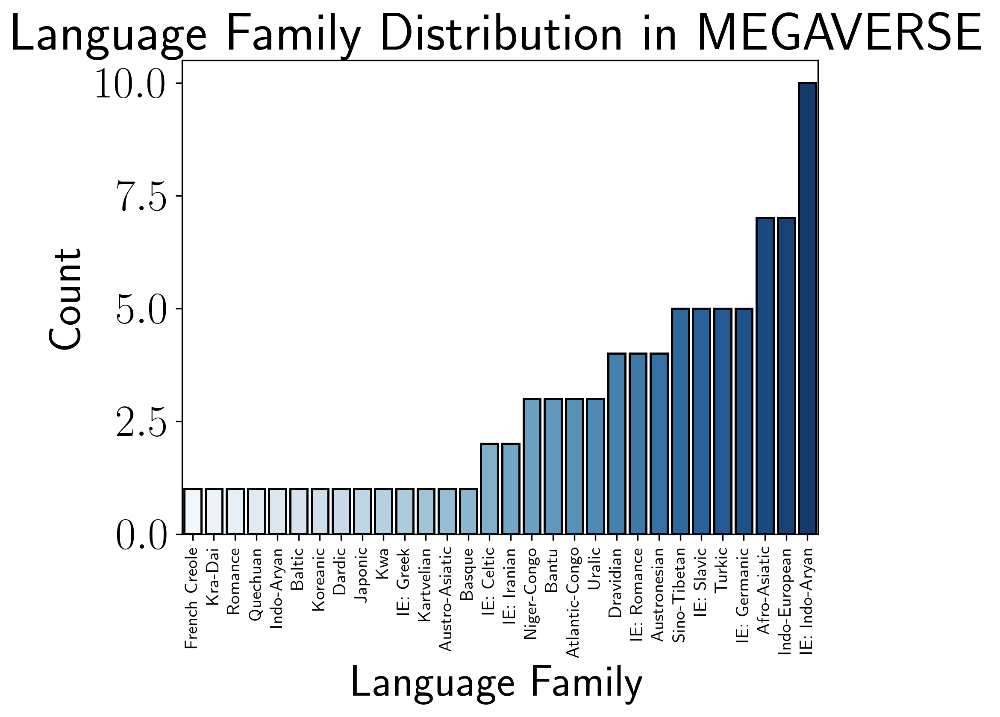

In [13]:
df_lang_group = df_numbers.groupby("Language")[["Language Class", "Language Script", "Language Family"]].first().reset_index()
df_lang_group = df_lang_group.dropna(axis=0, subset=["Language Family"])
sns.countplot(df_lang_group,x = "Language Family", alpha = 1.0, edgecolor="k", linewidth=1.2, palette="Blues",
             order=df_lang_group["Language Family"].value_counts(ascending=True).index)
plt.title("Language Family Distribution in MEGAVERSE")
plt.xticks(rotation=90)
#lower the xtick font size
plt.xticks(fontsize=10)
plt.ylabel("Count")
plt.savefig("../results/MEGA Results/fam_dist.pdf", dpi=300, bbox_inches="tight")
plt.savefig("../results/MEGA Results/fam_dist.png", dpi=300, bbox_inches="tight")
# Rotate the x-axis labels if needed
plt.show()

In [14]:
fine_tuned_models = [
    "TULRv6",
    "BLOOMZ",
    "XLM-R",
    "mBERT",
    "MuRIL",
    "XGLM",
    "mT5",

]

grouped_models = {
    "GPT": [
        "GPT-3.5-Turbo Monolingual",
        "GPT-4 Monolingual",
        "GPT-4 Vision"
    ],
    "PaLM": [
        "PaLM2 Monolingual",
    ],
    "Llama": [
        "Llama2-7B Monolingual",
        "Llama2-13B Monolingual",
        "Llama2-70B Monolingual",
    ],
    "LLaVa": [
        "LLaVa-1.5-13B Monolingual",
        # "LLaVa-1.5-13B Translate-Test",
    ],
    "Mistral": [
        "Mistral-7B-v0.1",
        "Mistral-7B-v0.1-Instruct",
    ],
    
    "Fine Tuned": fine_tuned_models,
}

/tmp/ipykernel_3543547/489353678.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_task_group, x="Task", y="Language", alpha=0.7, edgecolor="black", linewidth=1.2, palette="Greens")


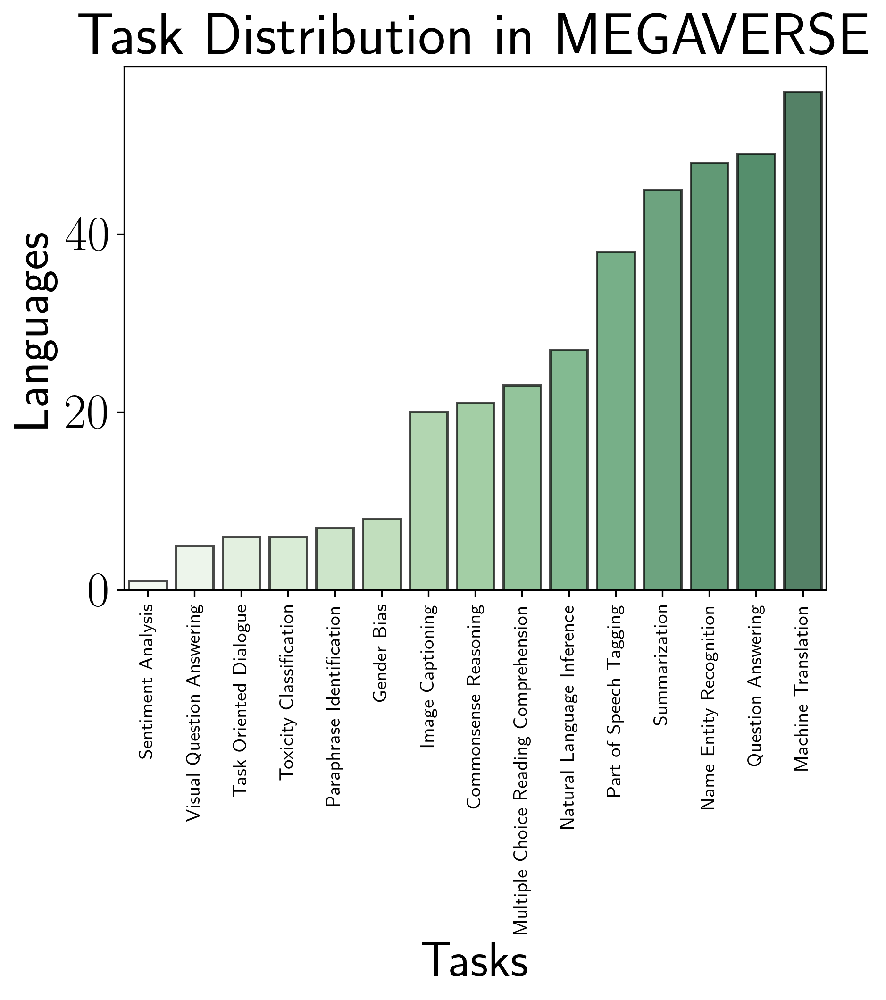

In [15]:
df_task_group = df.groupby("Task", as_index=False)[["Language"]].count()
# sort df_task_group
df_task_group = df_task_group.sort_values(by="Language", ascending=True)
plt.title("Task Distribution in MEGAVERSE")
plt.xticks(rotation=90)
#lower the xtick font size
plt.xticks(fontsize=10)
sns.barplot(data=df_task_group, x="Task", y="Language", alpha=0.7, edgecolor="black", linewidth=1.2, palette="Greens")
# change the y-axis label
plt.ylabel("Languages")
plt.xlabel("Tasks")
plt.savefig("../results/MEGA Results/task_dist.pdf", dpi=300, bbox_inches="tight")
plt.savefig("../results/MEGA Results/task_dist.png", dpi=300, bbox_inches="tight")

/tmp/ipykernel_3543547/3387498150.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(df_lang_group,x = "Language Class", alpha = 0.7, edgecolor="black", linewidth=1.2, palette="Greens")


Text(0, 0.5, 'Count')

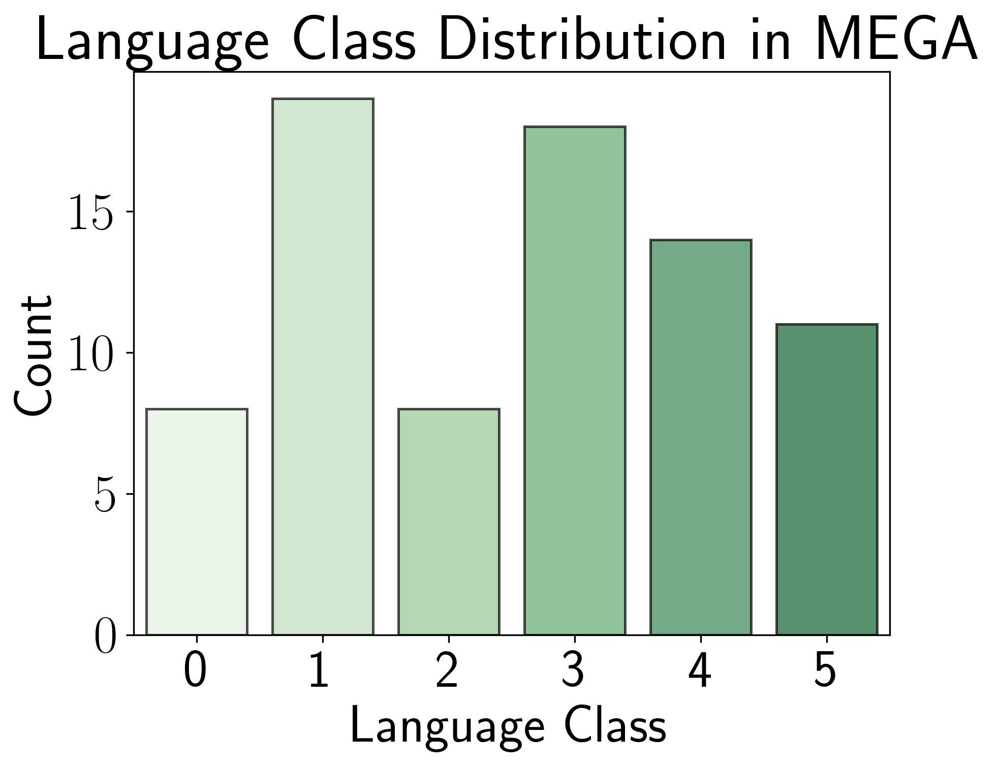

In [16]:
#plot a model_family vs count plot
df_lang_group = df.groupby("Language")[["Language Class", "Language Script"]].first().reset_index()
df_lang_group = df_lang_group.dropna(axis=0, subset=["Language Class"])
df_lang_group["Language Class"] = df_lang_group["Language Class"].astype(int)
sns.countplot(df_lang_group,x = "Language Class", alpha = 0.7, edgecolor="black", linewidth=1.2, palette="Greens")
plt.title("Language Class Distribution in MEGA")
plt.ylabel("Count")

In [17]:
grouped_models

{'GPT': ['GPT-3.5-Turbo Monolingual', 'GPT-4 Monolingual', 'GPT-4 Vision'],
 'PaLM': ['PaLM2 Monolingual'],
 'Llama': ['Llama2-7B Monolingual',
  'Llama2-13B Monolingual',
  'Llama2-70B Monolingual'],
 'LLaVa': ['LLaVa-1.5-13B Monolingual'],
 'Mistral': ['Mistral-7B-v0.1', 'Mistral-7B-v0.1-Instruct'],
 'Fine Tuned': ['TULRv6', 'BLOOMZ', 'XLM-R', 'mBERT', 'MuRIL', 'XGLM', 'mT5']}

In [18]:
df_model_family = pd.DataFrame(columns=["Model Family", "Count"])
for model_family, model_list in grouped_models.items():
    df_model_family = pd.concat([df_model_family, pd.DataFrame({"Model Family": [model_family], "Count": [len(model_list)]})])

In [19]:
df_model_family['Count'] = df_model_family['Count'].astype(int)

In [20]:
# sort dataframe according to count
df_model_family = df_model_family.sort_values(by=['Count'], ascending=True)

/tmp/ipykernel_3543547/180716833.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(df_model_family,x = "Model Family", y='Count', alpha = 0.7, edgecolor="black", linewidth=1.2, palette='Reds')


Text(146.57241966972813, 0.5, 'Count')

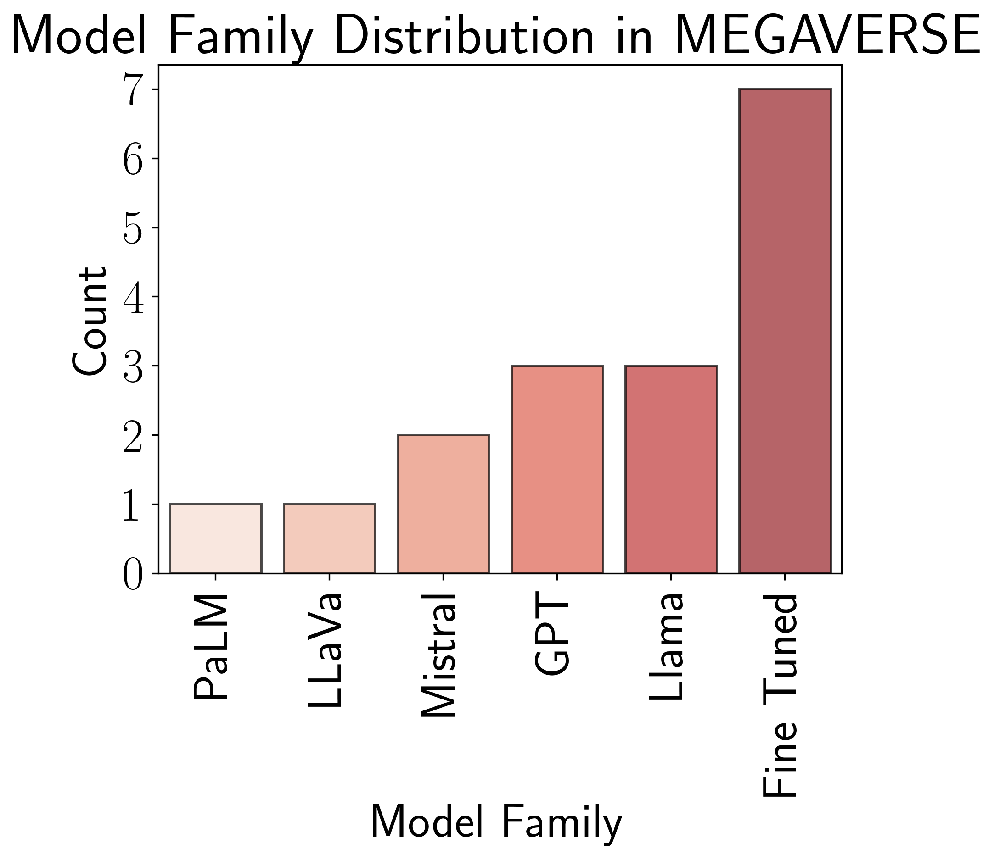

In [21]:
sns.barplot(df_model_family,x = "Model Family", y='Count', alpha = 0.7, edgecolor="black", linewidth=1.2, palette='Reds')
plt.title("Model Family Distribution in MEGAVERSE")
plt.xticks(rotation=90)
# show granular yticks
plt.yticks(np.arange(0, 8, 1))
plt.savefig("../results/MEGA Results/model_fam_dist.pdf", dpi=300, bbox_inches="tight")
plt.savefig("../results/MEGA Results/model_fam_dist.png", dpi=300, bbox_inches="tight")
plt.ylabel("Count")

In [22]:
list(df.columns)

['Dataset',
 'Task',
 'Language',
 'Language Tier',
 'Language Code',
 'Language Class',
 'Language Script',
 'DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'MuRIL',
 'XGLM',
 'mT5',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Metrics',
 'Direction',
 'Metrics_y',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual',
 'GPT4-V Translate-Test',
 'Finetuned mBART/M2M100']

In [23]:
models = list(df.columns)
models = models[7:-7] + models[-4:]

In [24]:
models

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'MuRIL',
 'XGLM',
 'mT5',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual',
 'GPT4-V Translate-Test',
 'Finetuned mBART/M2M100']

In [25]:
df_lang_group.head()

,Language,Language Class,Language Script
0,Afrikaans,3,Latin
1,Amharic,2,Ge'ez
2,Arabic,5,Arabic
3,Assamese,1,Brahmic
4,Azerbaijani,1,Latin


In [26]:
df_w_lang_fams

,Dataset,Task,Language_x,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,...,Metrics_y,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,Finetuned mBART/M2M100,Language_y,Language Family,Language Script_y,ISO code,Countries
0,AfriQA,Question Answering,Bemba,NaN,bem,0.0,Latin,NaN,NaN,NaN,...,F1 Score,0.019032,NaN,NaN,NaN,Bemba,Bantu,Latin,bem,['Zambia']
1,AfriQA,Question Answering,Fon,NaN,fon,0.0,Latin,NaN,NaN,NaN,...,F1 Score,0.056181,NaN,NaN,NaN,Fon,Niger-Congo,Latin,fon,['Benin']
2,AfriQA,Question Answering,Hausa,NaN,ha,2.0,Latin,NaN,NaN,NaN,...,F1 Score,0.004167,NaN,NaN,NaN,Hausa,Afro-Asiatic,Latin (Ajami),ha,"['Nigeria', 'Niger']"
3,XLSum,Summarization,Hausa,NaN,ha,2.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Hausa,Afro-Asiatic,Latin (Ajami),ha,"['Nigeria', 'Niger']"
4,AfriQA,Question Answering,Igbo,NaN,ig,1.0,Latin,NaN,NaN,NaN,...,F1 Score,0.000611,NaN,NaN,NaN,Igbo,Atlantic-Congo,Latin,ig,['Nigeria']
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
357,XLSum,Summarization,Kirundi,NaN,rn,1.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Kirundi,Atlantic-Congo,Latin,rn,['Burundi']
358,XLSum,Summarization,Sinhala,NaN,si,0.0,Sinhala,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Sinhala,IE: Indo-Aryan,Sinhala (Brahmic),si,['Sri Lanka']
359,XLSum,Summarization,Somali,NaN,so,1.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Somali,Afro-Asiatic,Latin,so,['Somalia']
360,XLSum,Summarization,Tigrinya,NaN,ti,2.0,Ge'ez,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Tigrinya,Afro-Asiatic,Ge'ez (Ethiopic),ti,"['Eritrea', 'Ethiopia']"


In [27]:
models

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'MuRIL',
 'XGLM',
 'mT5',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual',
 'GPT4-V Translate-Test',
 'Finetuned mBART/M2M100']

In [28]:
display(df_w_lang_fams[df_w_lang_fams["Language Code"] == "en"].set_index("Dataset")[models])


dataset2en_best_perf = df_w_lang_fams[df_w_lang_fams["Language Code"] == "en"].set_index("Dataset")[models].fillna(0).max(axis = 1).to_dict()
dataset2en_best_perf

,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,IndicTrans2,GPT-3.5-Turbo Monolingual,GPT-3.5-Turbo Translate-Test,GPT-3.5-Turbo Zero-Shot Cross Lingual,GPT-4 Monolingual,GPT-4 Translate-Test,GPT-4 Zero-Shot Cross Lingual,...,Llama2-70B Monolingual,LLaVa-1.5-13B Monolingual,LLaVa-1.5-13B Translate-Test,Bing Translator,Google Translator,Systran,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,Finetuned mBART/M2M100
Dataset,,,,,,,,,,,,,,,,,,,,,
Belebele,NaN,NaN,NaN,NaN,0.877000,NaN,NaN,0.790000,NaN,NaN,...,0.788000,NaN,NaN,NaN,NaN,NaN,0.650000,NaN,NaN,NaN
MLQA,0.747959,0.747959,NaN,NaN,0.727664,0.727664,NaN,0.803408,NaN,0.803408,...,0.560600,NaN,NaN,NaN,NaN,NaN,0.323067,NaN,NaN,NaN
PAN-X,NaN,NaN,NaN,NaN,0.431520,NaN,NaN,0.497189,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PAWS-X,0.725000,0.725000,0.725000,NaN,0.724000,0.724000,0.724000,0.762000,NaN,NaN,...,0.532000,NaN,NaN,NaN,NaN,NaN,0.653216,NaN,NaN,NaN
TyDiQA-GoldP,0.737305,NaN,0.737305,NaN,0.547819,NaN,NaN,0.728700,NaN,NaN,...,0.286700,NaN,NaN,NaN,NaN,NaN,0.408535,NaN,NaN,NaN
UDPOS,NaN,NaN,NaN,NaN,0.784928,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
XCOPA,0.982000,0.982000,0.982000,NaN,0.978000,0.978000,0.978000,0.996000,0.996000,NaN,...,0.940000,NaN,NaN,NaN,NaN,NaN,0.920000,NaN,NaN,NaN
XLSum,NaN,NaN,NaN,NaN,0.258700,NaN,NaN,0.274600,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
XM3600,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,31.725896,NaN,NaN,NaN,NaN,NaN,0.631461,NaN,NaN


{'Belebele': 0.922222222222222,
 'MLQA': 0.8659,
 'PAN-X': 0.864365,
 'PAWS-X': 0.9715,
 'TyDiQA-GoldP': 0.853540968949426,
 'UDPOS': 0.970245,
 'XCOPA': 0.996,
 'XLSum': 0.351,
 'XM3600': 31.72589577,
 'XNLI': 0.9325,
 'XQuAD': 0.920765,
 'X-RiSAWOZ': 0.87,
 'XstoryCloze': 0.996029119788219}

In [29]:
df_w_lang_fams.apply(lambda x: x["GPT-3.5-Turbo Monolingual"] / dataset2en_best_perf.get(x["Dataset"], 1) ,axis = 1)

0      0.044000
1      0.105000
2      0.112000
3      0.675783
4      0.205000
         ...   
357    0.584330
358    0.263248
359    0.605128
360    0.000000
361    0.335613
Length: 362, dtype: float64

In [30]:
xnli_df = df[df["Dataset"] == "XNLI"]

In [31]:
[model for model in models if not xnli_df[model].isna().all()]

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'XGLM',
 'mT5',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'Mistral-7B-Instruct-v0.1']

In [32]:
[model for model in models if not ("TULRv6" in models and model in ["XLM-R", "mBERT", "mT5"])]

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'MuRIL',
 'XGLM',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual',
 'GPT4-V Translate-Test',
 'Finetuned mBART/M2M100']

In [33]:
xnli_df["en_pref"] = xnli_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)

xnli_df = xnli_df.sort_values(["en_pref", "Language"])

/tmp/ipykernel_3543547/694233914.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  xnli_df["en_pref"] = xnli_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


In [34]:
df.columns

Index(['Dataset', 'Task', 'Language', 'Language Tier', 'Language Code',
       'Language Class', 'Language Script', 'DV003 Monolingual',
       'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'IndicTrans2',
       'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test',
       'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual',
       'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6',
       'BLOOMZ', 'XLM-R', 'mBERT', 'MuRIL', 'XGLM', 'mT5', 'PaLM2 Zero-Shot',
       'PaLM2 Monolingual', 'Llama2-7B Monolingual', 'Llama2-13B Monolingual',
       'Llama2-70B Monolingual', 'LLaVa-1.5-13B Monolingual',
       'LLaVa-1.5-13B Translate-Test', 'Bing Translator', 'Google Translator',
       'Systran', 'Metrics', 'Direction', 'Metrics_y',
       'Mistral-7B-Instruct-v0.1', 'GPT4-V Monolingual',
       'GPT4-V Translate-Test', 'Finetuned mBART/M2M100'],
      dtype='object')

In [35]:
models

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'MuRIL',
 'XGLM',
 'mT5',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual',
 'GPT4-V Translate-Test',
 'Finetuned mBART/M2M100']

In [36]:
models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 


categories = xnli_df['Language'].tolist()
group_names = [model for model in models if not xnli_df[model].isna().all()]
bar_width = 0.12
x = np.arange(len(categories))

hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(60, 30))

for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
    l = ax.bar(x + offset, xnli_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2)


ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel('Language')
ax.set_ylabel(df["Metrics"].unique()[0])
ax.set_title('XNLI')
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
plt.show()

In [37]:
df["Dataset"].unique().tolist()

['AfriQA',
 'Belebele',
 'GLUECoS-NLI',
 'GLUECoS-SA',
 'IN22_conv_en_indic',
 'IN22_conv_indic_en',
 'IN22_gen_indic_en',
 'IN22_gen_en_indic',
 'IndicQA',
 'IndicXNLI',
 'Jigsaw',
 'MARVL',
 'MLQA',
 'PAN-X',
 'PAWS-X',
 'TyDiQA-GoldP',
 'UDPOS',
 'WinoMT',
 'XCOPA',
 'XLSum',
 'XM3600',
 'XNLI',
 'XQuAD',
 'X-RiSAWOZ',
 'XstoryCloze']

In [38]:
l[0].get_facecolor()

(0.8392156862745098, 0.15294117647058825, 0.1568627450980392, 0.7)

In [39]:
df

,Dataset,Task,Language,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,...,Bing Translator,Google Translator,Systran,Metrics,Direction,Metrics_y,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,Finetuned mBART/M2M100
0,AfriQA,Question Answering,Bemba,NaN,bem,0.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,0.019032,NaN,NaN,NaN
1,AfriQA,Question Answering,Fon,NaN,fon,0.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,0.056181,NaN,NaN,NaN
2,AfriQA,Question Answering,Hausa,NaN,ha,2.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,0.004167,NaN,NaN,NaN
3,AfriQA,Question Answering,Igbo,NaN,ig,1.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,0.000611,NaN,NaN,NaN
4,AfriQA,Question Answering,Kinyarwanda,NaN,rw,0.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,0.018608,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
355,XstoryCloze,Commonsense Reasoning,Burmese,NaN,my,1.0,Brahmic,0.473858,0.901390,0.580410,...,NaN,NaN,NaN,Accuracy,HigherBetter,Accuracy,0.000662,NaN,NaN,NaN
356,XstoryCloze,Commonsense Reasoning,Russian,2.0,ru,4.0,Cyrillic,0.941760,0.968895,0.949702,...,NaN,NaN,NaN,Accuracy,HigherBetter,Accuracy,0.008604,NaN,NaN,NaN
357,XstoryCloze,Commonsense Reasoning,Swahili,NaN,sw,2.0,Latin,0.780940,0.906684,0.775645,...,NaN,NaN,NaN,Accuracy,HigherBetter,Accuracy,0.000000,NaN,NaN,NaN
358,XstoryCloze,Commonsense Reasoning,Telugu,NaN,te,1.0,Brahmic,0.576439,0.943084,0.630046,...,NaN,NaN,NaN,Accuracy,HigherBetter,Accuracy,0.411950,NaN,NaN,NaN


In [40]:
df['Metrics'].unique()[0]

'F1 Score'

In [41]:
colors_all = []
for task in df["Dataset"].unique().tolist():

    task_df = df[df["Dataset"] == task]
    task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
    task_df = task_df.sort_values(["en_pref", "Language"])
    # models = list(df.columns)
    # models = models[6:-2]
#     models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    categories = task_df['Language'].tolist()
    group_names = [model for model in models if not task_df[model].isna().all()]
    bar_width = 0.12
    x = np.arange(len(categories))

    hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    # font = {'family' : 'normal',
    #     'weight' : 'bold',
    #     'size'   : 0}

    # matplotlib.rc('font', **font)
    
    alpha = 0.7
    fig, ax = plt.subplots(figsize=(80, 40))
    
    for i, group_name in enumerate(group_names):
        offset = (i - len(group_names) // 2) * bar_width
        l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
              edgecolor='black', linewidth=1.2)
        for ele in l:
            colors_all.append(ele.get_facecolor())

    # sns.set(font_scale=3)

    # ax.set_xticks(x)
    # ax.set_xticklabels(categories)
    # ax.set_xlabel('Language')
    # ax.set_ylabel(df["Metrics"].unique()[0])
    # ax.set_title(task)
    # ax.legend(loc="lower center", ncols=len(models), bbox_to_anchor=(0.5, -0.3))
    # plt.show()

/tmp/ipykernel_3543547/4127499003.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
/tmp/ipykernel_3543547/4127499003.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
/tmp/ipykernel_3543547/4127499003.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = 

In [42]:
unq_colors = set(colors_all)

In [43]:
models = list(df.columns)
models = models[6:-2]
models

['Language Script',
 'DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'MuRIL',
 'XGLM',
 'mT5',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Metrics',
 'Direction',
 'Metrics_y',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual']

In [44]:
import random
#44, 88, 77, 55, 66, 33
random.seed(77)
unq_colors = set(colors_all)
unq_colors = list(unq_colors)
random.shuffle(unq_colors)
len(unq_colors)

10

In [45]:
len(unq_colors)

10

In [46]:
unq_colors[9]

(0.8392156862745098, 0.15294117647058825, 0.1568627450980392, 0.7)

In [47]:
models_all = [
    "DV003 Monolingual",
    "DV003 TranslateTest",
    "DV003 Zero-Shot Cross Lingual",
    "GPT-3.5-Turbo Monolingual",
    "GPT-3.5-Turbo Translate-Test",
    "GPT-3.5-Turbo Zero-Shot Cross Lingual",
    "GPT-4 Monolingual",
    "GPT-4 Translate-Test",
    "GPT-4 Zero-Shot Cross Lingual",
    "TULRv6",
    "BLOOMZ",
    "MuRIL",
    "mT5",
    "mBERT",
    "XLM-R",
    # "PaLM 2 Few-Shot",
    "PaLM2 Monolingual",
    "PaLM2 Zero-Shot",
    "Bing Translator",
    "Google Translator",
    "Mistral-7B-Instruct-v0.1",
    "Llama2-70B Monolingual"
]

model2color = {
    "DV003": unq_colors[9],
    "DV003 Monolingual": unq_colors[9],
    "DV003 TranslateTest": unq_colors[9],
    "DV003 Zero-Shot Cross Lingual": unq_colors[9],
    'GPT-3.5-Turbo': unq_colors[7],
    'GPT-3.5-Turbo Monolingual': unq_colors[7],
    'GPT-3.5-Turbo Translate-Test': unq_colors[7],
    "GPT-3.5-Turbo Zero-Shot Cross Lingual": unq_colors[7],
    'GPT-4': unq_colors[0],
    'GPT-4 Monolingual': unq_colors[0],
    'GPT-4 Translate-Test': unq_colors[0],
    'GPT-4 Zero-Shot Cross Lingual': unq_colors[0],
    "GPT-3.5-Turbo / GPT-4": unq_colors[7],
    "TULRv6": unq_colors[3],
    "BLOOM": unq_colors[4],
    "BLOOMZ": unq_colors[4],
    "MuRIL": unq_colors[5],
    "mT5": unq_colors[6],
    "mBERT": unq_colors[5],
    "XLM-R": unq_colors[6],
    "PaLM2 Monolingual":unq_colors[2],
    "PaLM2 Zero-Shot":unq_colors[2],
    "Bing Translator": unq_colors[8],
    'Google Translator': unq_colors[1],
    'Mistral-7B-Instruct-v0.1': unq_colors[4],
    'Llama2-70B Monolingual': unq_colors[3]
}
model2hatches = {
    "DV003 TranslateTest": "/",
    "DV003 Zero-Shot Cross Lingual": "o",
    "GPT-3.5-Turbo Translate-Test": "/",
    "GPT-3.5-Turbo Zero-Shot Cross Lingual": "o",
    "GPT-4 Translate-Test": "/",
    "GPT-4 Zero-Shot Cross Lingual": "o",
    "Mistral-7B-Instruct-v0.1": ".",
    "Llama2-70B Monolingual": "."
}

In [48]:
task_df.columns

Index(['Dataset', 'Task', 'Language', 'Language Tier', 'Language Code',
       'Language Class', 'Language Script', 'DV003 Monolingual',
       'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'IndicTrans2',
       'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test',
       'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual',
       'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6',
       'BLOOMZ', 'XLM-R', 'mBERT', 'MuRIL', 'XGLM', 'mT5', 'PaLM2 Zero-Shot',
       'PaLM2 Monolingual', 'Llama2-7B Monolingual', 'Llama2-13B Monolingual',
       'Llama2-70B Monolingual', 'LLaVa-1.5-13B Monolingual',
       'LLaVa-1.5-13B Translate-Test', 'Bing Translator', 'Google Translator',
       'Systran', 'Metrics', 'Direction', 'Metrics_y',
       'Mistral-7B-Instruct-v0.1', 'GPT4-V Monolingual',
       'GPT4-V Translate-Test', 'Finetuned mBART/M2M100', 'en_pref'],
      dtype='object')

In [49]:
df.columns

Index(['Dataset', 'Task', 'Language', 'Language Tier', 'Language Code',
       'Language Class', 'Language Script', 'DV003 Monolingual',
       'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'IndicTrans2',
       'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test',
       'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual',
       'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6',
       'BLOOMZ', 'XLM-R', 'mBERT', 'MuRIL', 'XGLM', 'mT5', 'PaLM2 Zero-Shot',
       'PaLM2 Monolingual', 'Llama2-7B Monolingual', 'Llama2-13B Monolingual',
       'Llama2-70B Monolingual', 'LLaVa-1.5-13B Monolingual',
       'LLaVa-1.5-13B Translate-Test', 'Bing Translator', 'Google Translator',
       'Systran', 'Metrics', 'Direction', 'Metrics_y',
       'Mistral-7B-Instruct-v0.1', 'GPT4-V Monolingual',
       'GPT4-V Translate-Test', 'Finetuned mBART/M2M100'],
      dtype='object')

In [50]:
df[df["Dataset"] == "IndicQA"]

,Dataset,Task,Language,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,...,Bing Translator,Google Translator,Systran,Metrics,Direction,Metrics_y,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,Finetuned mBART/M2M100
91,IndicQA,Question Answering,Assamese,NaN,as,1.0,Brahmic,NaN,NaN,0.066956,...,NaN,NaN,NaN,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN
92,IndicQA,Question Answering,Bengali,NaN,bn,3.0,Brahmic,NaN,NaN,0.102969,...,NaN,NaN,NaN,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN
93,IndicQA,Question Answering,Gujarati,NaN,gu,1.0,Devanagari,NaN,NaN,0.053715,...,NaN,NaN,NaN,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN
94,IndicQA,Question Answering,Hindi,NaN,hi,4.0,Devanagari,NaN,NaN,0.167830,...,NaN,NaN,NaN,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN
95,IndicQA,Question Answering,Kannada,NaN,kn,1.0,Brahmic,NaN,NaN,0.071007,...,NaN,NaN,NaN,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN
96,IndicQA,Question Answering,Malayalam,NaN,ml,1.0,Brahmic,NaN,NaN,0.035736,...,NaN,NaN,NaN,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN
97,IndicQA,Question Answering,Marathi,NaN,mr,2.0,Devanagari,NaN,NaN,0.145524,...,NaN,NaN,NaN,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN
98,IndicQA,Question Answering,Oriya,NaN,or,1.0,Brahmic,NaN,NaN,0.068581,...,NaN,NaN,NaN,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN
99,IndicQA,Question Answering,Punjabi,NaN,pa,2.0,Gurmukhi,NaN,NaN,0.106540,...,NaN,NaN,NaN,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN
100,IndicQA,Question Answering,Tamil,NaN,ta,3.0,Brahmic,NaN,NaN,0.042041,...,NaN,NaN,NaN,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN


In [51]:
def change_width(ax, new_value) :
    for patch in ax.patches :
        current_width = patch.get_width()
        diff = current_width - new_value

        # we change the bar width
        patch.set_width(new_value)

        # we recenter the bar
        patch.set_x(patch.get_x() + diff * .5)

AfriQA


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


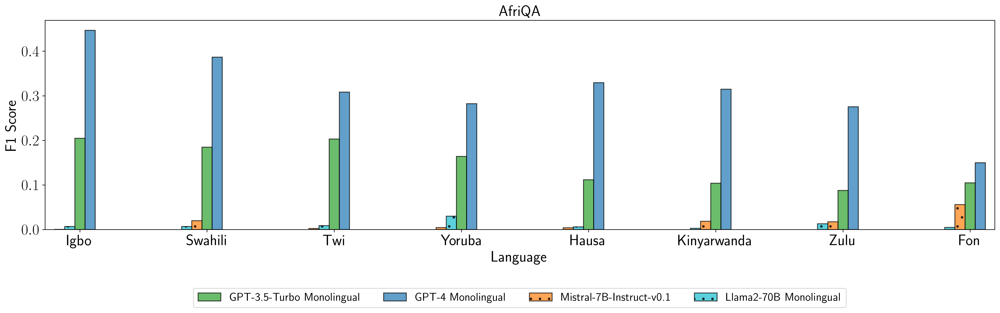

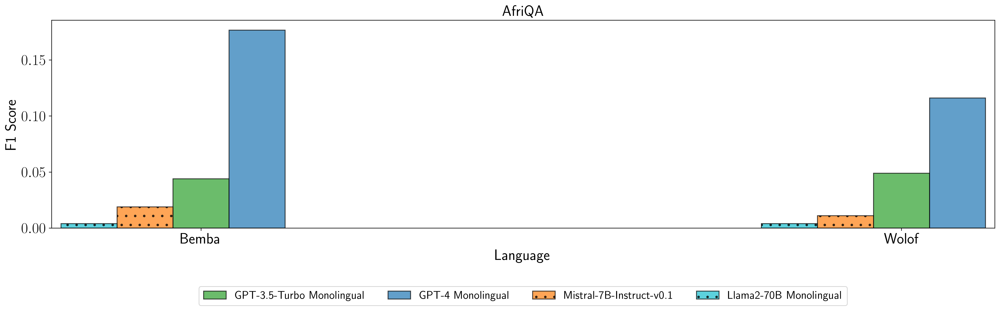

Belebele


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


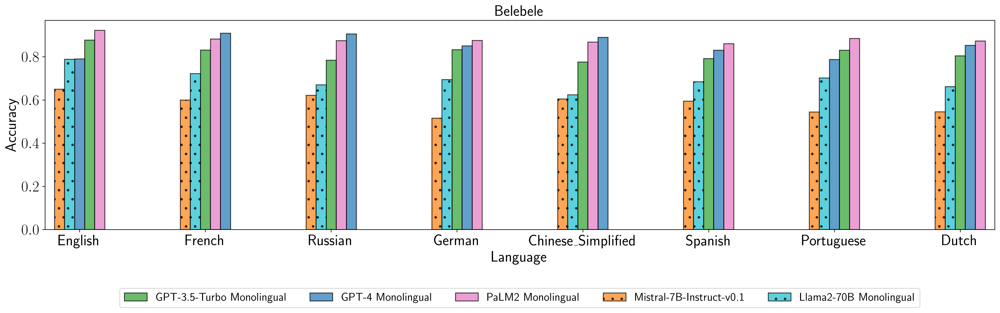

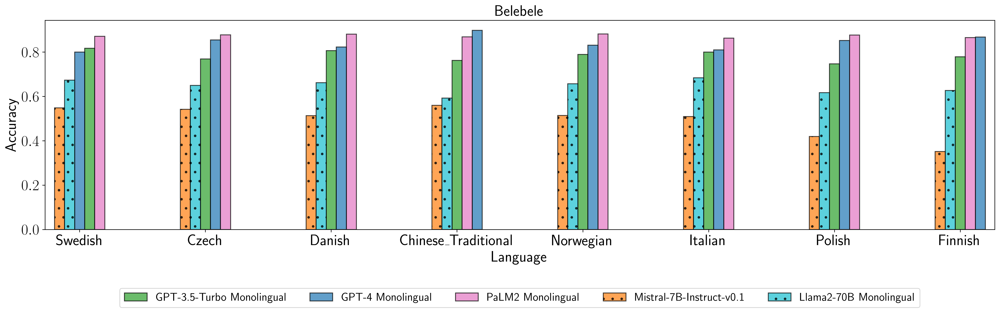

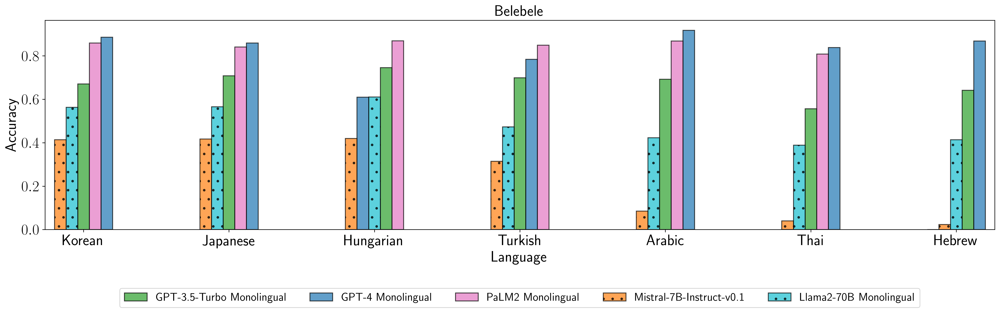

GLUECoS-NLI


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


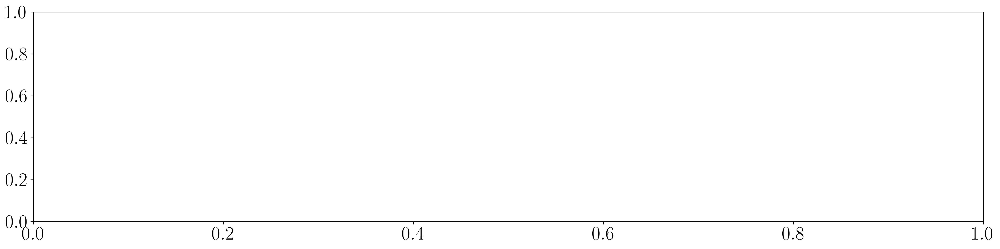

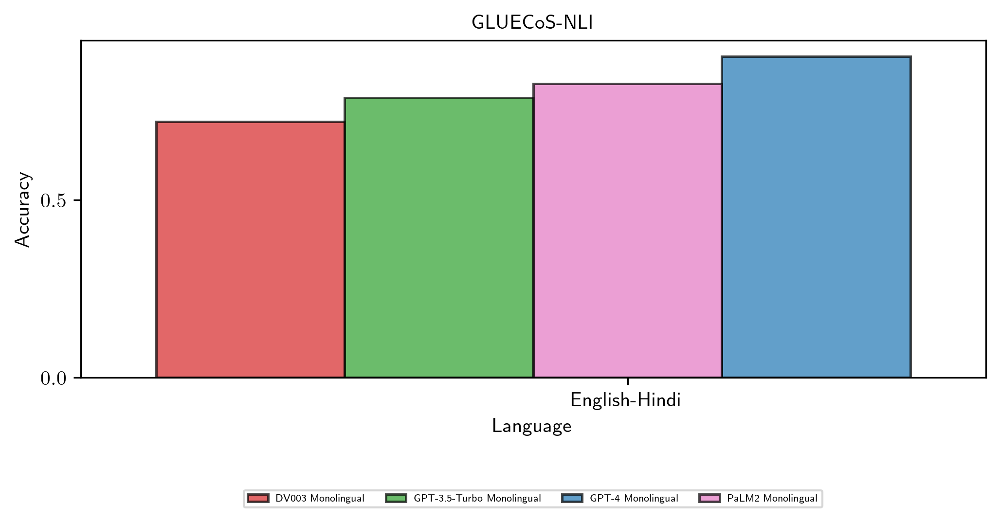

GLUECoS-SA


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


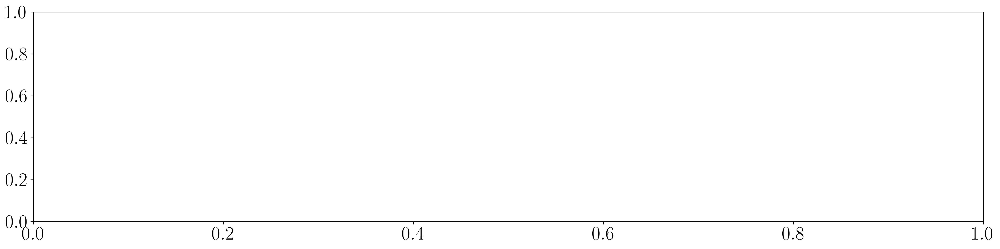

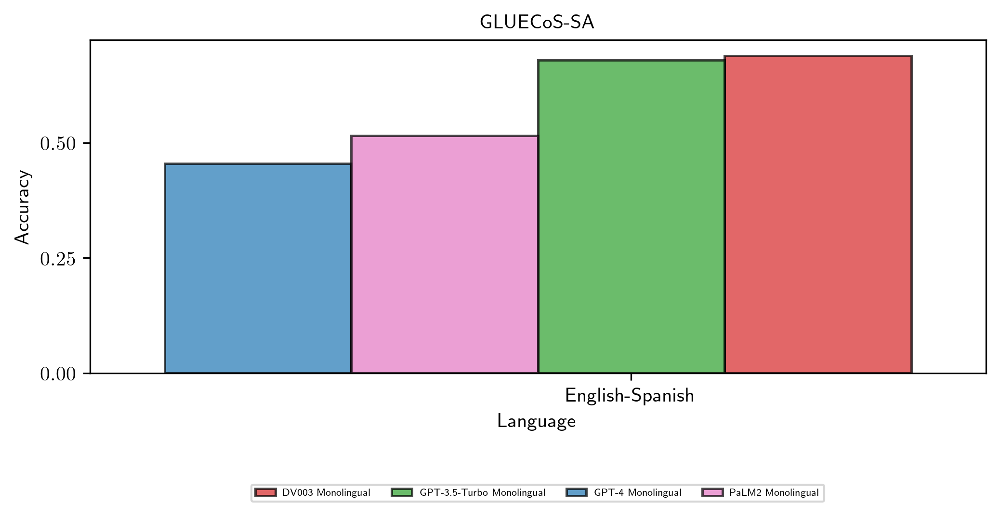

IN22_conv_en_indic


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


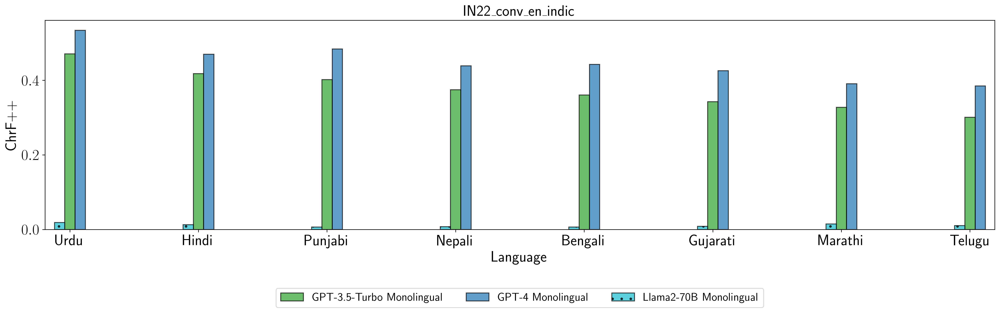

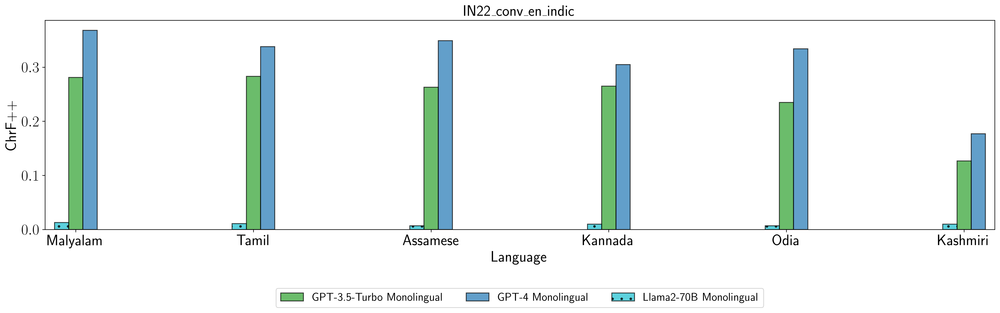

IN22_conv_indic_en


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


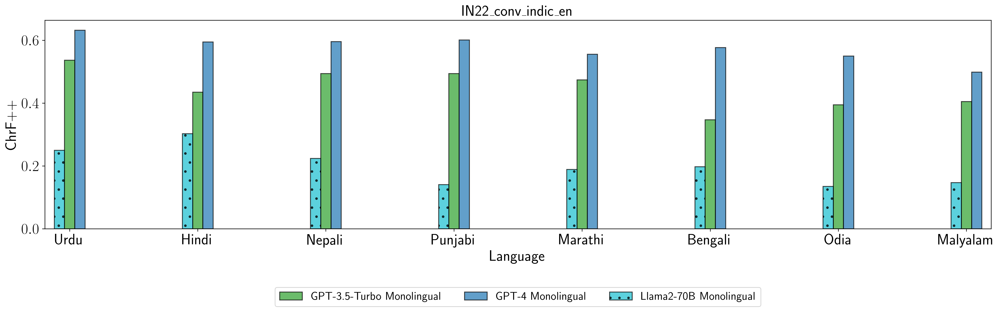

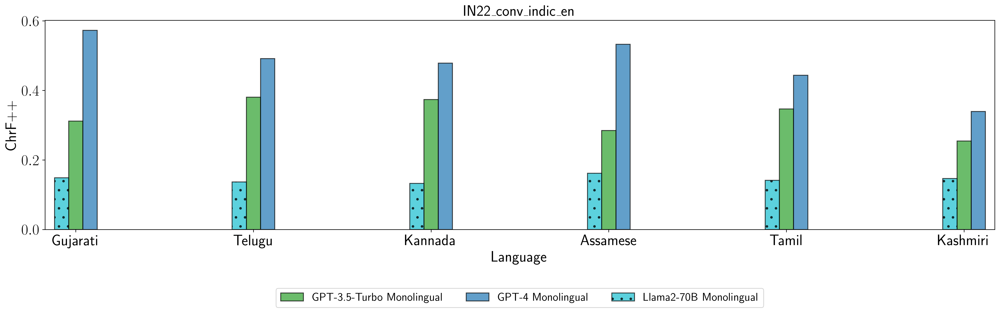

IN22_gen_indic_en


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


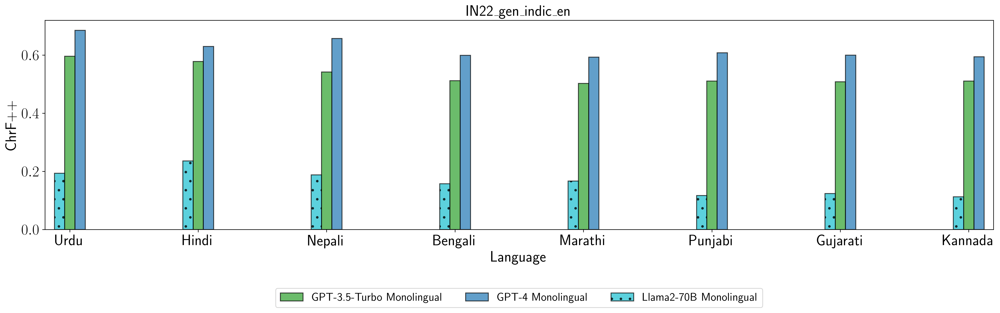

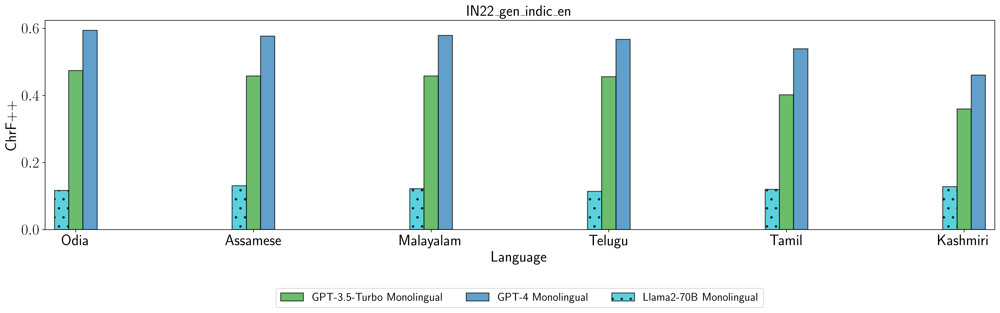

IN22_gen_en_indic


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


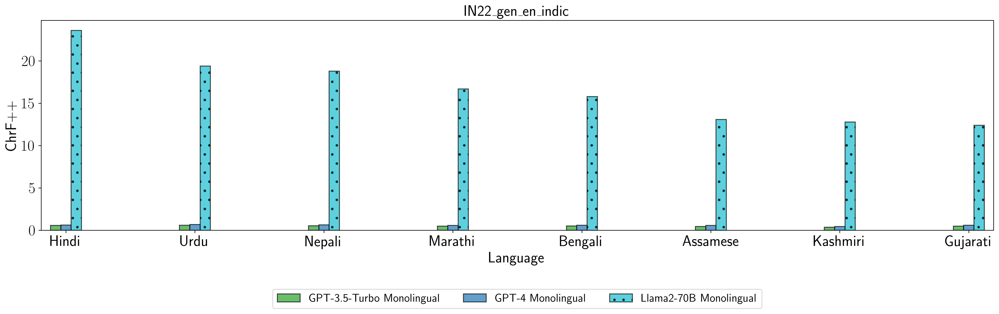

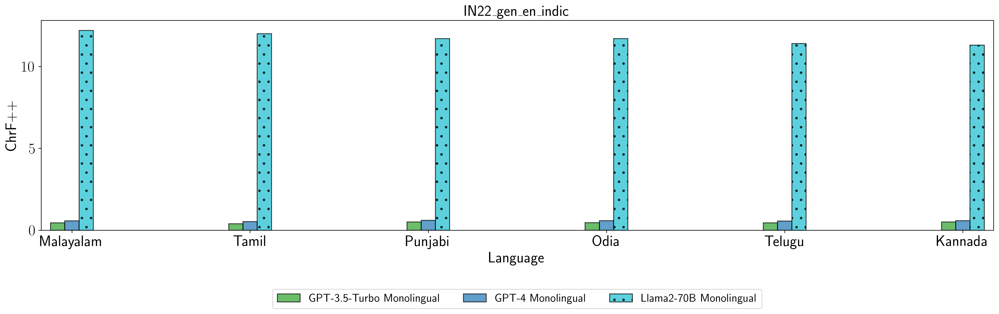

IndicQA


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
/tmp/ipykernel_3543547/1693858342.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["Average"] = task_df[[model for model in models if model in task_df.columns]].transpose().mean()


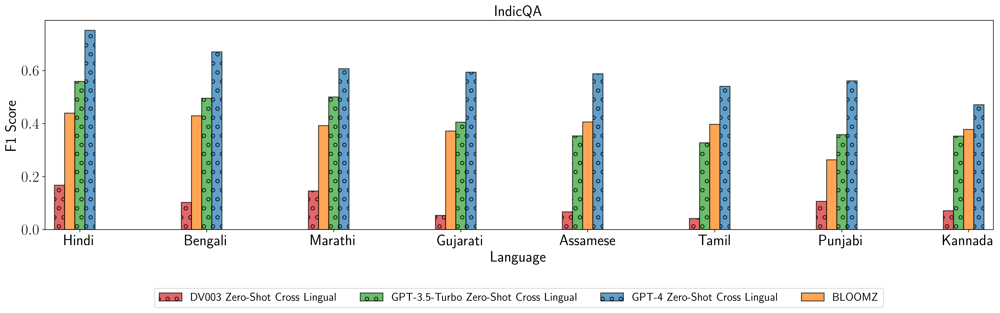

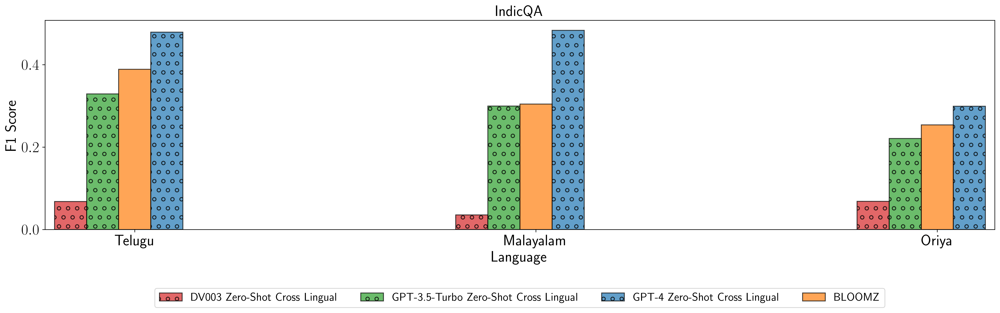

IndicXNLI


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


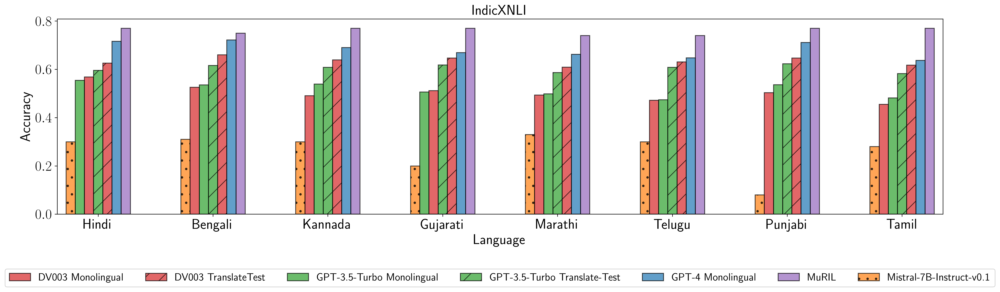

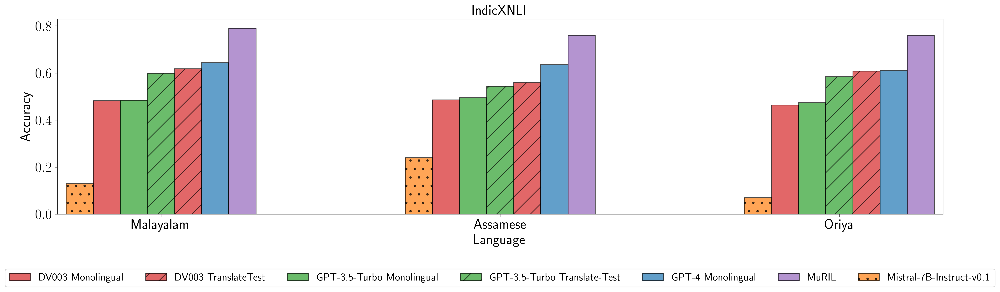

Jigsaw


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


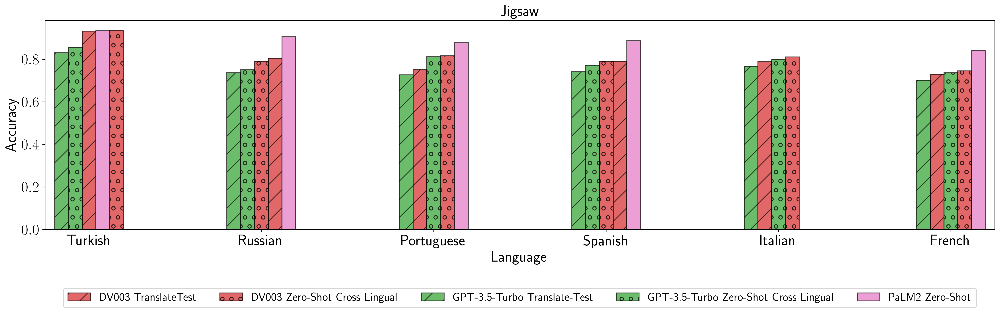

/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


MARVL


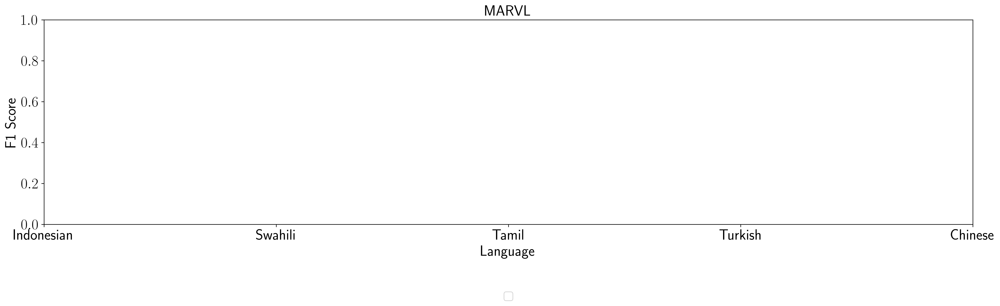

MLQA


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


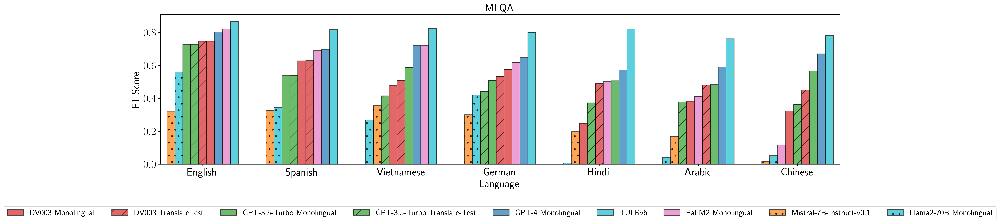

PAN-X


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


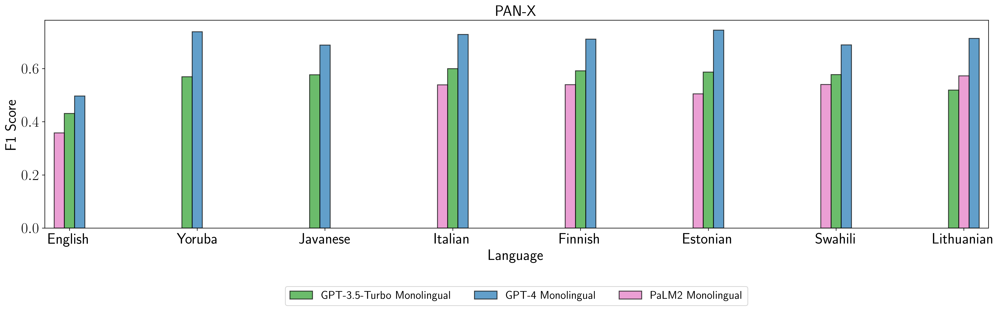

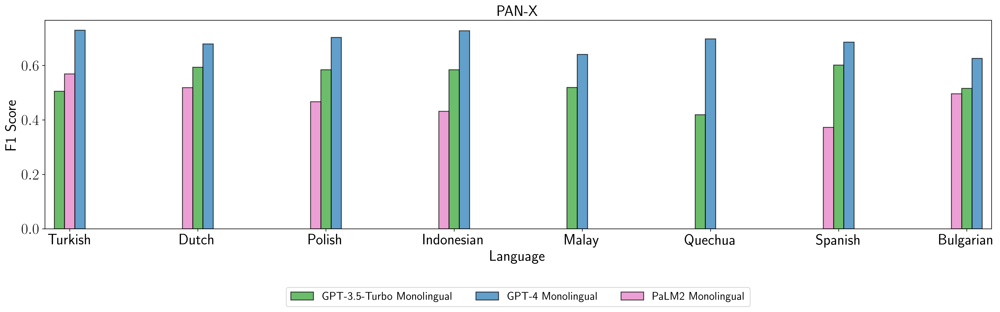

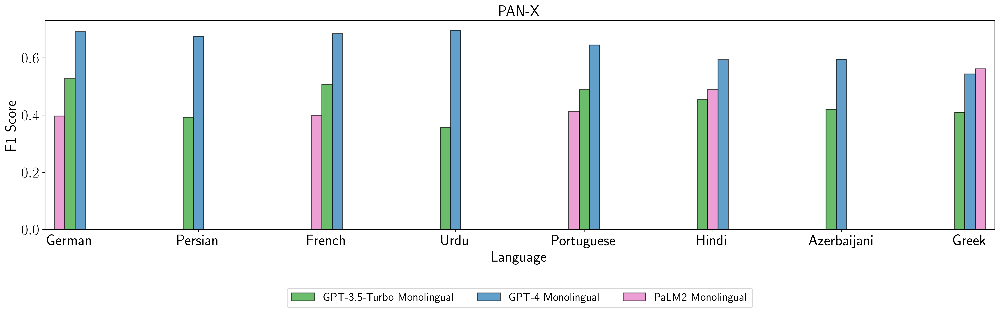

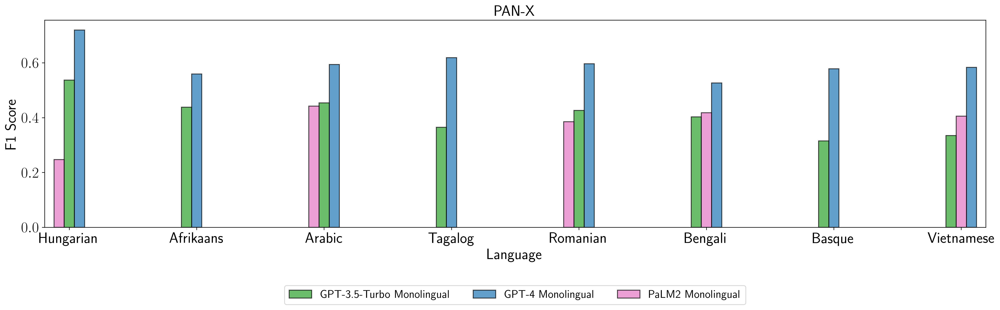

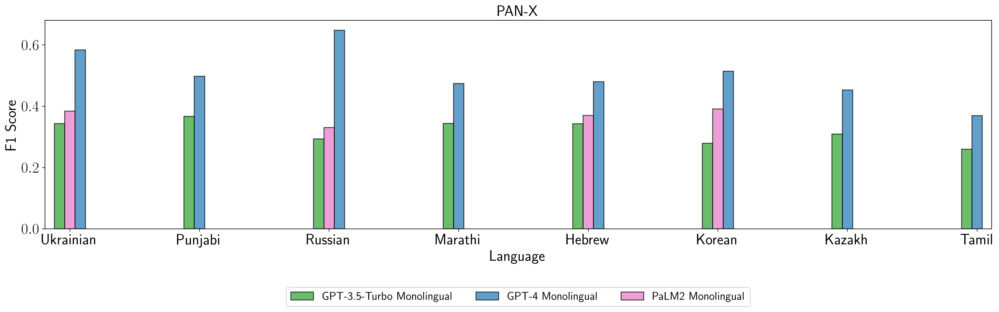

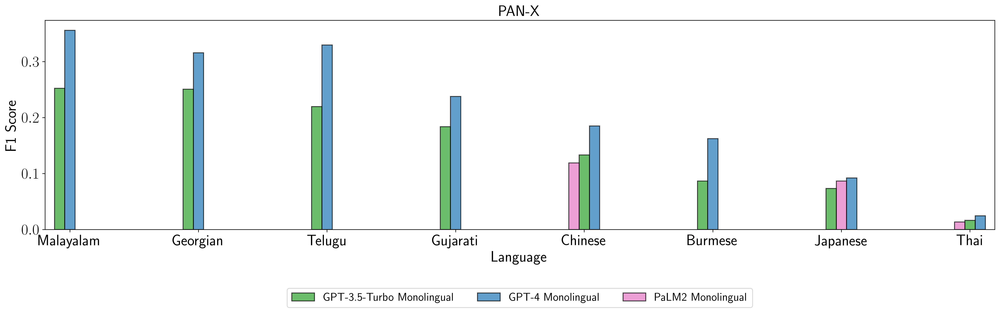

PAWS-X


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


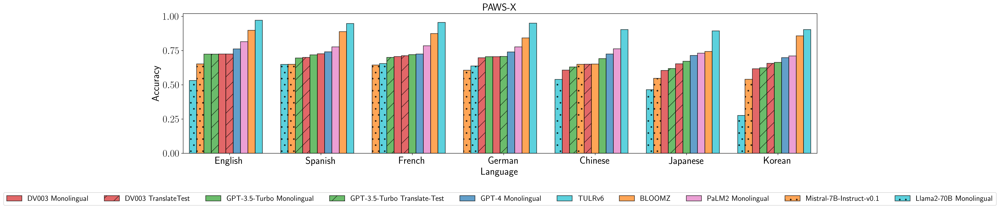

TyDiQA-GoldP


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


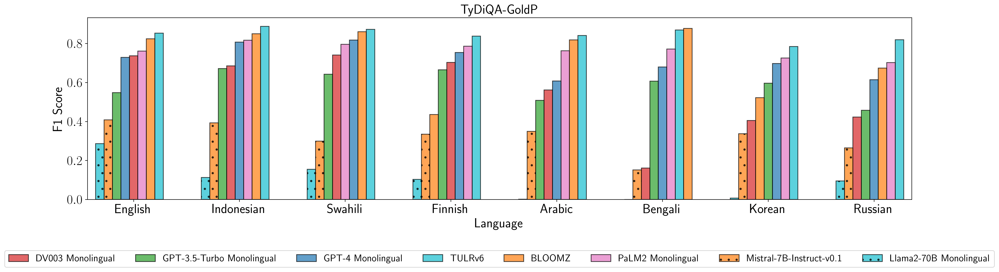

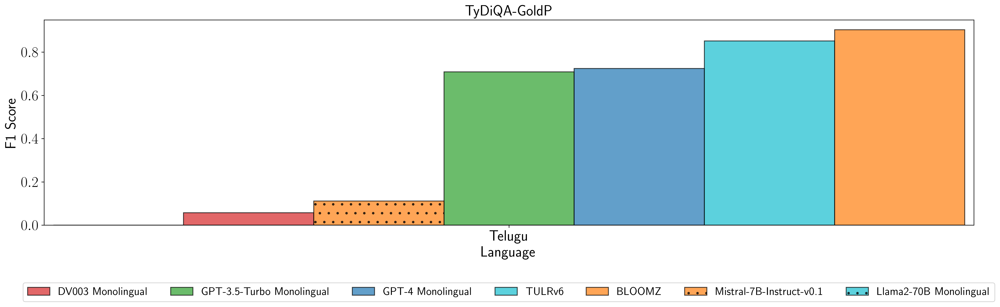

UDPOS


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


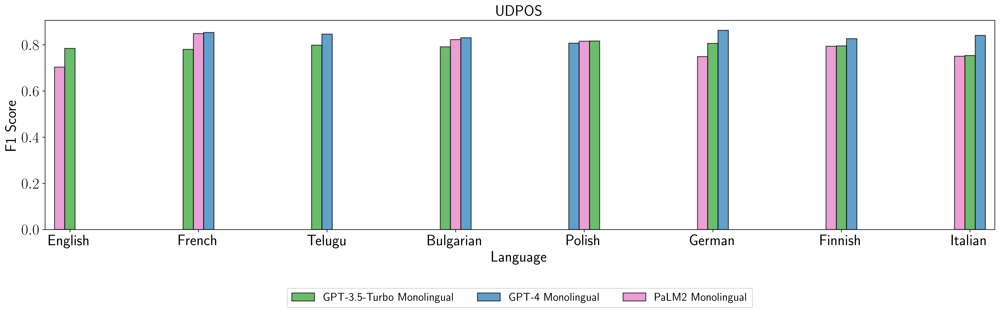

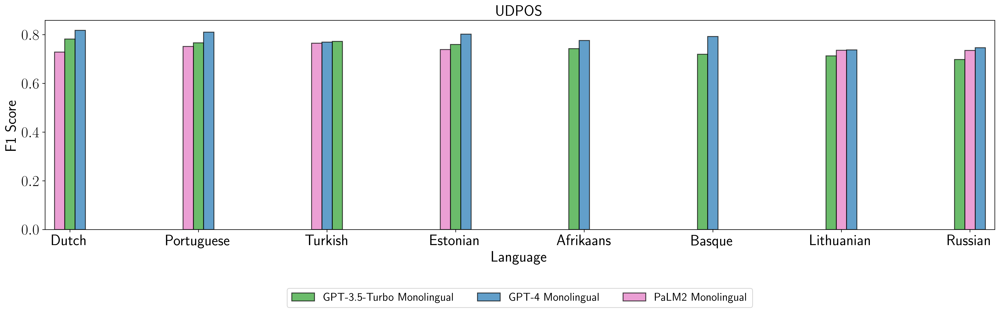

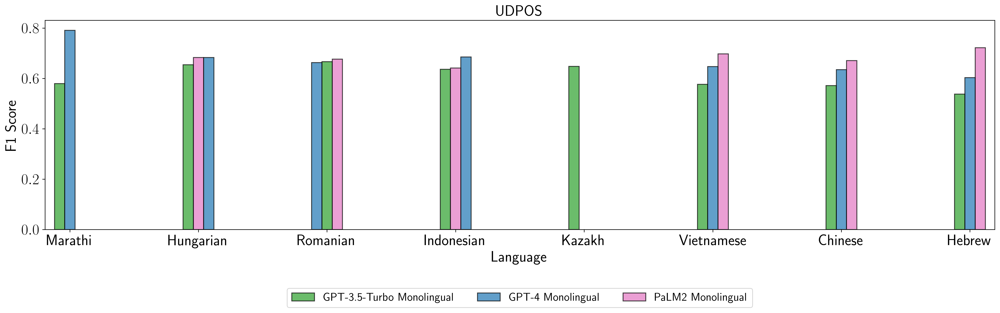

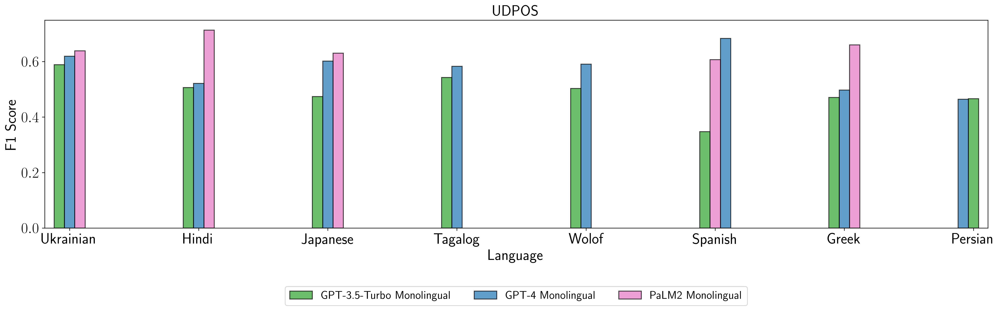

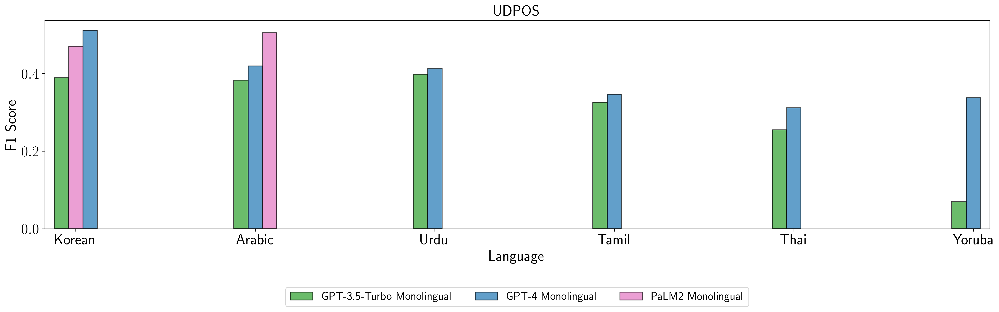

WinoMT


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


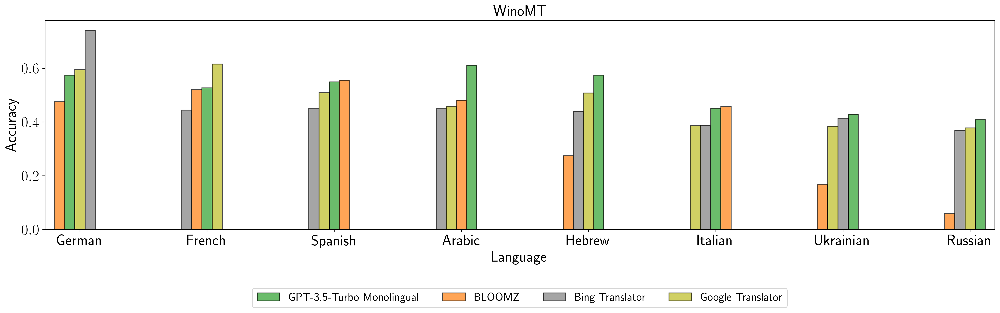

XCOPA


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


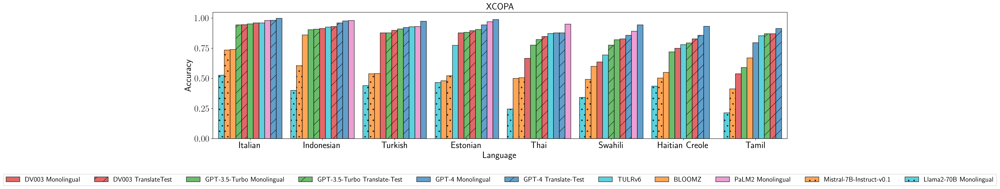

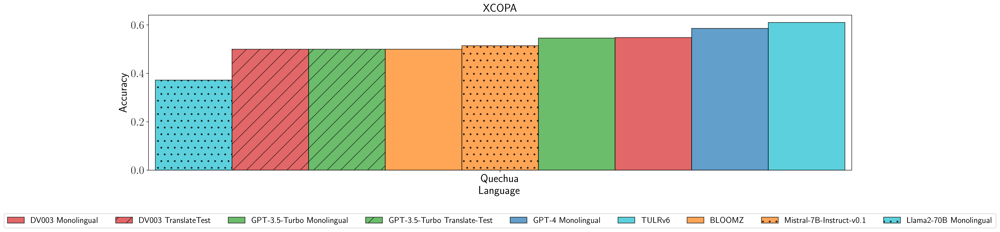

XLSum


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


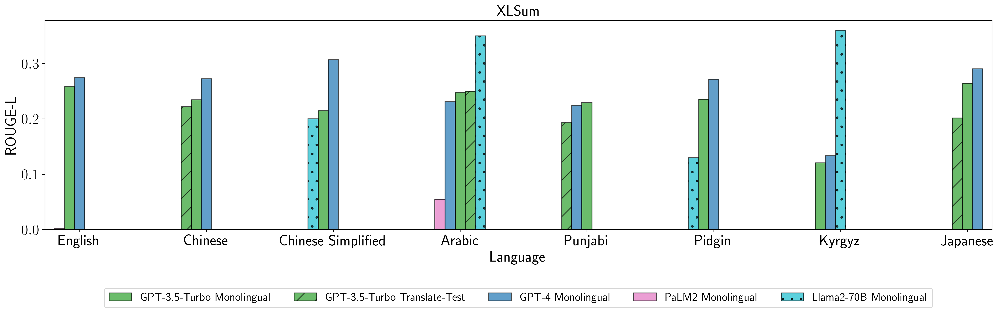

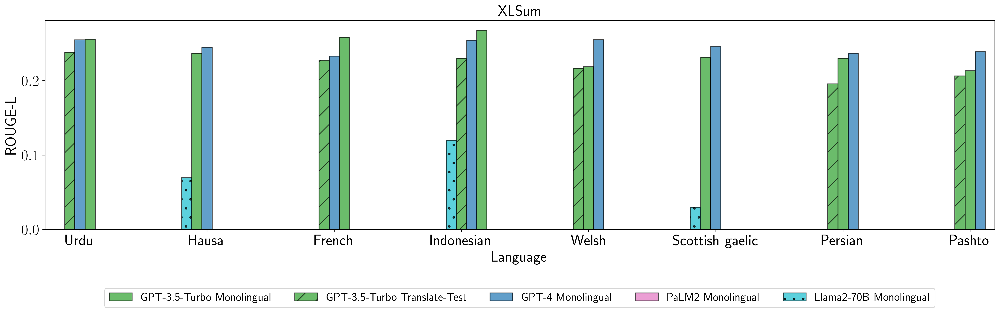

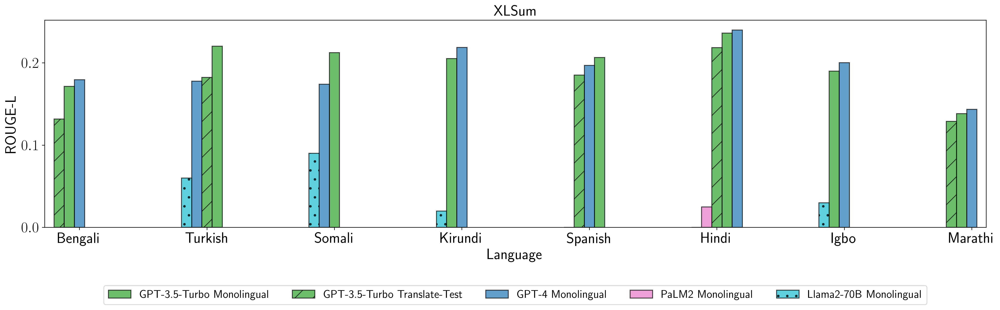

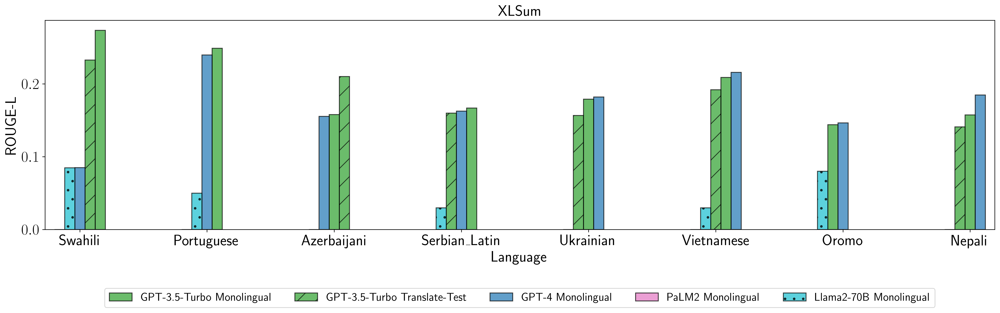

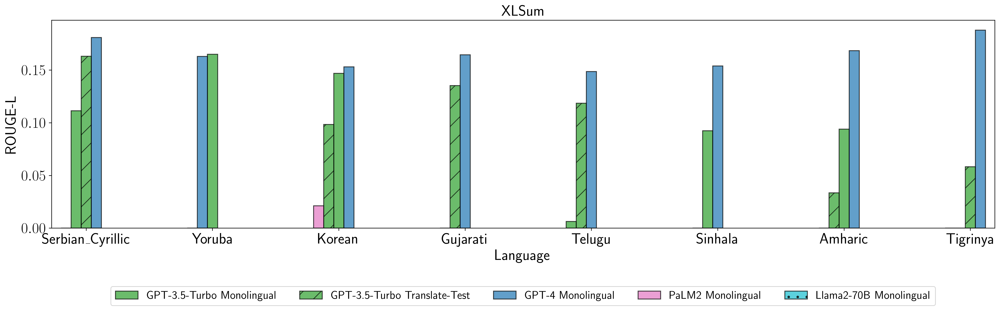

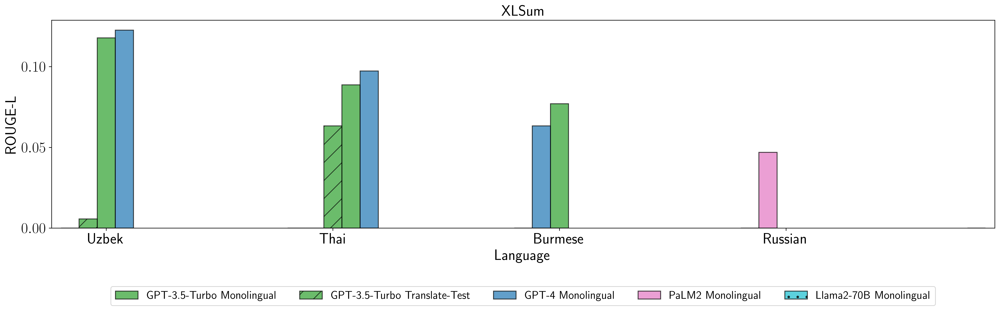

/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


XM3600


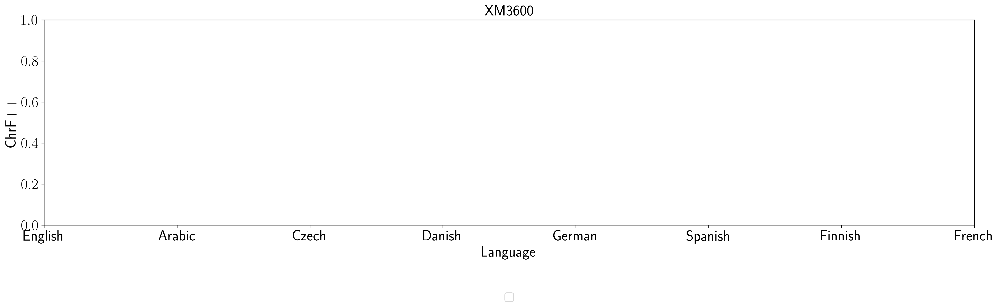

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


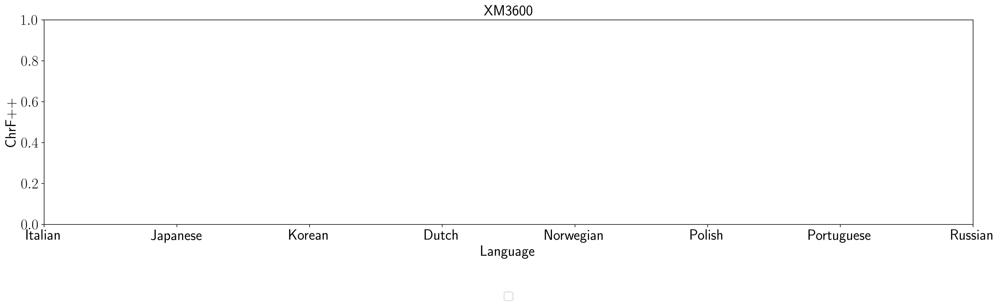

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


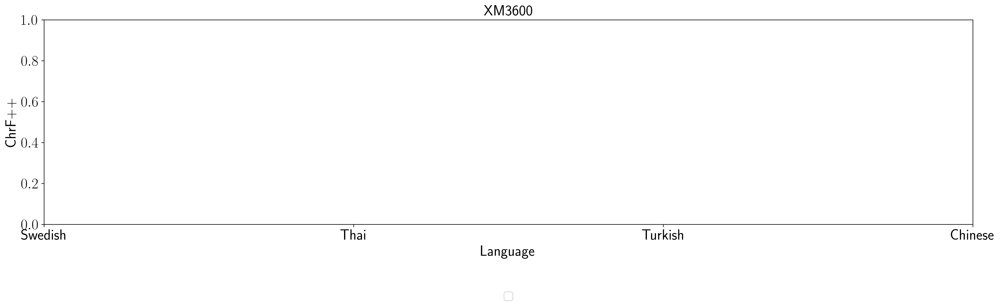

XNLI


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


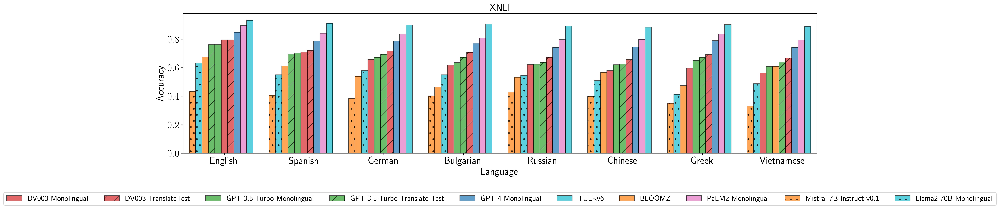

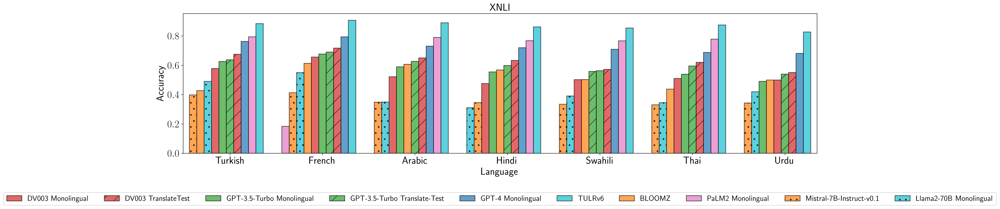

XQuAD


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


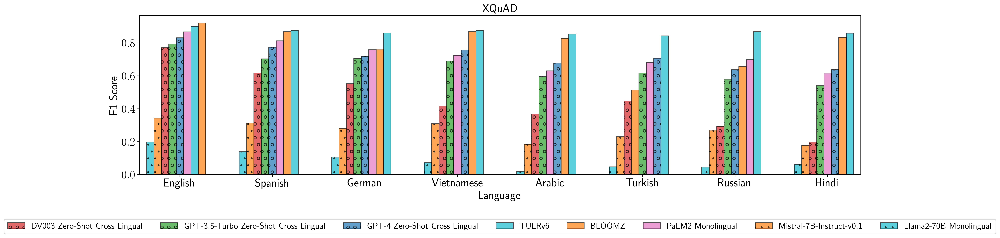

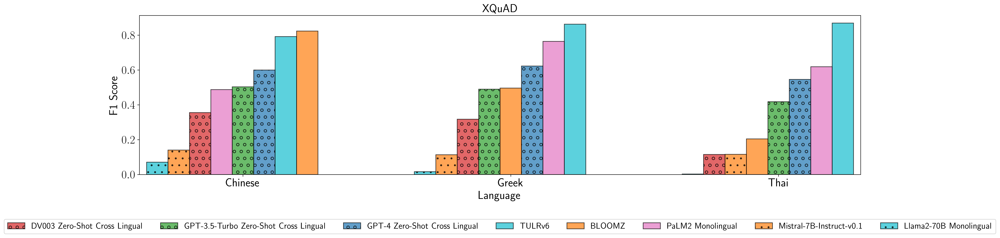

X-RiSAWOZ


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


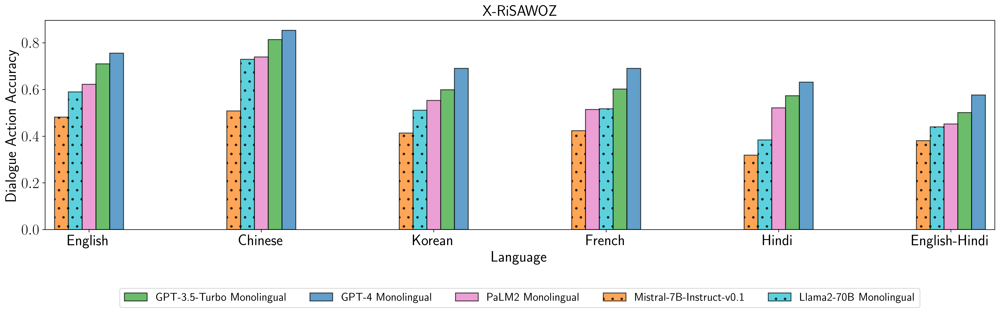

XstoryCloze


/tmp/ipykernel_3543547/1693858342.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


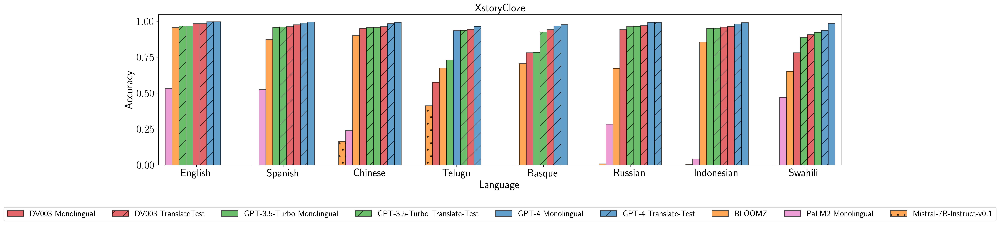

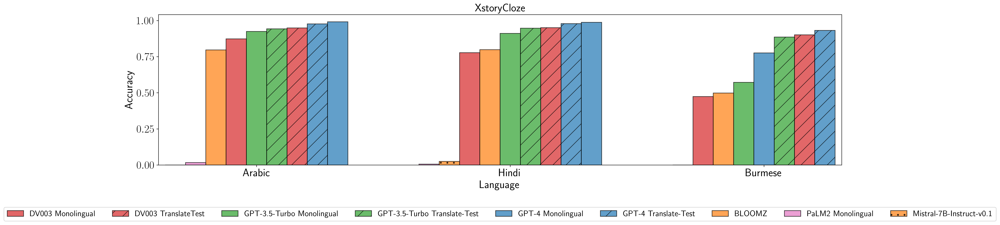

In [52]:
n = 8


for task in df["Dataset"].unique().tolist():
    
    print(task)
    
    task_df = df[df["Dataset"] == task]
    task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
#     task_df = task_df.sort_values(["en_pref", "Language"])
    
    # display(task_df)
    # print(task_df.columns)
    
    models = models_all
    
    # print(models)
    
    # task_df = task_df.drop("GPT-3.5-Turbo Translate-Test", axis=1)
    
    if task == "Jigsaw":
        task_df = task_df.drop("DV003 Monolingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Monolingual", axis = 1)
        models = [model for model in models if "Monolingual" not in model]

    if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
        task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
        models = [model for model in models if "Cross Lingual" not in model]
        
    if task == "XQuAD":
        task_df = task_df[task_df["Language Code"] != "ro"]
    if task == "XCOPA":
        task_df = task_df[task_df["Language Code"] != "en"]
        
    models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    
    task_df["Average"] = task_df[[model for model in models if model in task_df.columns]].transpose().mean()
    task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])
    
    categories = task_df['Language'].tolist()
    
    
    for k in range(0, len(categories), n):
        
        langs = categories[k:k+n]
        
        sub_df = task_df[task_df["Language"].isin(langs)]
        
        group_names = [model for model in models if not sub_df[model].isna().all()]
        bar_width = 0.08
            
        # if task == "XCOPA":
        #     bar_width = 0.1
        # x = np.arange(len(categories))
        
        x = np.arange(len(langs))

        hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

        alpha = 0.7
        fig, ax = plt.subplots(figsize=(22.5, 5))
        
        font_size = 20
        legend_font_size = 15
        margin = 0.01
        
        
        if task in["GLUECoS-NLI", "GLUECoS-SA"]:
            bar_width = 0.05
            fig, ax = plt.subplots(figsize=(8, 3))
            # fig, ax = plt.subplots(figsize=(15, 5))
            font_size = 10
            legend_font_size = 5
            margin = 0.1
            change_width(ax, bar_width)
        
        task_df_melted = sub_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
        lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()

        
        
        for i, group_name in enumerate(group_names):
            offset = (i - len(group_names) // 2) * bar_width
            offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in langs]
            offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
            # display(task_df.columns)
            l = ax.bar(x + offsets, sub_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
                edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

        ax.set_xticks(x)
        ax.set_xticklabels(langs)
        ax.set_xlabel('Language', fontsize=font_size)
        ax.set_ylabel(sub_df["Metrics"].unique()[0], fontsize=font_size)
        ax.set_title(task, fontsize=font_size)
        ax.legend(loc = "lower center", fontsize = legend_font_size, ncols = len(models), bbox_to_anchor=(0.5,-0.4))
        plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums_{k}.pdf", bbox_inches = "tight", dpi = 300)
        plt.xticks(fontsize=font_size)
        plt.yticks(fontsize=font_size)
        plt.margins(x=margin, tight=True)
        plt.show()

In [53]:
df

,Dataset,Task,Language,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,...,Bing Translator,Google Translator,Systran,Metrics,Direction,Metrics_y,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,Finetuned mBART/M2M100
0,AfriQA,Question Answering,Bemba,NaN,bem,0.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,0.019032,NaN,NaN,NaN
1,AfriQA,Question Answering,Fon,NaN,fon,0.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,0.056181,NaN,NaN,NaN
2,AfriQA,Question Answering,Hausa,NaN,ha,2.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,0.004167,NaN,NaN,NaN
3,AfriQA,Question Answering,Igbo,NaN,ig,1.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,0.000611,NaN,NaN,NaN
4,AfriQA,Question Answering,Kinyarwanda,NaN,rw,0.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,0.018608,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
355,XstoryCloze,Commonsense Reasoning,Burmese,NaN,my,1.0,Brahmic,0.473858,0.901390,0.580410,...,NaN,NaN,NaN,Accuracy,HigherBetter,Accuracy,0.000662,NaN,NaN,NaN
356,XstoryCloze,Commonsense Reasoning,Russian,2.0,ru,4.0,Cyrillic,0.941760,0.968895,0.949702,...,NaN,NaN,NaN,Accuracy,HigherBetter,Accuracy,0.008604,NaN,NaN,NaN
357,XstoryCloze,Commonsense Reasoning,Swahili,NaN,sw,2.0,Latin,0.780940,0.906684,0.775645,...,NaN,NaN,NaN,Accuracy,HigherBetter,Accuracy,0.000000,NaN,NaN,NaN
358,XstoryCloze,Commonsense Reasoning,Telugu,NaN,te,1.0,Brahmic,0.576439,0.943084,0.630046,...,NaN,NaN,NaN,Accuracy,HigherBetter,Accuracy,0.411950,NaN,NaN,NaN


/tmp/ipykernel_2918820/793271075.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
/tmp/ipykernel_2918820/793271075.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


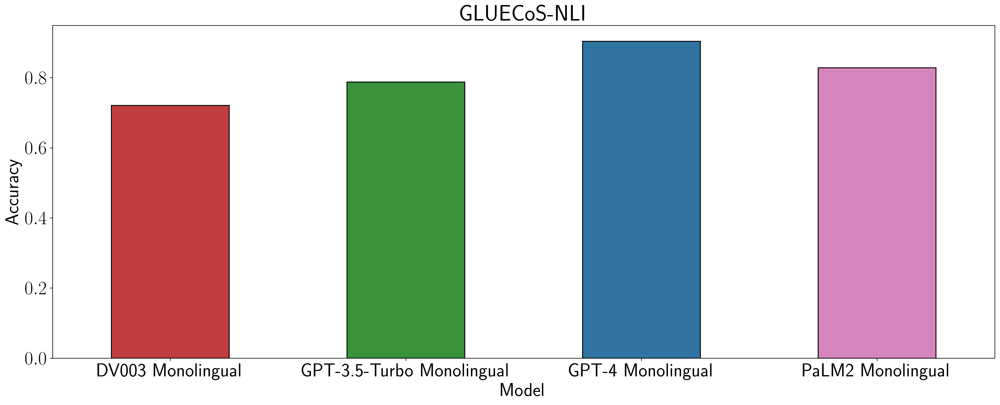

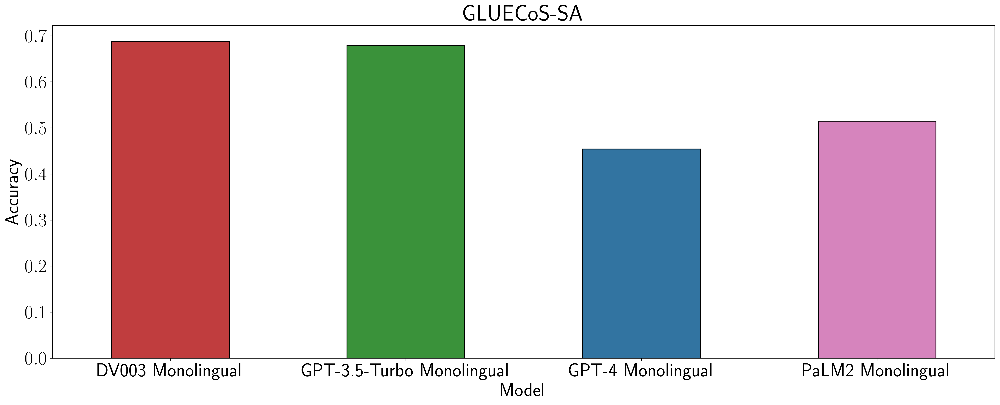

In [78]:
n = 7


for task in df["Dataset"].unique().tolist():
    
    if task not in ['GLUECoS-NLI', "GLUECoS-SA"]:
        continue
    
    # print(task)
    
    task_df = df[df["Dataset"] == task]
    task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
#     task_df = task_df.sort_values(["en_pref", "Language"])
    
    # display(task_df)
    # print(task_df.columns)
    
    models = models_all
    
    # print(task_df)
    
    # print(models)
    
    # task_df = task_df.drop("GPT-3.5-Turbo Translate-Test", axis=1)
    
    if task == "Jigsaw":
        task_df = task_df.drop("DV003 Monolingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Monolingual", axis = 1)
        models = [model for model in models if "Monolingual" not in model]

    if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
        task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
        models = [model for model in models if "Cross Lingual" not in model]
        
    if task == "XQuAD":
        task_df = task_df[task_df["Language Code"] != "ro"]
    if task == "XCOPA":
        task_df = task_df[task_df["Language Code"] != "en"]
        
    models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    
    task_df["Average"] = task_df[[model for model in models if model in task_df.columns]].transpose().mean()
    task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])
    
    
    task_df = task_df.dropna(axis=1, how='all')
    categories = [model for model in models if model in task_df.columns]


    # print(models)
    # print(task_df.columns)
    
    group_names = [model for model in categories if not task_df[model].isna().all()]
    bar_width = 0.08
        
    # if task == "XCOPA":
    #     bar_width = 0.1
    # x = np.arange(len(categories))
    
    x = np.arange(len(categories))

    hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    alpha = 0.7
    fig, ax = plt.subplots(figsize=(22.5, 8))
    
    font_size = 20
    legend_font_size = 15
    margin = 0.01
    
    
    # if task in["GLUECoS-NLI", "GLUECoS-SA"]:
    #     bar_width = 0.05
    #     fig, ax = plt.subplots(figsize=(8, 3))
    #     # fig, ax = plt.subplots(figsize=(15, 5))
    #     font_size = 10
    #     legend_font_size = 5
    #     margin = 0.1
    #     change_width(ax, bar_width)
    
    task_df_melted = task_df.melt(id_vars="Language", value_vars = categories, var_name="Model", value_name="Score")
    
    # display(task_df_melted)
    
    lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()

    # display(lang2modelorder)
    
    
    # for i, group_name in enumerate(group_names):
    # offset = (i - len(group_names) // 2) * bar_width
    # offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in lang2modelorder.keys()]
    # offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    # display(task_df.columns)
    # l = ax.bar(x, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
    #     edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

    # ax.set_xticks(x)
    # ax.set_xticklabels(categories)
    # ax.set_xlabel('Model', fontsize=font_size)
    # ax.set_ylabel(sub_df["Metrics"].unique()[0], fontsize=font_size)
    # ax.set_title(task, fontsize=font_size)
    # # ax.legend(loc = "lower center", fontsize = legend_font_size, ncols = len(categories), bbox_to_anchor=(0.5,-0.3))
    # plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums_{k}.pdf", bbox_inches = "tight", dpi = 300)
    # plt.xticks(fontsize=font_size)
    # plt.yticks(fontsize=font_size)
    # plt.margins(x=margin, tight=True)
    # plt.show()
    
        
    import seaborn as sns
# import seaborn as sns

#     # sns.barplot(x="Model", y="Score", data=task_df_melted, hue="Model", dodge=False, palette=model2color, edgecolor="black", linewidth=1.2)
#     # sns.set(xlabel='Model', ylabel='Score', title='Task Wise Results')


#     sns.barplot(x="Model", y="Score", data=task_df_melted, hue="Model", dodge=False, palette=model2color, edgecolor="black", linewidth=1.2).set(xlabel='Model', ylabel='Accuracy', title=task)
    # sns.set(xlabel='Model', ylabel='Accuracy', title=task)
    
    # import matplotlib.pyplot as plt

    # Set the plot size
    # plt.figure(figsize=(10, 5))

    # Create the seaborn bar plot
    sns.barplot(x="Model", y="Score", data=task_df_melted, hue="Model", dodge=False, palette=model2color, edgecolor="black", linewidth=1.2, width=0.5).set(xlabel='Model', ylabel='Accuracy', title=task)


    
    plt.savefig(f'{task}.pdf')
    # Show the plot
    # plt.show()


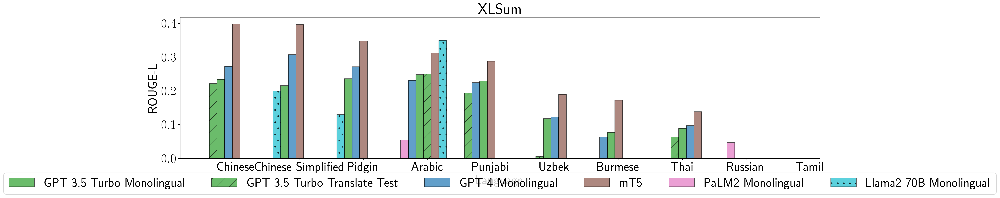

In [55]:
xlsum_df = df[df["Dataset"]=="XLSum"]
xlsum_df = xlsum_df[(xlsum_df["Language Code"] != "gu") & (xlsum_df["Language Code"] != "ti")]
models = models_all
xlsum_df["Average"] = xlsum_df[models].transpose().mean()
xlsum_df = xlsum_df.sort_values(by = ["Average"], ascending= False)
xlsum_df_small = pd.concat([xlsum_df.head(5), xlsum_df.tail(5)])
task_df = xlsum_df_small
task = "XLSum"
task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
task_df = task_df.sort_values(["en_pref", "Language"])

models = models_all
if task == "Jigsaw":
    task_df = task_df.drop("DV003 Monolingual", axis = 1)
    task_df = task_df.drop("GPT-3.5-Turbo Monolingual", axis = 1)
    models = [model for model in models if "Monolingual" not in model]

if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
    task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
    task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
    models = [model for model in models if "Cross Lingual" not in model]

if task == "XQuAD":
    task_df = task_df[task_df["Language Code"] != "ro"]
if task == "XCOPA":
    task_df = task_df[task_df["Language Code"] != "en"]
    

    
task_df["Average"] = task_df[models].transpose().mean()
task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])

categories = task_df['Language'].tolist()
group_names = [model for model in models if not task_df[model].isna().all()]
bar_width = 0.12
if task == "XCOPA":
    bar_width = 0.1
x = np.arange(len(categories))

hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(22.5, 5))

task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
    offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
    offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))


# models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

# categories = task_df['Language'].tolist()
# group_names = [model for model in models if not task_df[model].isna().all()]
# bar_width = 0.12
# if task == "XCOPA":
#     bar_width = 0.1
# x = np.arange(len(categories))

# hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

# alpha = 0.7
# fig, ax = plt.subplots(figsize=(22.5, 5))

# for i, group_name in enumerate(group_names):
#     offset = (i - len(group_names) // 2) * bar_width
#     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
#           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel('Language')
ax.set_ylabel(task_df["Metrics"].unique()[0])
ax.set_title(task)
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums.pdf", bbox_inches = "tight", dpi = 300)
plt.show()

In [56]:
task_df.columns

Index(['Dataset', 'Task', 'Language', 'Language Tier', 'Language Code',
       'Language Class', 'Language Script', 'DV003 Monolingual',
       'DV003 TranslateTest', 'IndicTrans2', 'GPT-3.5-Turbo Monolingual',
       'GPT-3.5-Turbo Translate-Test', 'GPT-4 Monolingual',
       'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6',
       'BLOOMZ', 'XLM-R', 'mBERT', 'MuRIL', 'XGLM', 'mT5', 'PaLM2 Zero-Shot',
       'PaLM2 Monolingual', 'Llama2-7B Monolingual', 'Llama2-13B Monolingual',
       'Llama2-70B Monolingual', 'LLaVa-1.5-13B Monolingual',
       'LLaVa-1.5-13B Translate-Test', 'Bing Translator', 'Google Translator',
       'Systran', 'Metrics', 'Direction', 'Metrics_y',
       'Mistral-7B-Instruct-v0.1', 'GPT4-V Monolingual',
       'GPT4-V Translate-Test', 'Finetuned mBART/M2M100', 'Average',
       'en_pref'],
      dtype='object')

In [57]:
list(range(0, len(langs), 10))

[0]

['DV003 Monolingual', 'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual', 'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6', 'BLOOMZ', 'MuRIL', 'mT5', 'mBERT', 'XLM-R', 'PaLM2 Monolingual', 'PaLM2 Zero-Shot', 'Bing Translator', 'Google Translator', 'Mistral-7B-Instruct-v0.1', 'Llama2-70B Monolingual']


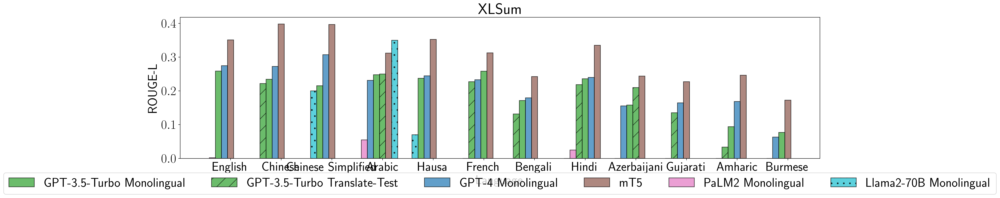

['DV003 Monolingual', 'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual', 'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6', 'BLOOMZ', 'MuRIL', 'mT5', 'mBERT', 'XLM-R', 'PaLM2 Monolingual', 'PaLM2 Zero-Shot', 'Bing Translator', 'Google Translator', 'Mistral-7B-Instruct-v0.1', 'Llama2-70B Monolingual']


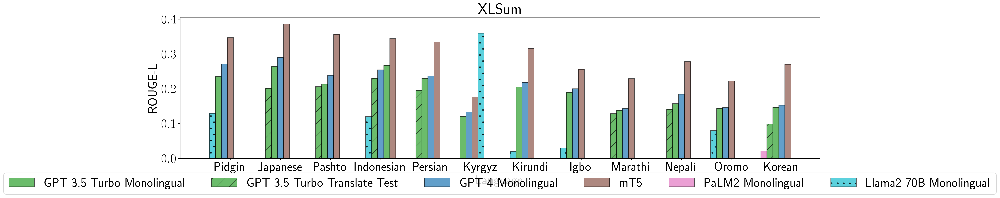

['DV003 Monolingual', 'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual', 'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6', 'BLOOMZ', 'MuRIL', 'mT5', 'mBERT', 'XLM-R', 'PaLM2 Monolingual', 'PaLM2 Zero-Shot', 'Bing Translator', 'Google Translator', 'Mistral-7B-Instruct-v0.1', 'Llama2-70B Monolingual']


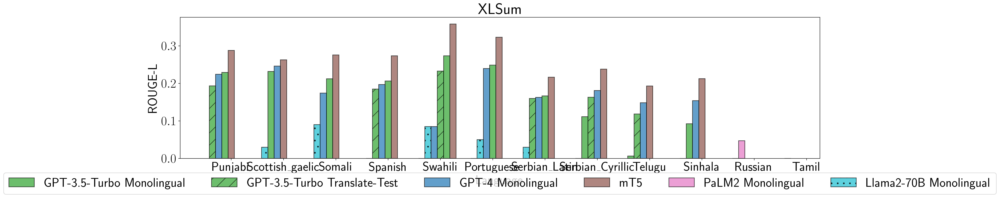

['DV003 Monolingual', 'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual', 'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6', 'BLOOMZ', 'MuRIL', 'mT5', 'mBERT', 'XLM-R', 'PaLM2 Monolingual', 'PaLM2 Zero-Shot', 'Bing Translator', 'Google Translator', 'Mistral-7B-Instruct-v0.1', 'Llama2-70B Monolingual']


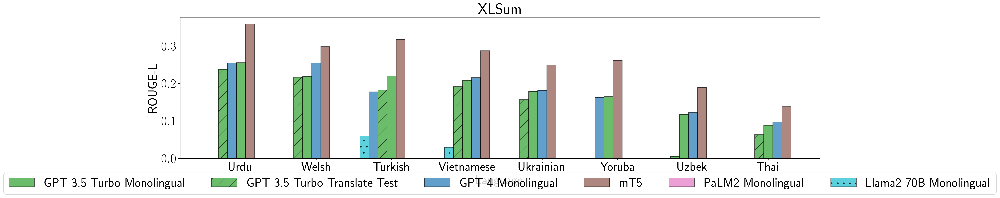

In [58]:
xlsum_df = df[df["Dataset"]=="XLSum"]
xlsum_df = xlsum_df[(xlsum_df["Language Code"] != "ti")]
models = models_all
task = "XLSum"
xlsum_df["en_pref"] = xlsum_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
xlsum_df = xlsum_df.sort_values(["en_pref", "Language"])

langs = xlsum_df["Language"].unique().tolist()
n = 12
for l_id in range(0, len(langs), n):
    langs_subset = langs[l_id: l_id+n]
    task_df = xlsum_df[xlsum_df["Language"].isin(langs_subset)]
    models = models_all
    
    print(models)
    
    if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
        task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
        models = [model for model in models if "Cross Lingual" not in model]


    task_df["Average"] = task_df[models].transpose().mean()
    task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])

    categories = task_df['Language'].tolist()
    group_names = [model for model in models if not task_df[model].isna().all()]
    bar_width = 0.12
    if task == "XCOPA":
        bar_width = 0.1
    x = np.arange(len(categories))

    hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    alpha = 0.7
    fig, ax = plt.subplots(figsize=(22.5, 5))

    task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
    lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


    for i, group_name in enumerate(group_names):
        offset = (i - len(group_names) // 2) * bar_width
        offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
        offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
        l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
              edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))


    # models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    #     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    #     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    # categories = task_df['Language'].tolist()
    # group_names = [model for model in models if not task_df[model].isna().all()]
    # bar_width = 0.12
    # if task == "XCOPA":
    #     bar_width = 0.1
    # x = np.arange(len(categories))

    # hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    # alpha = 0.7
    # fig, ax = plt.subplots(figsize=(22.5, 5))

    # for i, group_name in enumerate(group_names):
    #     offset = (i - len(group_names) // 2) * bar_width
    #     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
    #           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

    ax.set_xticks(x)
    ax.set_xticklabels(categories)
    ax.set_xlabel('Language')
    ax.set_ylabel(task_df["Metrics"].unique()[0])
    ax.set_title(task)
    ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
    plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums_{l_id}.pdf", bbox_inches = "tight", dpi = 300)
    plt.show()

/tmp/ipykernel_2918820/436275714.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  panx_df["Average"] = panx_df[models].transpose().mean()


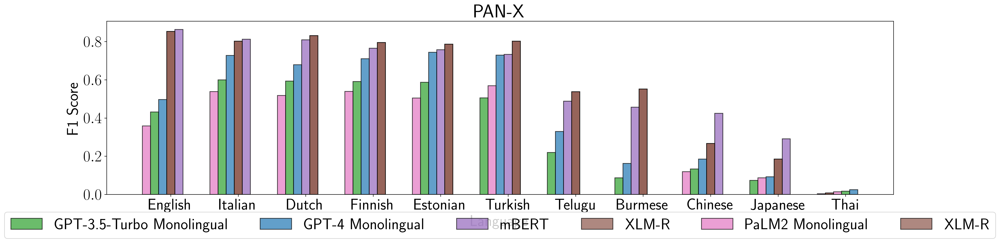

In [59]:
panx_df = df[df["Dataset"]=="PAN-X"]
models = [model for model in models_all if model != "mT5"] + ["XLM-R"]
panx_df["Average"] = panx_df[models].transpose().mean()
panx_df = panx_df.sort_values(by="Average")
panx_df_small = pd.concat([panx_df[panx_df["Language Code"] == "en"], panx_df.head(5), panx_df.tail(5)]).reset_index()
task_df = panx_df_small
task = "PAN-X"
task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
task_df = task_df.sort_values(["en_pref", "Language"])

if task == "Jigsaw":
    task_df = task_df.drop("DV003 Monolingual", axis = 1)
    task_df = task_df.drop("GPT-3.5-Turbo Monolingual", axis = 1)
    models = [model for model in models if "Monolingual" not in model]

if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
    task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
    task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
    models = [model for model in models if "Cross Lingual" not in model]

if task == "XQuAD":
    task_df = task_df[task_df["Language Code"] != "ro"]
if task == "XCOPA":
    task_df = task_df[task_df["Language Code"] != "en"]


task_df["Average"] = task_df[models].transpose().mean()
task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])

categories = task_df['Language'].tolist()
group_names = [model for model in models if not task_df[model].isna().all()]
bar_width = 0.12
if task == "XCOPA":
    bar_width = 0.1
x = np.arange(len(categories))

hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(22.5, 5))

task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
    offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
    offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))



# models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

# categories = task_df['Language'].tolist()
# group_names = [model for model in models if not task_df[model].isna().all()]
# bar_width = 0.12
# if task == "XCOPA":
#     bar_width = 0.1
# x = np.arange(len(categories))

# hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

# alpha = 0.7
# fig, ax = plt.subplots(figsize=(22.5, 5))

# for i, group_name in enumerate(group_names):
#     offset = (i - len(group_names) // 2) * bar_width
#     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
#           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel('Language')
ax.set_ylabel(task_df["Metrics"].unique()[0])
ax.set_title(task)
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums.pdf", bbox_inches = "tight", dpi = 300)
plt.show()

In [60]:
models_all

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'MuRIL',
 'mT5',
 'mBERT',
 'XLM-R',
 'PaLM2 Monolingual',
 'PaLM2 Zero-Shot',
 'Bing Translator',
 'Google Translator',
 'Mistral-7B-Instruct-v0.1',
 'Llama2-70B Monolingual']

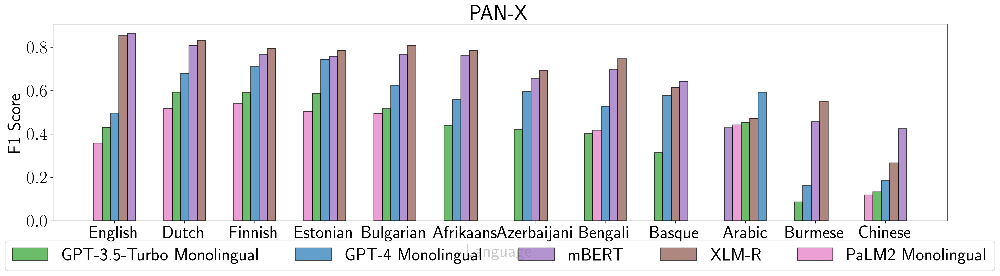

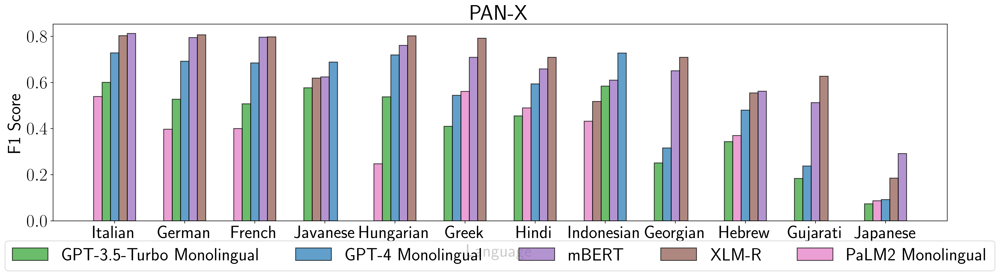

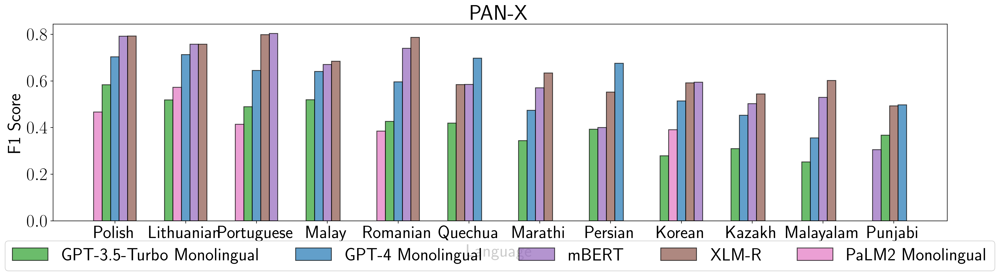

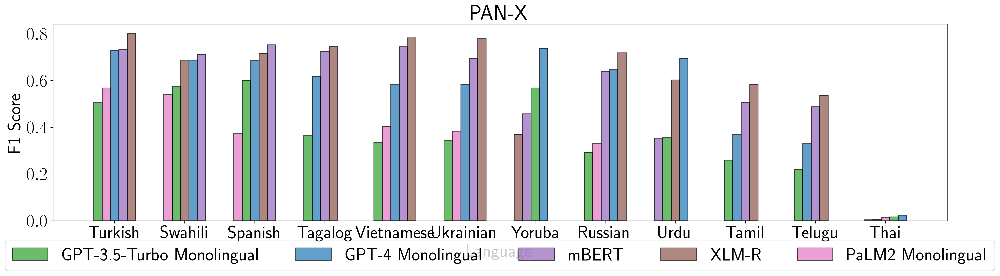

In [61]:
xlsum_df = df[df["Dataset"]=="PAN-X"]
xlsum_df = xlsum_df[(xlsum_df["Language Code"] != "ti")]
models = models_all
task = "PAN-X"
xlsum_df["en_pref"] = xlsum_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
xlsum_df = xlsum_df.sort_values(["en_pref", "Language"])

langs = xlsum_df["Language"].unique().tolist()
n = 12
for l_id in range(0, len(langs), n):
    langs_subset = langs[l_id: l_id+n]
    task_df = xlsum_df[xlsum_df["Language"].isin(langs_subset)]
    models = models_all
    
    if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
        task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
        models = [model for model in models if "Cross Lingual" not in model]


    task_df["Average"] = task_df[models].transpose().mean()
    task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])

    categories = task_df['Language'].tolist()
    group_names = [model for model in models if not task_df[model].isna().all()]
    bar_width = 0.12
    if task == "XCOPA":
        bar_width = 0.1
    x = np.arange(len(categories))

    hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    alpha = 0.7
    fig, ax = plt.subplots(figsize=(22.5, 5))

    task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
    lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


    for i, group_name in enumerate(group_names):
        offset = (i - len(group_names) // 2) * bar_width
        offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
        offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
        l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
              edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))


    # models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    #     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    #     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    # categories = task_df['Language'].tolist()
    # group_names = [model for model in models if not task_df[model].isna().all()]
    # bar_width = 0.12
    # if task == "XCOPA":
    #     bar_width = 0.1
    # x = np.arange(len(categories))

    # hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    # alpha = 0.7
    # fig, ax = plt.subplots(figsize=(22.5, 5))

    # for i, group_name in enumerate(group_names):
    #     offset = (i - len(group_names) // 2) * bar_width
    #     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
    #           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

    ax.set_xticks(x)
    ax.set_xticklabels(categories)
    ax.set_xlabel('Language')
    ax.set_ylabel(task_df["Metrics"].unique()[0])
    ax.set_title(task)
    ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
    plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums_{l_id}.pdf", bbox_inches = "tight", dpi = 300)
    plt.show()

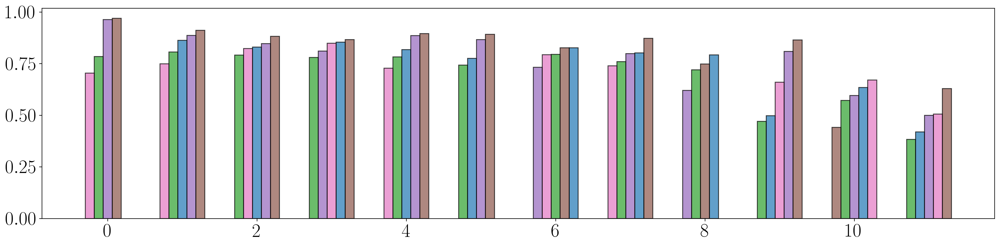

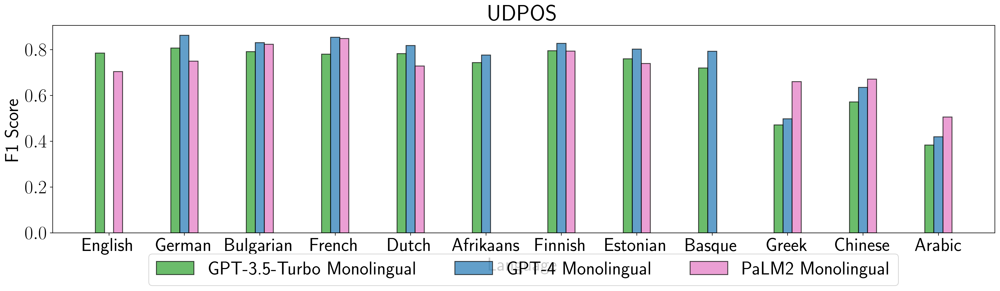

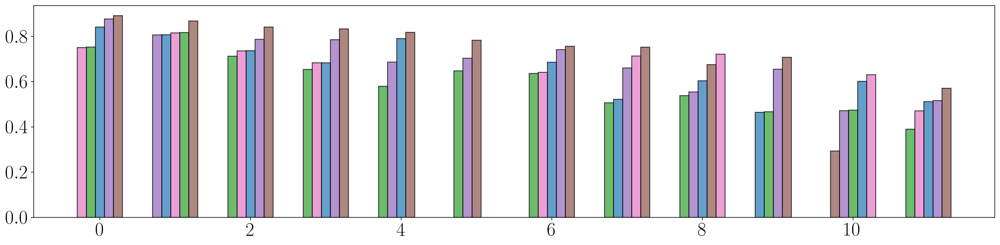

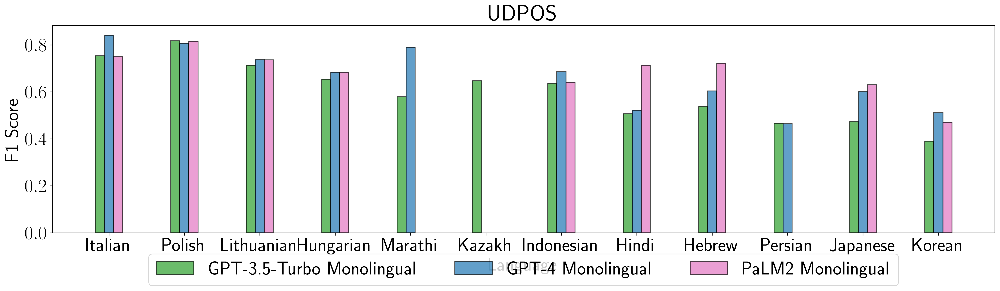

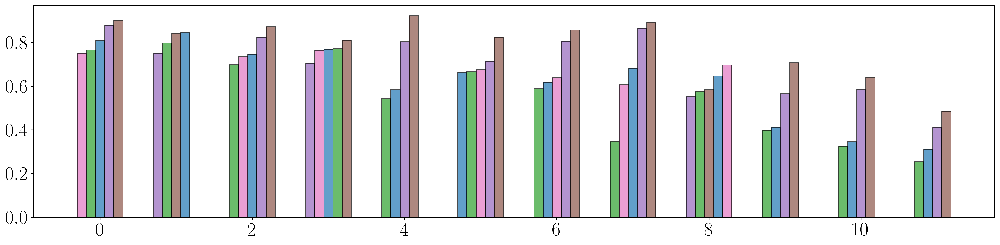

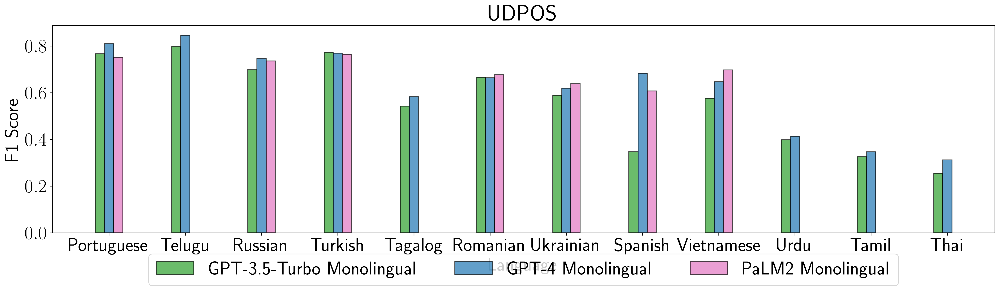

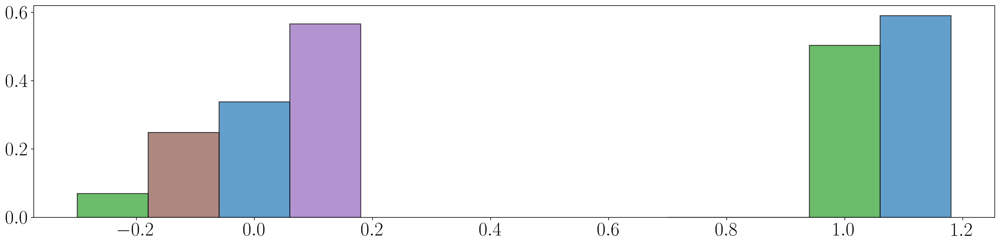

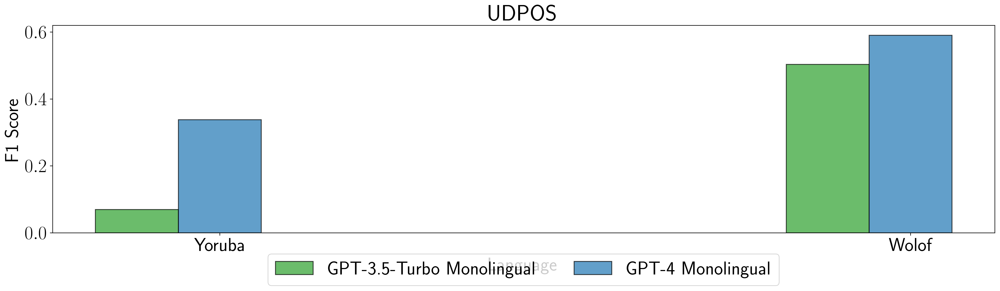

In [62]:
xlsum_df = df[df["Dataset"]=="UDPOS"]
xlsum_df = xlsum_df[(xlsum_df["Language Code"] != "ti")]
models = models_all
task = "UDPOS"
xlsum_df["en_pref"] = xlsum_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
xlsum_df = xlsum_df.sort_values(["en_pref", "Language"])

langs = xlsum_df["Language"].unique().tolist()
n = 12
for l_id in range(0, len(langs), n):
    langs_subset = langs[l_id: l_id+n]
    task_df = xlsum_df[xlsum_df["Language"].isin(langs_subset)]
    models = models_all
    
    if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
        task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
        models = [model for model in models if "Cross Lingual" not in model]


    task_df["Average"] = task_df[models].transpose().mean()
    task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])

    categories = task_df['Language'].tolist()
    group_names = [model for model in models if not task_df[model].isna().all()]
    bar_width = 0.12
    if task == "XCOPA":
        bar_width = 0.1
    x = np.arange(len(categories))

    hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    alpha = 0.7
    fig, ax = plt.subplots(figsize=(22.5, 5))

    task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
    lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


    for i, group_name in enumerate(group_names):
        offset = (i - len(group_names) // 2) * bar_width
        offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
        offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
        l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
              edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))


    models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    categories = task_df['Language'].tolist()
    group_names = [model for model in models if not task_df[model].isna().all()]
    bar_width = 0.12
    if task == "XCOPA":
        bar_width = 0.1
    x = np.arange(len(categories))

    hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    alpha = 0.7
    fig, ax = plt.subplots(figsize=(22.5, 5))

    for i, group_name in enumerate(group_names):
        offset = (i - len(group_names) // 2) * bar_width
        l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
              edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

    ax.set_xticks(x)
    ax.set_xticklabels(categories)
    ax.set_xlabel('Language', fontsize=25)
    ax.set_ylabel(task_df["Metrics"].unique()[0], fontsize=25)
    ax.set_title(task)
    ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
    plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums_{l_id}.pdf", bbox_inches = "tight", dpi = 300)
    plt.show()

In [63]:
model2color = {

    "DV003": unq_colors[9],
    "DV003 Monolingual": unq_colors[9],
    "DV003 TranslateTest": unq_colors[9],
    "DV003 Zero-Shot Cross Lingual": unq_colors[9],
    'GPT-3.5-Turbo': unq_colors[7],
    'GPT-3.5-Turbo Monolingual': unq_colors[7],
    'GPT-3.5-Turbo Translate-Test': unq_colors[7],
    "GPT-3.5-Turbo Zero-Shot Cross Lingual": unq_colors[7],
    'GPT-4': unq_colors[0],
    'GPT-4 Monolingual': unq_colors[0],
    'GPT-4 Translate-Test': unq_colors[0],
    'GPT-4 Zero-Shot Cross Lingual': unq_colors[0],
    "GPT-3.5-Turbo / GPT-4": unq_colors[7],
    "TULRv6": unq_colors[3],
    "BLOOM": unq_colors[4],
    "BLOOMZ": unq_colors[4],
    "MuRIL": unq_colors[5],
    "mT5": unq_colors[6],
    "mBERT": unq_colors[5],
    "PaLM2 Zero-Shot":unq_colors[2],
    "PaLM2 Monolingual":unq_colors[2],
    "Bing Translator": unq_colors[8],
    'Google Translator': unq_colors[1],

}
model2hatches = {
    "DV003 TranslateTest": "/",
    "DV003 Zero-Shot Cross Lingual": "o",
    "GPT-3.5-Turbo Translate-Test": "/",
    "GPT-3.5-Turbo Zero-Shot Cross Lingual": "o"
}

In [64]:
task_wise_avg = df[['Dataset', 'DV003 Monolingual', 'DV003 TranslateTest',
       'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual',
       'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual']].groupby("Dataset").mean().reset_index()

In [65]:
sp_datasets = ["XNLI", "IndicXNLI", "PAWS-X", "XCOPA", "XstoryCloze", "TyDiQA-GoldP"]

task_wise_avg = task_wise_avg[task_wise_avg["Dataset"].isin(["XNLI", "IndicXNLI", "PAWS-X", "XCOPA", "XstoryCloze", "TyDiQA-GoldP"])]

In [66]:
task_wise_avg["DatasetId"] = task_wise_avg["Dataset"].apply(lambda x : sp_datasets.index(x))
task_wise_avg = task_wise_avg.sort_values("DatasetId")

In [67]:
task_wise_avg.columns

Index(['Dataset', 'DV003 Monolingual', 'DV003 TranslateTest',
       'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual',
       'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
       'DatasetId'],
      dtype='object')

In [68]:
task_wise_avg

,Dataset,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,GPT-3.5-Turbo Monolingual,GPT-3.5-Turbo Translate-Test,GPT-3.5-Turbo Zero-Shot Cross Lingual,DatasetId
22,XNLI,0.592748,0.670512,0.600519,0.621437,0.643260,0.625921,0
9,IndicXNLI,0.495827,0.623988,0.448721,0.507295,0.596952,NaN,1
14,PAWS-X,0.670857,0.685571,0.636214,0.699714,0.671857,0.693071,2
19,XCOPA,0.775000,0.852600,0.852600,0.810200,0.835200,0.671400,3
24,XstoryCloze,0.825221,0.947957,0.841345,0.876722,0.938512,0.857289,4
15,TyDiQA-GoldP,0.497543,NaN,0.531917,0.600788,NaN,NaN,5


In [69]:
task_df["Average Score"] = task_df[models].transpose().mean()

In [70]:
task_df

,Dataset,Task,Language,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,IndicTrans2,...,Metrics,Direction,Metrics_y,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,Finetuned mBART/M2M100,en_pref,Average,Average Score
231,UDPOS,Part of Speech Tagging,Yoruba,NaN,yo,2.0,Latin,NaN,NaN,NaN,...,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN,1,0.305657,0.203919
230,UDPOS,Part of Speech Tagging,Wolof,NaN,wo,2.0,Latin,NaN,NaN,NaN,...,F1 Score,HigherBetter,NaN,NaN,NaN,NaN,NaN,1,0.273615,0.547229


In [71]:
task_df_melted = task_df.melt(id_vars="Dataset", value_vars = models, var_name="Model", value_name="Score")
task_df_melted["Model Class"] = task_df_melted["Model"].apply(lambda x: x.split()[0])
task_df_melted.sort_values(["Model Class", "Score"]).groupby("Dataset")["Model"].unique().to_dict()

{'UDPOS': array(['BLOOMZ', 'Bing Translator', 'DV003 Monolingual',
        'DV003 TranslateTest', 'GPT-3.5-Turbo Monolingual',
        'GPT-3.5-Turbo Translate-Test', 'GPT-4 Monolingual',
        'GPT-4 Translate-Test', 'Google Translator',
        'Llama2-70B Monolingual', 'Mistral-7B-Instruct-v0.1', 'MuRIL',
        'PaLM2 Monolingual', 'PaLM2 Zero-Shot', 'TULRv6'], dtype=object)}

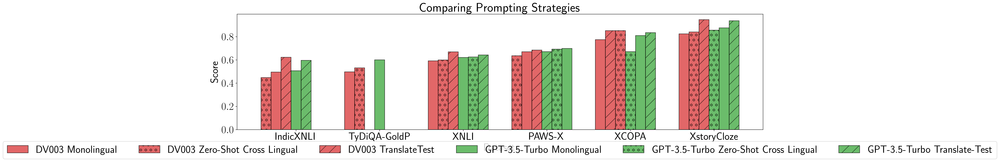

In [72]:

task_df = task_wise_avg
models = list(model2color.keys())
models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]
models = list(task_wise_avg.columns)[1:-1]
group_names = [model for model in models if not task_df[model].isna().all()]

task_df["Average Score"] = task_df[models].transpose().mean()
task_df = task_df.sort_values(by = ["Average Score"])

categories = task_df['Dataset'].tolist()

bar_width = 0.12
x = np.arange(len(categories))

hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(22.5, 5))

group_names = ["DV003 Monolingual", "DV003 Zero-Shot Cross Lingual", "DV003 TranslateTest",
              "GPT-3.5-Turbo Monolingual", "GPT-3.5-Turbo Zero-Shot Cross Lingual", "GPT-3.5-Turbo Translate-Test", 
              ]

task_df_melted = task_df.melt(id_vars="Dataset", value_vars = models, var_name="Model", value_name="Score")
task_df_melted["Model Class"] = task_df_melted["Model"].apply(lambda x: x.split()[0])
dataset2modelorder = task_df_melted.sort_values(["Model Class", "Score"]).groupby("Dataset")["Model"].unique().to_dict()

for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
    offsets = [dataset2modelorder[cat].tolist().index(group_name) for cat in categories]
    offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])

    l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel('Dataset')
ax.set_ylabel("Score")
ax.set_title("Comparing Prompting Strategies")
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
plt.savefig(f"../results/MEGA Results/plots/prompting_strategies.pdf", bbox_inches = "tight", dpi = 300)
plt.show()

In [73]:
lang2code = df.set_index("Language")["Language Code"].to_dict()
code2lang = df.set_index("Language Code")["Language"].to_dict()

In [74]:
model2color

{'DV003': (0.8392156862745098, 0.15294117647058825, 0.1568627450980392, 0.7),
 'DV003 Monolingual': (0.8392156862745098,
  0.15294117647058825,
  0.1568627450980392,
  0.7),
 'DV003 TranslateTest': (0.8392156862745098,
  0.15294117647058825,
  0.1568627450980392,
  0.7),
 'DV003 Zero-Shot Cross Lingual': (0.8392156862745098,
  0.15294117647058825,
  0.1568627450980392,
  0.7),
 'GPT-3.5-Turbo': (0.17254901960784313,
  0.6274509803921569,
  0.17254901960784313,
  0.7),
 'GPT-3.5-Turbo Monolingual': (0.17254901960784313,
  0.6274509803921569,
  0.17254901960784313,
  0.7),
 'GPT-3.5-Turbo Translate-Test': (0.17254901960784313,
  0.6274509803921569,
  0.17254901960784313,
  0.7),
 'GPT-3.5-Turbo Zero-Shot Cross Lingual': (0.17254901960784313,
  0.6274509803921569,
  0.17254901960784313,
  0.7),
 'GPT-4': (0.12156862745098039, 0.4666666666666667, 0.7058823529411765, 0.7),
 'GPT-4 Monolingual': (0.12156862745098039,
  0.4666666666666667,
  0.7058823529411765,
  0.7),
 'GPT-4 Translate-Test'

In [75]:
model_map = {
            "BLOOM": "BLOOM",
            "mBERT": "mBERT",
            "text-davinci-003": "DV003",
             "gpt-3.5-turbo": "GPT-3.5-Turbo",
             "gpt-4": "GPT-4",
             "gpt-3.5-turbo / gpt-4": "GPT-3.5-Turbo / GPT-4"
}

In [73]:
fertility_df

NameError: name 'fertility_df' is not defined

In [ ]:
fertility_df.sort_values("Fertility").groupby("Language")["Model"].unique().to_dict()

NameError: name 'fertility_df' is not defined

In [ ]:
fertility_df = pd.read_csv("fertility_latest.csv")
fertility_df["Model"] = fertility_df["Model"].map(model_map)

fertility_df["en_pref"] = fertility_df["Language"].apply(lambda x: 0 if x=="\\textsc{en}" else 1)
fertility_avg_df = fertility_df.groupby("Language")[["en_pref", "Fertility"]].mean().reset_index()
fertility_avg_df = fertility_avg_df.sort_values(by = ["en_pref", "Fertility"])
lang_codes = fertility_avg_df['Language'].unique().tolist()
fertility_df["LangId"] = fertility_df["Language"].apply(lambda x : lang_codes.index(x))
fertility_df = fertility_df.sort_values(by = "LangId")
categories = [code2lang[lang_code.replace("\\textsc{", "").replace("}","")] for lang_code in lang_codes]

# fertility_df = fertility_df.sort_values(by = "Fertility")


group_names = fertility_df["Model"].unique().tolist()
bar_width = 0.2
x = np.arange(len(categories))
alpha = 0.7
colors = [
        "#B90F22",
        "#951169",
        "#00689D",
        "#008877",
        "#D7AC00",
        "#B1BD00",
        "#CC4C03",
        "#611C73",
        "#7FAB16",
    ]
fig, ax = plt.subplots(figsize=(22.5, 5))
group_names = ["BLOOM", "mBERT", "GPT-3.5-Turbo / GPT-4", "DV003"]
lang2model_order = fertility_df.sort_values("Fertility").groupby("Language")["Model"].unique().to_dict()
for i, group_name in enumerate(group_names):
#     offset = (i - len(group_names) // 2) * bar_width
    sub_df = fertility_df[fertility_df["Model"] == group_name]
    offsets = [lang2model_order[lang_code].tolist().index(group_name) for lang_code in lang_codes]
    offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    
    l = ax.bar(x + offsets, sub_df["Fertility"].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color = model2color[group_name])
# ax.set_color_cycle(colors)
ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel('Language')
ax.set_ylabel("Tokenizer Fertility")
ax.legend(loc = "lower center", ncols = len(group_names), bbox_to_anchor=(0.5, -0.6))

# Rotate the x-axis labels if needed
plt.xticks(rotation=90)

# Set grid
plt.grid(axis='y', alpha=0.7)

plt.savefig(f"../results/MEGA Results/plots/fertility.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/fertility.png", bbox_inches = "tight", dpi = 300)
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: 'fertility_latest.csv'

In [ ]:
code2lang["ti"] = "Tiriginya"

In [ ]:
fertility_all = pd.read_csv("fertility_all_mega_langs.csv")
fertility_all["Language"] = fertility_all["Language"].apply(lambda x : code2lang[x.replace("\\textsc{", "").replace("}","")])
fertility_all

,Unnamed: 0,Language,Fertility,Model
0,34,Afrikaans,1.639922,mBERT
1,103,Afrikaans,1.804728,BLOOM
2,241,Afrikaans,1.944148,gpt-3.5-turbo / gpt-4
3,172,Afrikaans,2.083745,text-davinci-003
4,53,Amharic,1.003397,mBERT
...,...,...,...,...
271,185,Yoruba,3.695499,text-davinci-003
272,83,Chinese (S),1.352421,BLOOM
273,14,Chinese (S),1.515496,mBERT
274,221,Chinese (S),2.115274,gpt-3.5-turbo / gpt-4


In [ ]:
df

,Dataset,Task,Language,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,GPT-3.5-Turbo Monolingual,...,MuRIL,XGLM,mT5,PaLM 2 Zero-Shot,PaLM 2 Few-Shot,Bing Translator,Google Translator,Systran,Metrics,Direction
0,XNLI,Natural Language Inference,Arabic,ar,5.0,Arabic,0.522156,0.651098,0.585030,0.589820,...,NaN,0.464,0.7330,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter
1,XNLI,Natural Language Inference,Bulgarian,bg,3.0,Cyrillic,0.618164,0.707784,0.612575,0.635130,...,NaN,0.489,0.7860,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter
2,XNLI,Natural Language Inference,German,de,5.0,Latin,0.657884,0.717365,0.685030,0.673253,...,NaN,0.456,0.7740,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter
3,XNLI,Natural Language Inference,Greek,el,3.0,Greek,0.597006,0.692814,0.599202,0.650898,...,NaN,0.487,0.7710,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter
4,XNLI,Natural Language Inference,English,en,5.0,Latin,0.795210,0.795210,0.795210,0.762475,...,NaN,0.526,0.8470,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
232,XLSum,Summarization,Urdu,ur,3.0,Perso-Arabic,NaN,NaN,NaN,0.255500,...,NaN,NaN,0.3591,NaN,NaN,NaN,NaN,NaN,ROUGE-L,HigherBetter
233,XLSum,Summarization,Uzbek,uz,3.0,Latin,NaN,NaN,NaN,0.117800,...,NaN,NaN,0.1897,NaN,NaN,NaN,NaN,NaN,ROUGE-L,HigherBetter
234,XLSum,Summarization,Vietnamese,vi,4.0,Latin,NaN,NaN,NaN,0.208900,...,NaN,NaN,0.2876,NaN,NaN,NaN,NaN,NaN,ROUGE-L,HigherBetter
235,XLSum,Summarization,Welsh,cy,1.0,Latin,NaN,NaN,NaN,0.218900,...,NaN,NaN,0.2986,NaN,NaN,NaN,NaN,NaN,ROUGE-L,HigherBetter


In [ ]:
df_with_ferts = pd.merge(df, fertility_all[fertility_all["Model"] == "gpt-3.5-turbo / gpt-4"], on = "Language", how = "inner").reset_index()

In [ ]:
df_with_ferts["Dataset"] = df_with_ferts["Dataset"].apply(lambda x : "XNLI" if x == "IndicXNLI" else x)
# df_with_ferts["Dataset"] = df_with_ferts["Dataset"].apply(lambda x : "XQuAD" if x == "IndicQA" else x)

In [ ]:
xnli_with_ferts = df_with_ferts[df_with_ferts["Dataset"] == "XNLI"].reset_index()

In [ ]:
xnli_with_ferts[["GPT-3.5-Turbo Monolingual", "Fertility"]].corr()

,GPT-3.5-Turbo Monolingual,Fertility
GPT-3.5-Turbo Monolingual,1.00000,-0.78466
Fertility,-0.78466,1.00000


In [ ]:
import seaborn as sns

In [ ]:
xnli_with_ferts['Fertility']

0     1.782788
1     2.945463
2     2.029961
3     5.041534
4     1.224884
5     1.664977
6     1.376926
7     4.537173
8     4.537173
9     2.917628
10         NaN
11    4.117328
12    2.731259
13    3.925273
14    2.054141
15    9.342186
16    4.778125
17    9.114244
18         NaN
19         NaN
20         NaN
21    8.539604
22    4.364706
23         NaN
24         NaN
Name: Fertility, dtype: float64

In [ ]:
import seaborn as sns

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


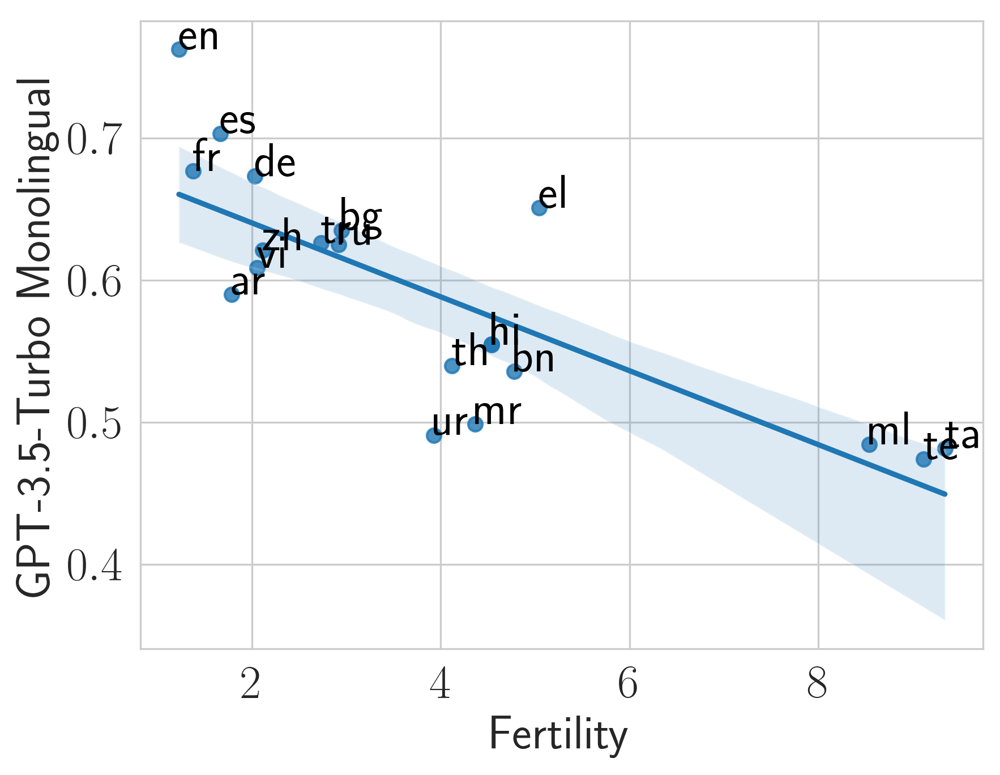

In [ ]:
sns.regplot(data = xnli_with_ferts, x = "Fertility", y = "GPT-3.5-Turbo Monolingual")
for i in range(len(xnli_with_ferts)):
    plt.text(xnli_with_ferts['Fertility'][i], 
             xnli_with_ferts['GPT-3.5-Turbo Monolingual'][i], 
             xnli_with_ferts['Language Code'][i], 
             horizontalalignment='left', size='medium', color='black', weight='semibold')

In [ ]:
xquad_with_ferts = df_with_ferts[df_with_ferts["Dataset"] == "XQuAD"].reset_index()
xquad_with_ferts = xquad_with_ferts.dropna(axis=0, subset=["Fertility"])
xquad_with_ferts = xquad_with_ferts.groupby(["Language", "Language Code"])[["GPT-3.5-Turbo Zero-Shot Cross Lingual", "GPT-4", "Fertility"]].mean().reset_index()

KeyError: "Columns not found: 'GPT-4'"

In [ ]:
xquad_with_ferts

,level_0,index,Dataset,Task,Language,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,...,PaLM 2 Zero-Shot,PaLM 2 Few-Shot,Bing Translator,Google Translator,Systran,Metrics,Direction,Unnamed: 0,Fertility,Model
0,1,1,XQuAD,Question Answering,Arabic,ar,5.0,Arabic,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,207,1.782788,gpt-3.5-turbo / gpt-4
1,14,14,XQuAD,Question Answering,German,de,5.0,Latin,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,209,2.029961,gpt-3.5-turbo / gpt-4
2,20,20,XQuAD,Question Answering,Greek,el,3.0,Greek,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,210,5.041534,gpt-3.5-turbo / gpt-4
3,26,26,XQuAD,Question Answering,English,en,5.0,Latin,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,211,1.224884,gpt-3.5-turbo / gpt-4
4,35,35,XQuAD,Question Answering,Spanish,es,5.0,Latin,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,212,1.664977,gpt-3.5-turbo / gpt-4
5,51,51,XQuAD,Question Answering,Hindi,hi,4.0,Devanagari,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,214,4.537173,gpt-3.5-turbo / gpt-4
6,60,60,XQuAD,Question Answering,Russian,ru,4.0,Cyrillic,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,215,2.917628,gpt-3.5-turbo / gpt-4
7,75,75,XQuAD,Question Answering,Thai,th,3.0,Brahmic,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,217,4.117328,gpt-3.5-turbo / gpt-4
8,81,81,XQuAD,Question Answering,Turkish,tr,4.0,Latin,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,218,2.731259,gpt-3.5-turbo / gpt-4
9,91,91,XQuAD,Question Answering,Vietnamese,vi,4.0,Latin,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,220,2.054141,gpt-3.5-turbo / gpt-4


In [ ]:
xquad_with_ferts[["GPT-3.5-Turbo Zero-Shot Cross Lingual", "Fertility"]].corr()

,GPT-3.5-Turbo Zero-Shot Cross Lingual,Fertility
GPT-3.5-Turbo Zero-Shot Cross Lingual,1.000000,-0.768311
Fertility,-0.768311,1.000000


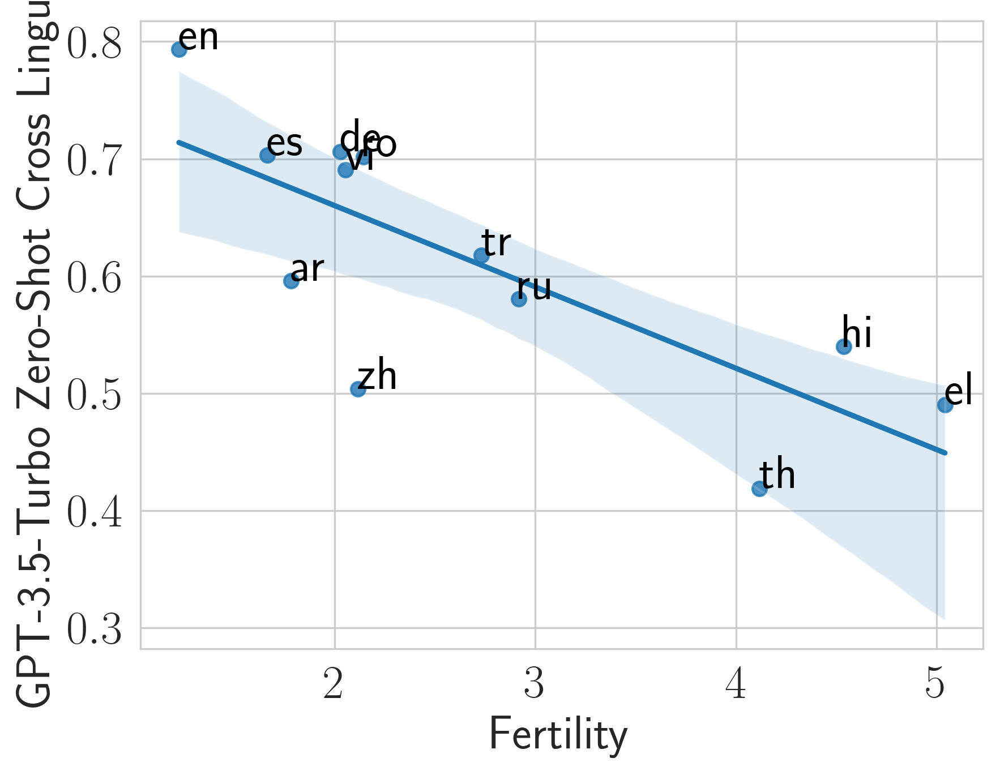

In [ ]:
sns.regplot(data = xquad_with_ferts, x = "Fertility", y = "GPT-3.5-Turbo Zero-Shot Cross Lingual")
for i in range(len(xquad_with_ferts)):
    plt.text(xquad_with_ferts['Fertility'][i], 
             xquad_with_ferts['GPT-3.5-Turbo Zero-Shot Cross Lingual'][i], 
             xquad_with_ferts['Language Code'][i], 
             horizontalalignment='left', size='medium', color='black', weight='semibold')

In [ ]:
!pip install adjustText



[notice] A new release of pip is available: 23.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip


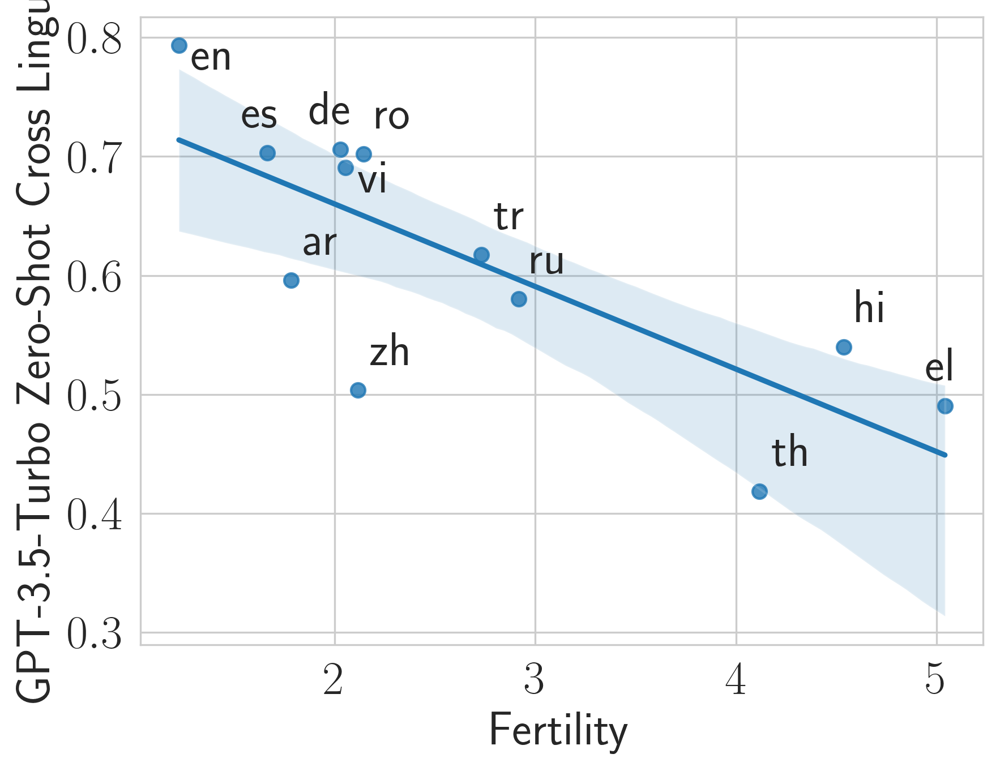

In [ ]:
from adjustText import adjust_text

sns.regplot(data = xquad_with_ferts, x = "Fertility", y = "GPT-3.5-Turbo Zero-Shot Cross Lingual")
# for i in range(len(xquad_with_ferts)):
#     plt.text(xquad_with_ferts['Fertility'][i], 
#              xquad_with_ferts['GPT-3.5-Turbo Zero-Shot Cross Lingual'][i], 
#              xquad_with_ferts['Language Code'][i], 
#              horizontalalignment='left', size='medium', color='black', weight='semibold')

labels = xquad_with_ferts['Language Code'].tolist()
x_coords = xquad_with_ferts['Fertility'].tolist()
y_coords = xquad_with_ferts['GPT-3.5-Turbo Zero-Shot Cross Lingual'].tolist()
label_coords = [(x, y) for x, y in zip(x_coords, y_coords)]

# Create a list of annotation objects
annotations = [
    plt.annotate(label, xy=(x, y), xytext=(5, 5),
                 textcoords='offset points', ha='left', va='bottom')
    for label, (x, y) in zip(labels, label_coords)
]

# Adjust the positions of labels to avoid overlap
adjust_text(annotations)

# Show the plot
plt.show()



In [ ]:
from scipy.stats import pearsonr
corr_coeff, p_value = pearsonr(xquad_with_ferts['Fertility'],  xquad_with_ferts['GPT-3.5-Turbo Zero-Shot Cross Lingual'])

NameError: name 'xquad_with_ferts' is not defined

In [ ]:
corr_coeff

NameError: name 'corr_coeff' is not defined

In [ ]:
p_value

NameError: name 'p_value' is not defined

In [ ]:
# dataset2corrs = {}
# for dataset, dataset_df in df_with_ferts.groupby("Dataset"):
#     model = "GPT-3.5-Turbo Monolingual"
#     if np.isnan(dataset_df[model].values[0]):
#         model = "GPT-3.5-Turbo Zero-Shot Cross Lingual"
#     dataset_df = dataset_df.dropna(axis=0, subset=["Fertility"])
#     corr_coeff, p_value = pearsonr(dataset_df['Fertility'],  dataset_df[model])
#     dataset2corrs[dataset] = {
#         "ro": corr_coeff,
#         "p_value": p_value
#     }
#     if abs(corr_coeff) > 0.65 and p_value <= 0.05:
#         sns.regplot(data = dataset_df, x = "Fertility", y = model, label = f"{dataset}, $\\rho = {np.round(corr_coeff, 2)}$")

# # df_with_ferts['LogFertility'] = df_with_ferts['Fertility'].apply(np.log)
# # unique_fertility = (df_with_ferts['LogFertility'].unique())
# # language_labels = df_with_ferts.groupby('LogFertility')['Language Code'].first().reindex(unique_fertility)
# # plt.xscale("log")

# # plt.xticks(unique_fertility, language_labels, rotation=45)
# plt.legend(loc = "lower center", ncols = 2, bbox_to_anchor=(0.5, -0.5))
# plt.ylabel("Score")
# plt.xlabel("Tokenizer Fertility")
# plt.title("GPT-3.5-Turbo")
# plt.savefig(f"../results/MEGA Results/plots/fertility

In [ ]:
unq_colors

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765, 0.7),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333, 0.7),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902, 0.7),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529, 0.7),
 (1.0, 0.4980392156862745, 0.054901960784313725, 0.7),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353, 0.7),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354, 0.7),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313, 0.7),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745, 0.7),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392, 0.7)]

In [ ]:
df_with_ferts["Dataset"].unique()

array(['XNLI', 'XQuAD', 'TyDiQA-GoldP', 'MLQA', 'UDPOS', 'PAN-X',
       'XstoryCloze', 'WinoMT', 'XLSum', 'PAWS-X', 'XCOPA', 'Jigsaw',
       'IndicQA'], dtype=object)

In [ ]:
dataset2color = {
    "XNLI": "tab:green",
    "IndicXNLI": "tab:green",
    "XQuAD": "tab:red",
    "IndicQA": "tab:brown",
    "TyDiQA-GoldP": "gold",
    "MLQA": "royalblue",
    "UDPOS": "crimson",
    "PAN-X": "purple",
    "XstoryCloze": "tab:purple",
    "WinoMT": "olive",
    "XLSum": "tab:orange",
    "PAWS-X": "tab:purple",
    "XCOPA": "tab:blue",
    "Jigsaw": "navy"
}

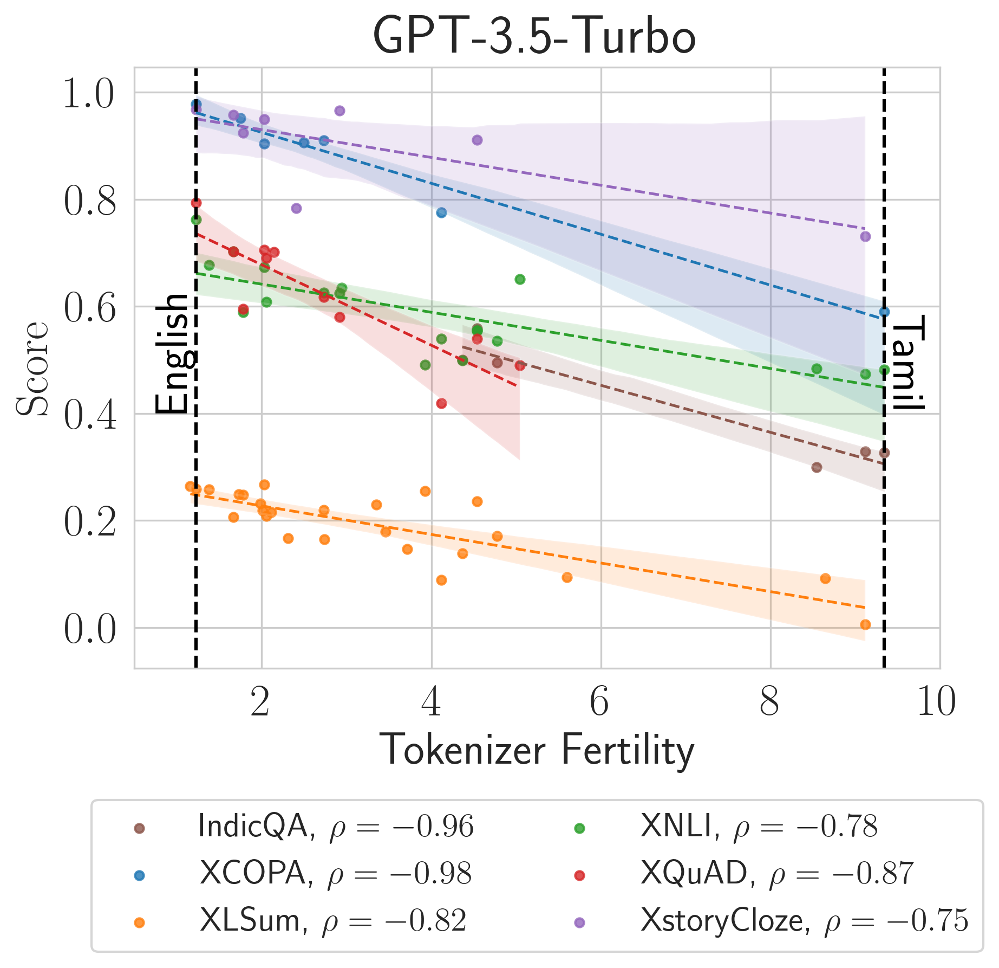

In [ ]:
dataset2corrs = {}
sns.set_style("whitegrid")
fig, ax = plt.subplots()

colors = list(set(model2color.values()))

for i, (dataset, dataset_df) in enumerate(df_with_ferts.groupby("Dataset")):
    model = "GPT-3.5-Turbo Monolingual"
    if np.isnan(dataset_df[model].values[0]):
        model = "GPT-3.5-Turbo Zero-Shot Cross Lingual"
    dataset_df = dataset_df.dropna(axis=0, subset=["Fertility"])
    corr_coeff, p_value = pearsonr(dataset_df['Fertility'],  dataset_df[model])
    dataset2corrs[dataset] = {
        "ro": corr_coeff,
        "p_value": p_value
    }
    if abs(corr_coeff) > 0.65 and p_value <= 0.05:
        sns.regplot(data = dataset_df, x = "Fertility", y = model,
                    label = f"{dataset}, $\\rho = {np.round(corr_coeff, 2)}$",
                    color = dataset2color[dataset], ax = ax, marker="o", line_kws={'linewidth': 1.2, "linestyle": "--"},
                   scatter_kws={"s": 15})

# df_with_ferts['LogFertility'] = df_with_ferts['Fertility'].apply(np.log)
# unique_fertility = (df_with_ferts['LogFertility'].unique())
# language_labels = df_with_ferts.groupby('LogFertility')['Language Code'].first().reindex(unique_fertility)
# plt.xscale("log")

# plt.xticks(unique_fertility, language_labels, rotation=45)
lang2fert = df_with_ferts.groupby("Language")["Fertility"].first()
max_fert, argmax_fert = lang2fert.max(), lang2fert.idxmax()
min_fert, argmin_fert = lang2fert.loc["English"], "English"

ax.axvline(min_fert, color='black', linestyle='--')
ax.axvline(max_fert, color='black', linestyle='--')

# Add text labels
ax.text(min_fert, 0.4, str(argmin_fert), va='bottom', ha='right', color='black', rotation = 90)
ax.text(max_fert, 0.4, str(argmax_fert), va='bottom', ha='left', color='black', rotation = 270)


plt.legend(loc = "lower center", ncols = 2, bbox_to_anchor=(0.5, -0.5))
plt.ylabel("$\mathrm{Score}$")
plt.xlabel("Tokenizer Fertility")
plt.title("GPT-3.5-Turbo")
plt.xlim(0.5,10)


plt.savefig(f"../results/MEGA Results/plots/fertility_score_corr.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/fertility_score_corr.png", bbox_inches = "tight", dpi = 300)

In [ ]:
with open(f"../results/corrs/fertility_score.json", "w") as f:
    json.dump(dataset2corrs, f, indent=4)

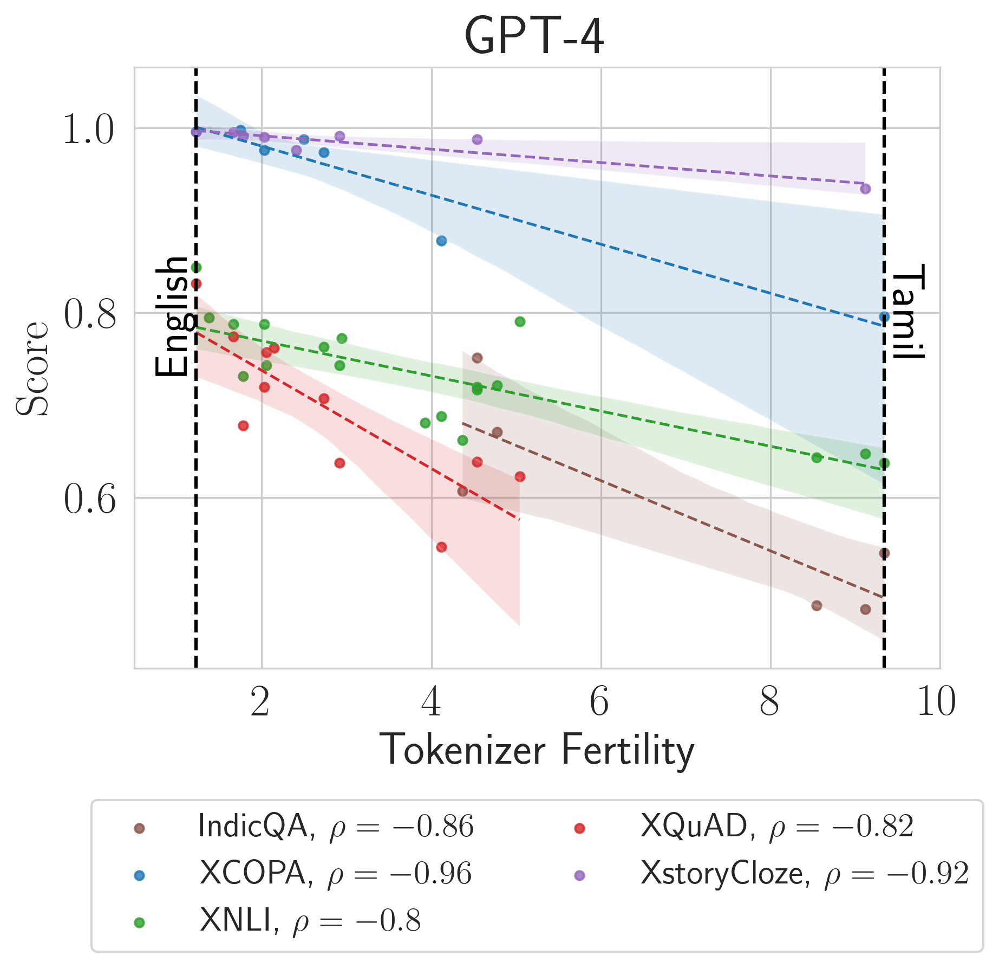

In [ ]:
dataset2corrs = {}
fig, ax = plt.subplots()
sns.set_style("whitegrid")
for dataset, dataset_df in df_with_ferts.groupby("Dataset"):
    if dataset in ["Jigsaw", "WinoMT"]:
        continue
    model = "GPT-4 Monolingual"
    if np.isnan(dataset_df[model].values[0]):
        model = "GPT-4 Zero-Shot Cross Lingual"
    dataset_df = dataset_df.dropna(axis=0, subset=["Fertility"])
    corr_coeff, p_value = pearsonr(dataset_df['Fertility'],  dataset_df[model])
    dataset2corrs[dataset] = {
        "ro": corr_coeff,
        "p_value": p_value
    }
    if abs(corr_coeff) > 0.65 and p_value <= 0.05:
        sns.regplot(data = dataset_df, x = "Fertility", y = model,\
                    label = f"{dataset}, $\\rho = {np.round(corr_coeff, 2)}$", ax = ax,
                    line_kws={'linewidth': 1.2, "linestyle": "--"},color=dataset2color[dataset],
                   scatter_kws={"s": 15})

# df_with_ferts['LogFertility'] = df_with_ferts['Fertility'].apply(np.log)
# unique_fertility = (df_with_ferts['LogFertility'].unique())
# language_labels = df_with_ferts.groupby('LogFertility')['Language Code'].first().reindex(unique_fertility)
# plt.xscale("log")

# plt.xticks(unique_fertility, language_labels, rotation=45)

# plt.xticks(unique_fertility, language_labels, rotation=45)
lang2fert = df_with_ferts.groupby("Language")["Fertility"].first()
max_fert, argmax_fert = lang2fert.max(), lang2fert.idxmax()
min_fert, argmin_fert = lang2fert.loc["English"], "English"

ax.axvline(min_fert, color='black', linestyle='--')
ax.axvline(max_fert, color='black', linestyle='--')

# Add text labels
ax.text(min_fert, 0.8, str(argmin_fert), va='center', ha='right', color='black', rotation = 90)
ax.text(max_fert, 0.8, str(argmax_fert), va='center', ha='left', color='black', rotation = 270)


plt.legend(loc = "lower center", ncols = 2, bbox_to_anchor=(0.5, -0.5))
plt.ylabel("$\mathrm{Score}$")
plt.xlabel("Tokenizer Fertility")
plt.title("GPT-4")
plt.xlim(0.5,10)

plt.savefig(f"../results/MEGA Results/plots/fertility_score_corr_gpt4.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/fertility_score_corr_gpt4.png", bbox_inches = "tight", dpi = 300)

In [ ]:
with open(f"../results/corrs/fertility_score_gpt4.json", "w") as f:
    json.dump(dataset2corrs, f, indent=4)

In [ ]:
dataset2corrs

{'IndicQA': {'ro': -0.8562203256125205, 'p_value': 0.029522742678284846},
 'MLQA': {'ro': -0.6742756509624124, 'p_value': 0.14186544481102623},
 'PAN-X': {'ro': -0.4422870154979185, 'p_value': 0.004813881984660692},
 'PAWS-X': {'ro': -0.6101559177571865, 'p_value': 0.19834367110625664},
 'TyDiQA-GoldP': {'ro': 0.0495313956154709, 'p_value': 0.9072804193013841},
 'UDPOS': {'ro': -0.30458525997267194, 'p_value': 0.06680921081056455},
 'XCOPA': {'ro': -0.9570950992451783, 'p_value': 0.0007155914954635274},
 'XLSum': {'ro': -0.5780364013572366, 'p_value': 0.0024751663783164003},
 'XNLI': {'ro': -0.8035199765311184, 'p_value': 3.4178055183748654e-05},
 'XQuAD': {'ro': -0.8188151784732512, 'p_value': 0.0020526834038943113},
 'XstoryCloze': {'ro': -0.9189857212157498, 'p_value': 0.0012498444147661606}}

Bad pipe message: %s [b'\x8c\xf2\x14\x18\x94\xf3\xbeZ"\xe5S\xb6\x8c\x1dK\xf4\xcd8\x00\x00|\xc0,\xc00\x00\xa3\x00\x9f\xcc\xa9\xcc\xa8\xcc\xaa\xc0\xaf\xc0\xad\xc0\xa3\xc0\x9f\xc0]\xc0a\xc0W\xc0S\xc0+\xc0/\x00\xa2\x00\x9e\xc0\xae\xc0\xac\xc0\xa2\xc0\x9e\xc0\\\xc0`\xc0V\xc0R\xc0$\xc0(\x00k\x00j\xc0#\xc0\'\x00g\x00@\xc0\n\xc0\x14\x009\x008\xc0\t\xc0\x13\x003\x002\x00\x9d\xc0\xa1\xc0\x9d\xc0Q\x00\x9c\xc0\xa0\xc0\x9c\xc0P\x00=\x00<\x005\x00/\x00\x9a\x00\x99\xc0\x07\xc0\x11\x00\x96\x00\x05\x00\xff\x01\x00\x00j\x00\x00\x00\x0e\x00\x0c\x00\x00\t127.0.0.1\x00\x0b\x00\x04\x03\x00\x01\x02\x00\n\x00\x0c\x00\n\x00\x1d\x00\x17\x00\x1e\x00\x19\x00\x18\x00#\x00\x00\x00']
Bad pipe message: %s [b'\x00\x00\x17\x00\x00\x00\r\x000\x00.\x04\x03\x05\x03\x06\x03\x08\x07\x08\x08']
Bad pipe message: %s [b'\x08\n\x08\x0b\x08\x04\x08', b'\x06\x04\x01\x05']
Bad pipe message: %s [b'']
Bad pipe message: %s [b"\xb4\xde\xc1\xc0\xddL\xf2:\xd5|H)\xe6H\xfb\xee\\T\x00\x00\xa6\xc0,\xc00\x00\xa3\x00\x9f\xcc\xa9\xcc\xa8\xcc\xa

In [ ]:
gpt_lang_data = pd.read_excel("LLMsPretrainingStats.xlsx", "GPT-3")
gpt_lang_data["Percentage"] = 100 * gpt_lang_data["Percentage"]
bloom_lang_data = pd.read_excel("LLMsPretrainingStats.xlsx", "BLOOM")
palm_lang_data = pd.read_excel("LLMsPretrainingStats.xlsx", "PALM")
palm_lang_data["Percentage"] = 100 * palm_lang_data["Percentage"]

In [ ]:
gpt_lang_data["LogPretrainingSize"] = gpt_lang_data["number of words"].apply(np.log10)

In [ ]:
gpt_lang_data

,Language,ISO Code,number of words,Percentage,LogPretrainingSize
0,English,en,181014683608,92.64708,11.257714
1,French,fr,3553061536,1.81853,9.550603
2,German,de,2870869396,1.46937,9.458013
3,Spanish,es,1510070974,0.77289,9.178997
4,Italian,it,1187784217,0.60793,9.074738
...,...,...,...,...,...
113,NaN,xx-Avst,213,0.00000,2.328380
114,NaN,xx-Bopo,188,0.00000,2.274158
115,NaN,xx-Linb,156,0.00000,2.193125
116,NaN,xx-Ogam,84,0.00000,1.924279


In [ ]:
gpt_lang_data["ISO Code"].unique()

array(['en', 'fr', 'de', 'es', 'it', 'pt', 'nl', 'ru', 'ro', 'pl', 'fi',
       'da', 'sv', 'ja', 'no', 'zh', 'cs', 'hu', 'id', 'tr', 'hr', 'vi',
       'el', 'ar', 'sr', 'zh-Hant', 'ca', 'ko', 'sk', 'th', 'sl', 'et',
       'fa', 'iw', 'uk', 'ms', 'lv', 'bs', 'lt', 'is', 'hi', 'sq', 'tl',
       'gl', 'jw', 'bg', 'af', 'ta', 'mr', 'cy', 'ml', 'bn', 'ga', 'az',
       'kn', 'my', 'te', 'uz', 'rw', 'ceb', 'ne', 'ku', 'eu', 'km', 'ka',
       'gd', 'hy', 'mt', 'si', 'pa', 'ur', 'kk', 'sw', 'st', 'be', 'mk',
       'mg', 'gu', 'lo', 'ht', 'lg', 'yi', 'tg', 'su', 'hmn', 'ny', 'or',
       'dv', 'ky', 'bh', 'xx-Goth', 'xx-Runr', 'iu', 'syr', 'mn',
       'xx-Phnx', 'xx-Qaai', 'xx-Egyp', 'xx-Nkoo', 'xx-Tfng', 'xx-Cakm',
       'xx-Yiii', 'chr', 'xx-Phag', 'xx-Tavt', 'xx-Dsrt', 'xx-Java',
       'xx-Sund', 'xx-Copt', 'xx-Glag', 'xx-Olck', 'xx-Shaw', 'xx-Samr',
       'xx-Avst', 'xx-Bopo', 'xx-Linb', 'xx-Ogam', 'xx-Cham'],
      dtype=object)

In [ ]:
df_wth_pretraining_size = pd.merge(
    df_with_ferts,
    gpt_lang_data,
    left_on="Language Code",
    right_on = "ISO Code", how = "inner"
).reset_index()

df_wth_pretraining_size["Dataset"] = df_wth_pretraining_size["Dataset"].apply(lambda x : "XNLI" if x == "IndicXNLI" else x)
# df_wth_pretraining_size["Dataset"] = df_wth_pretraining_size["Dataset"].apply(lambda x : "XQuAD" if x == "IndicQA" else x)

In [ ]:
df_wth_pretraining_size["Dataset"].unique()

array(['XNLI', 'XQuAD', 'TyDiQA-GoldP', 'MLQA', 'UDPOS', 'PAN-X',
       'XstoryCloze', 'WinoMT', 'XLSum', 'PAWS-X', 'XCOPA', 'Jigsaw',
       'IndicQA'], dtype=object)

In [ ]:
df_wth_pretraining_size[df_wth_pretraining_size["Dataset"] == "XNLI"]

,level_0,index,Dataset,Task,Language_x,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,...,Metrics,Direction,Unnamed: 0,Fertility,Model,Language_y,ISO Code,number of words,Percentage,LogPretrainingSize
0,0,0,XNLI,Natural Language Inference,Arabic,ar,5.0,Arabic,0.522156,0.651098,...,Accuracy,HigherBetter,207,1.782788,gpt-3.5-turbo / gpt-4,NaN,ar,60839973,0.03114,7.784189
9,9,9,XNLI,Natural Language Inference,Bulgarian,bg,3.0,Cyrillic,0.618164,0.707784,...,Accuracy,HigherBetter,208,2.945463,gpt-3.5-turbo / gpt-4,NaN,bg,5919807,0.00303,6.772308
12,12,12,XNLI,Natural Language Inference,German,de,5.0,Latin,0.657884,0.717365,...,Accuracy,HigherBetter,209,2.029961,gpt-3.5-turbo / gpt-4,German,de,2870869396,1.46937,9.458013
19,19,19,XNLI,Natural Language Inference,Greek,el,3.0,Greek,0.597006,0.692814,...,Accuracy,HigherBetter,210,5.041534,gpt-3.5-turbo / gpt-4,NaN,el,61607673,0.03153,7.789635
23,23,23,XNLI,Natural Language Inference,English,en,5.0,Latin,0.795210,0.795210,...,Accuracy,HigherBetter,211,1.224884,gpt-3.5-turbo / gpt-4,English,en,181014683608,92.64708,11.257714
33,33,33,XNLI,Natural Language Inference,Spanish,es,5.0,Latin,0.709980,0.721756,...,Accuracy,HigherBetter,212,1.664977,gpt-3.5-turbo / gpt-4,Spanish,es,1510070974,0.77289,9.178997
43,43,43,XNLI,Natural Language Inference,French,fr,5.0,Latin,0.656886,0.717565,...,Accuracy,HigherBetter,213,1.376926,gpt-3.5-turbo / gpt-4,French,fr,3553061536,1.81853,9.550603
50,50,50,XNLI,Natural Language Inference,Hindi,hi,4.0,Devanagari,0.476248,0.633333,...,Accuracy,HigherBetter,214,4.537173,gpt-3.5-turbo / gpt-4,NaN,hi,9434632,0.00483,6.974725
56,56,56,XNLI,Natural Language Inference,Hindi,hi,4.0,Devanagari,0.568862,0.625749,...,Accuracy,HigherBetter,214,4.537173,gpt-3.5-turbo / gpt-4,NaN,hi,9434632,0.00483,6.974725
59,59,59,XNLI,Natural Language Inference,Russian,ru,4.0,Cyrillic,0.622156,0.673453,...,Accuracy,HigherBetter,215,2.917628,gpt-3.5-turbo / gpt-4,Russian,ru,368157074,0.18843,8.566033


In [ ]:
df_wth_pretraining_size

,level_0,index,Dataset,Task,Language_x,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,...,Metrics,Direction,Unnamed: 0,Fertility,Model,Language_y,ISO Code,number of words,Percentage,LogPretrainingSize
0,0,0,XNLI,Natural Language Inference,Arabic,ar,5.0,Arabic,0.522156,0.651098,...,Accuracy,HigherBetter,207,1.782788,gpt-3.5-turbo / gpt-4,NaN,ar,60839973,0.03114,7.784189
1,1,1,XQuAD,Question Answering,Arabic,ar,5.0,Arabic,NaN,NaN,...,F1 Score,HigherBetter,207,1.782788,gpt-3.5-turbo / gpt-4,NaN,ar,60839973,0.03114,7.784189
2,2,2,TyDiQA-GoldP,Question Answering,Arabic,ar,5.0,Arabic,0.562014,NaN,...,F1 Score,HigherBetter,207,1.782788,gpt-3.5-turbo / gpt-4,NaN,ar,60839973,0.03114,7.784189
3,3,3,MLQA,Question Answering,Arabic,ar,5.0,Arabic,0.383943,0.481749,...,F1 Score,HigherBetter,207,1.782788,gpt-3.5-turbo / gpt-4,NaN,ar,60839973,0.03114,7.784189
4,4,4,UDPOS,Part of Speech Tagging,Arabic,ar,5.0,Arabic,NaN,NaN,...,F1 Score,HigherBetter,207,1.782788,gpt-3.5-turbo / gpt-4,NaN,ar,60839973,0.03114,7.784189
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
201,201,220,XLSum,Summarization,Scottish_gaelic,gd,1.0,Latin,NaN,NaN,...,ROUGE-L,HigherBetter,269,1.984705,gpt-3.5-turbo / gpt-4,NaN,gd,841970,0.00043,5.925297
202,202,221,XLSum,Summarization,Serbian_Latin,sr,4.0,Latin,NaN,NaN,...,ROUGE-L,HigherBetter,270,2.311438,gpt-3.5-turbo / gpt-4,NaN,sr,52875283,0.02706,7.723253
203,203,222,XLSum,Summarization,Sinhala,si,0.0,Brahmic,NaN,NaN,...,ROUGE-L,HigherBetter,271,8.643182,gpt-3.5-turbo / gpt-4,NaN,si,708343,0.00036,5.850244
204,204,224,XLSum,Summarization,Uzbek,uz,3.0,Latin,NaN,NaN,...,ROUGE-L,HigherBetter,274,NaN,gpt-3.5-turbo / gpt-4,NaN,uz,1458861,0.00075,6.164014


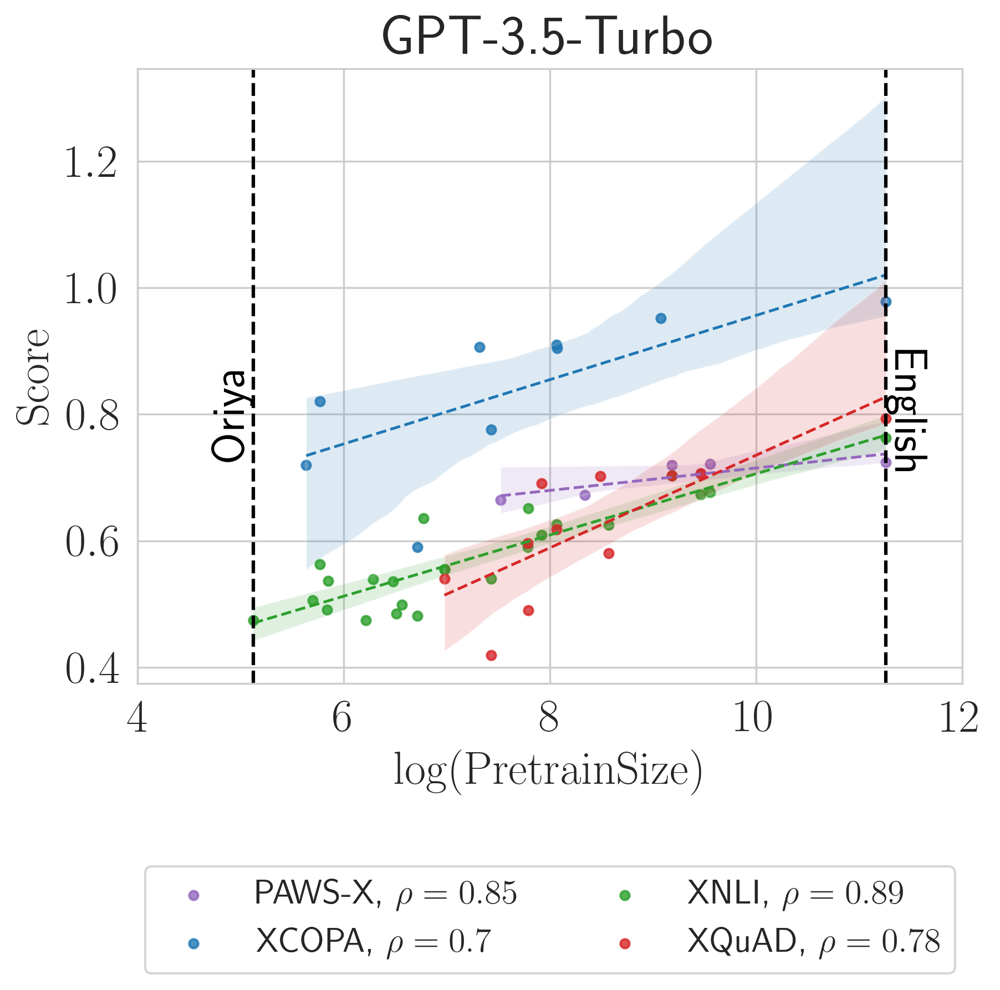

In [ ]:
dataset2corrs = {}
sns.set_style("whitegrid")
fig, ax = plt.subplots()
select_datasets = []
for dataset, dataset_df in df_wth_pretraining_size.groupby("Dataset"):
    model = "GPT-3.5-Turbo Monolingual"
    if np.isnan(dataset_df[model].values[0]):
        model = "GPT-3.5-Turbo Zero-Shot Cross Lingual"
    dataset_df = dataset_df.dropna(axis=0, subset=["LogPretrainingSize"])
    corr_coeff, p_value = pearsonr(dataset_df['LogPretrainingSize'],  dataset_df[model])
    dataset2corrs[dataset] = {
        "ro": corr_coeff,
        "p_value": p_value
    }
    if abs(corr_coeff) > 0.65 and p_value <= 0.05:
        sns.regplot(data = dataset_df, x = "LogPretrainingSize", y = model,
                    label = f"{dataset}, $\\rho = {np.round(corr_coeff, 2)}$",
                    ax = ax, line_kws={'linewidth': 1.2, "linestyle": "--"},color=dataset2color[dataset],
                   scatter_kws={"s": 15})
        select_datasets.append(dataset)
# df_with_ferts['LogFertility'] = df_with_ferts['Fertility'].apply(np.log)
# unique_fertility = (df_with_ferts['LogFertility'].unique())
# language_labels = df_with_ferts.groupby('LogFertility')['Language Code'].first().reindex(unique_fertility)
# plt.xscale("log")

# plt.xticks(unique_fertility, language_labels, rotation=45)
lang2ps = df_wth_pretraining_size[df_wth_pretraining_size["Dataset"].isin(select_datasets)].groupby("Language_x")["LogPretrainingSize"].first()
max_ps, argmax_ps = lang2ps.loc["English"], "English"
min_ps, argmin_ps = lang2ps.min(), lang2ps.idxmin()

ax.axvline(min_ps, color='black', linestyle='--')
ax.axvline(max_ps, color='black', linestyle='--')

# Add text labels
ax.text(min_ps, 0.8, str(argmin_ps), va='center', ha='right', color='black', rotation = 90)
ax.text(max_ps, 0.8, str(argmax_ps), va='center', ha='left', color='black', rotation = 270)


plt.legend(loc = "lower center", ncols = 2, bbox_to_anchor=(0.5, -0.5))
plt.ylabel("$\mathrm{Score}$")
plt.xlabel("$\\log(\mathrm{PretrainSize})$")
plt.title("GPT-3.5-Turbo")
plt.xlim(4, 12)

plt.savefig(f"../results/MEGA Results/plots/ps_score_corr.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/ps_score_corr.png", bbox_inches = "tight", dpi = 300)

In [ ]:
with open(f"../results/corrs/ps_score.json", "w") as f:
    json.dump(dataset2corrs, f,indent=4)

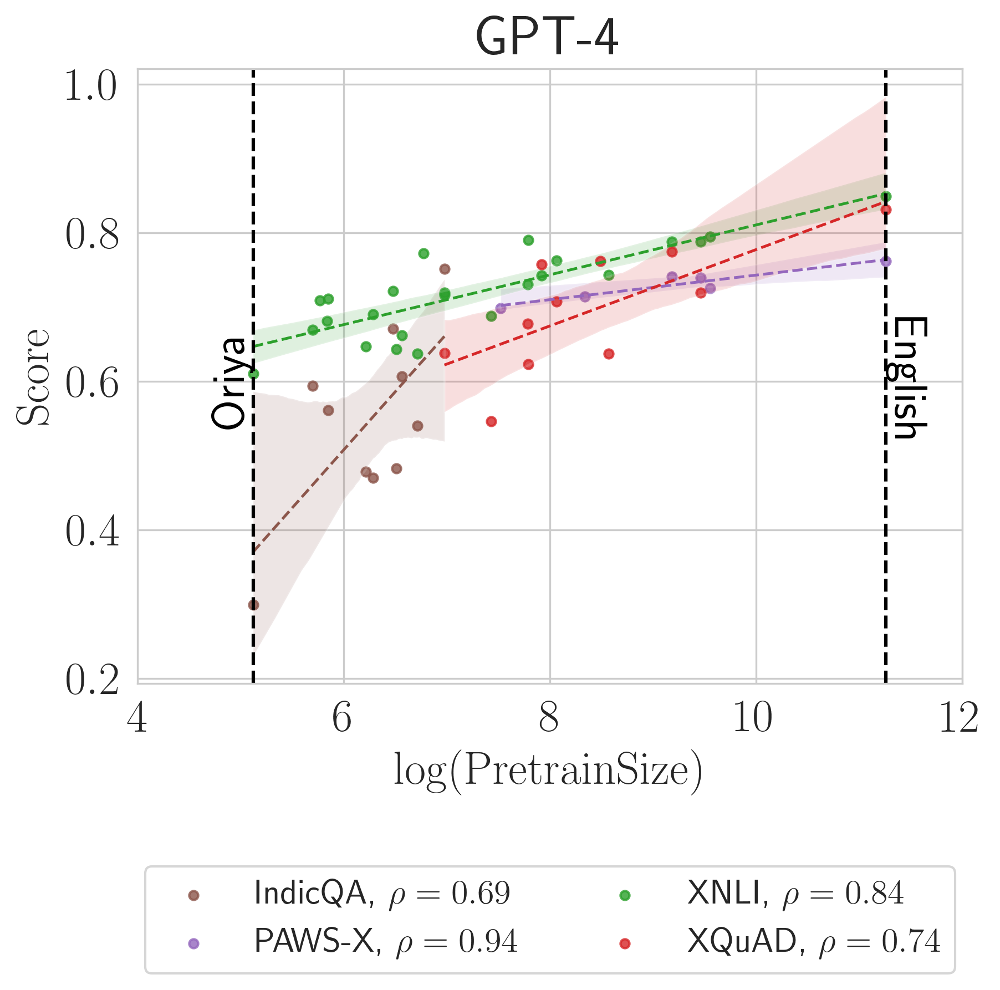

In [ ]:
dataset2corrs = {}
sns.set_style("whitegrid")
fig, ax = plt.subplots()
select_datasets = []
for dataset, dataset_df in df_wth_pretraining_size.groupby("Dataset"):
    if dataset in ["Jigsaw", "WinoMT"]:
        continue
    model = "GPT-4 Monolingual"
    
    if np.isnan(dataset_df[model].values[0]):
        model = "GPT-4 Zero-Shot Cross Lingual"
    dataset_df = dataset_df.dropna(axis=0, subset=["LogPretrainingSize"])
    corr_coeff, p_value = pearsonr(dataset_df['LogPretrainingSize'],  dataset_df[model])
    dataset2corrs[dataset] = {
        "ro": corr_coeff,
        "p_value": p_value
    }
    if abs(corr_coeff) > 0.65 and p_value <= 0.05:
        sns.regplot(data = dataset_df, x = "LogPretrainingSize", y = model, 
                    label = f"{dataset}, $\\rho = {np.round(corr_coeff, 2)}$", ax = ax,
                   line_kws={'linewidth': 1.2, "linestyle": "--"},color=dataset2color[dataset],
                   scatter_kws={"s": 15})
        select_datasets.append(dataset)
# df_with_ferts['LogFertility'] = df_with_ferts['Fertility'].apply(np.log)
# unique_fertility = (df_with_ferts['LogFertility'].unique())
# language_labels = df_with_ferts.groupby('LogFertility')['Language Code'].first().reindex(unique_fertility)
# plt.xscale("log")

# plt.xticks(unique_fertility, language_labels, rotation=45)
lang2ps = df_wth_pretraining_size[df_wth_pretraining_size["Dataset"].isin(select_datasets)].groupby("Language_x")["LogPretrainingSize"].first()
max_ps, argmax_ps = lang2ps.loc["English"], "English"
min_ps, argmin_ps = lang2ps.min(), lang2ps.idxmin()

ax.axvline(min_ps, color='black', linestyle='--')
ax.axvline(max_ps, color='black', linestyle='--')

# Add text labels
ax.text(min_ps, 0.6, str(argmin_ps), va='center', ha='right', color='black', rotation = 90)
ax.text(max_ps, 0.6, str(argmax_ps), va='center', ha='left', color='black', rotation = 270)


plt.legend(loc = "lower center", ncols = 2, bbox_to_anchor=(0.5, -0.5))
plt.ylabel("$\mathrm{Score}$")
plt.xlabel("$\\log(\mathrm{PretrainSize})$")
plt.title("GPT-4")
plt.xlim(4, 12)

plt.savefig(f"../results/MEGA Results/plots/ps_score_corr_gpt4.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/ps_score_corr_gpt4.png", bbox_inches = "tight", dpi = 300)

In [ ]:
dataset2corrs

{'IndicQA': {'ro': 0.6902860927826552, 'p_value': 0.02713928732232883},
 'MLQA': {'ro': 0.8086263494605161, 'p_value': 0.05143138893751391},
 'PAN-X': {'ro': 0.3266823093741559, 'p_value': 0.032506676233444234},
 'PAWS-X': {'ro': 0.9407228377128471, 'p_value': 0.005166529441222552},
 'TyDiQA-GoldP': {'ro': -0.1593226230644565, 'p_value': 0.6822180738674335},
 'UDPOS': {'ro': 0.35988921316680916, 'p_value': 0.03656109765454041},
 'XCOPA': {'ro': 0.48917339760287115, 'p_value': 0.1814087469283175},
 'XLSum': {'ro': 0.4904866850062687, 'p_value': 0.005089218303818333},
 'XNLI': {'ro': 0.8365463888612074, 'p_value': 3.525308529407918e-07},
 'XQuAD': {'ro': 0.7362097053231272, 'p_value': 0.009782816099492062},
 'XstoryCloze': {'ro': 0.40709032014702584, 'p_value': 0.2429723574253186}}

In [ ]:
with open(f"../results/corrs/ps_score_gpt4.json", "w") as f:
    json.dump(dataset2corrs, f,indent=4)

In [ ]:
df_with_tt_mon_rel = df[df["Dataset"] != "MLQA"].copy()

#Remove quechua and english
df_with_tt_mon_rel = df_with_tt_mon_rel[df_with_tt_mon_rel["Language Code"] != "en"]
df_with_tt_mon_rel = df_with_tt_mon_rel[df_with_tt_mon_rel["Language Code"] != "qu"]

df_with_tt_mon_rel["Translate-Test Relative Improvement"] = 100 * ( df["GPT-3.5-Turbo Translate-Test"] - df["GPT-3.5-Turbo Monolingual"] ) / df["GPT-3.5-Turbo Monolingual"] 

df_with_tt_mon_rel.dropna(axis=0, subset=["Translate-Test Relative Improvement"], inplace=True)

df_with_tt_mon_rel = df_with_tt_mon_rel.sort_values(by="Translate-Test Relative Improvement", ascending=False)
df_with_tt_mon_rel.head()

,Dataset,Task,Language,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,GPT-3.5-Turbo Monolingual,...,XGLM,mT5,PaLM 2 Zero-Shot,PaLM 2 Few-Shot,Bing Translator,Google Translator,Systran,Metrics,Direction,Translate-Test Relative Improvement
176,XstoryCloze,Commonsense Reasoning,Burmese,my,1.0,Burmese,0.473858,0.901390,0.580410,0.572469,...,0.612,NaN,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter,54.797688
22,XCOPA,Commonsense Reasoning,Tamil,ta,3.0,Tamil,0.538000,0.870000,0.870000,0.590000,...,0.563,0.492,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter,47.457627
169,IndicXNLI,Natural Language Inference,Telugu,te,1.0,Tegulu,0.471657,0.631138,0.426347,0.474052,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter,28.294737
179,XstoryCloze,Commonsense Reasoning,Telugu,te,1.0,Tegulu,0.576439,0.943084,0.630046,0.731304,...,0.634,NaN,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter,28.054299
164,IndicXNLI,Natural Language Inference,Malayalam,ml,1.0,Malayalam,0.482236,0.618164,0.432136,0.484431,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter,23.568191


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]),
 [Text(0, 0, 'Burmese'),
  Text(1, 0, 'Tamil'),
  Text(2, 0, 'Telugu'),
  Text(3, 0, 'Malayalam'),
  Text(4, 0, 'Oriya'),
  Text(5, 0, 'Gujarati'),
  Text(6, 0, 'Basque'),
  Text(7, 0, 'Marathi'),
  Text(8, 0, 'Punjabi'),
  Text(9, 0, 'Bengali'),
  Text(10, 0, 'Kannada'),
  Text(11, 0, 'Thai'),
  Text(12, 0, 'Haitian Creole'),
  Text(13, 0, 'Urdu'),
  Text(14, 0, 'Assamese'),
  Text(15, 0, 'Hindi'),
  Text(16, 0, 'Arabic'),
  Text(17, 0, 'Bulgarian'),
  Text(18, 0, 'Vietnamese'),
  Text(19, 0, 'Greek'),
  Text(20, 0, 'German'),
  Text(21, 0, 'Italian'),
  Text(22, 0, 'Russian'),
  Text(23, 0, 'French'),
  Text(24, 0, 'Turkish'),
  Text(25, 0, 'Chinese'),
  Text(26, 0, 'Indonesian'),
  Text(27, 0, 'Spanish'),
  Text(28, 0, 'English'),
  Text(29, 0, 'Swahili'),
  Text(30, 0, 'Estonian'),
  Text(31, 0, 'Korean'),
  Text(32, 0, 'Japanese')])

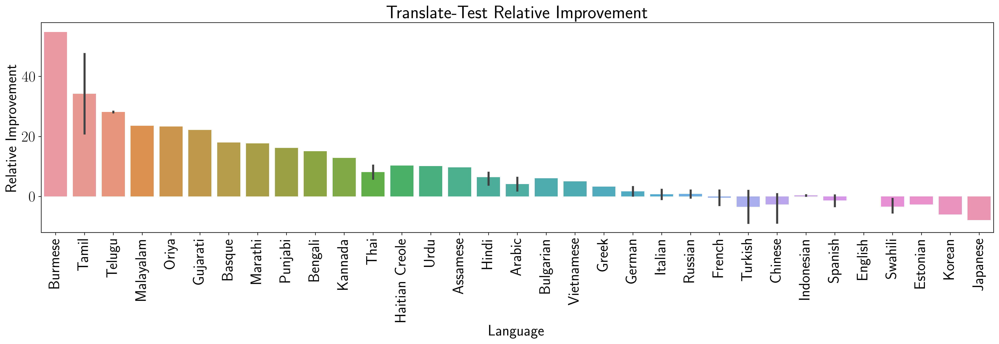

In [ ]:
import seaborn as sns
fig, ax = plt.subplots(figsize=(22.5, 5))
sns.barplot(data = df_with_tt_mon_rel, x = "Language", y = "Translate-Test Relative Improvement")
plt.title("Translate-Test Relative Improvement")
plt.ylabel("Relative Improvement")
plt.xticks(rotation=90)

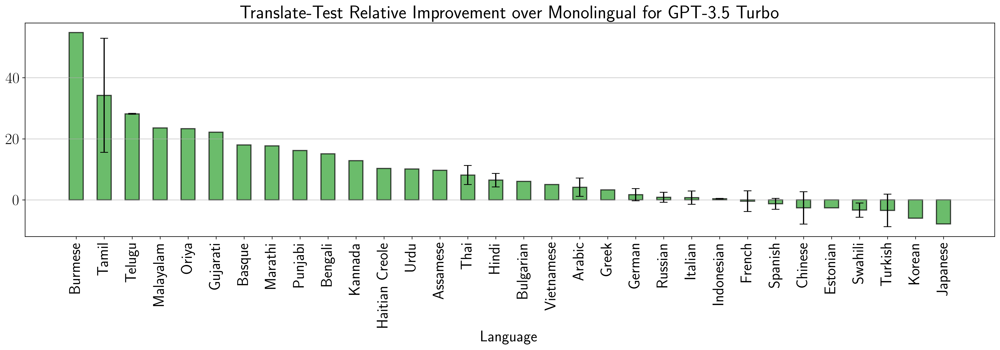

In [ ]:
grouped = df_with_tt_mon_rel.groupby('Language')['Translate-Test Relative Improvement']
mean_values = grouped.mean()
std_values = grouped.std()

# Sort the mean values in descending order
sorted_means = mean_values.sort_values(ascending=False)

# Reorder the language categories based on the sorted mean values
languages = sorted_means.index.tolist()

# Create a list of means and standard deviations in the sorted order
means = mean_values.loc[languages].tolist()
stds = std_values.loc[languages].tolist()

# Set the figure size
fig, ax = plt.subplots(figsize=(22.5, 5))
# Create the bar graph with error bars
alpha = 0.7
bar_width = 0.5
model = "GPT-3.5-Turbo Monolingual"
ax = plt.bar(languages, means, yerr=stds, capsize=5, width=bar_width, alpha = alpha,
          edgecolor='black', linewidth=1.5, color=model2color[model], hatch=model2hatches.get(model, ""))

# Set the labels and title
plt.xlabel('Language')
plt.ylabel('% Improvement')
plt.title('Translate-Test Relative Improvement over Monolingual for GPT-3.5 Turbo')

# Rotate the x-axis labels if needed
plt.xticks(rotation=90)

# Set grid
plt.grid(axis='y', alpha=0.7)

# Show the plot
plt.show()



In [ ]:
df_with_tt_mon_rel.head()

,Dataset,Task,Language,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,GPT-3.5-Turbo Monolingual,...,XGLM,mT5,PaLM 2 Zero-Shot,PaLM 2 Few-Shot,Bing Translator,Google Translator,Systran,Metrics,Direction,Translate-Test Relative Improvement
176,XstoryCloze,Commonsense Reasoning,Burmese,my,1.0,Burmese,0.473858,0.901390,0.580410,0.572469,...,0.612,NaN,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter,54.797688
22,XCOPA,Commonsense Reasoning,Tamil,ta,3.0,Tamil,0.538000,0.870000,0.870000,0.590000,...,0.563,0.492,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter,47.457627
169,IndicXNLI,Natural Language Inference,Telugu,te,1.0,Tegulu,0.471657,0.631138,0.426347,0.474052,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter,28.294737
179,XstoryCloze,Commonsense Reasoning,Telugu,te,1.0,Tegulu,0.576439,0.943084,0.630046,0.731304,...,0.634,NaN,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter,28.054299
164,IndicXNLI,Natural Language Inference,Malayalam,ml,1.0,Malayalam,0.482236,0.618164,0.432136,0.484431,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accuracy,HigherBetter,23.568191


In [ ]:
cmap = plt.cm.get_cmap("Greens", num_classes)
cmap(5)

/tmp/ipykernel_766337/3508547080.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap("Greens", num_classes)


(0.0, 0.26666666666666666, 0.10588235294117647, 1.0)

/tmp/ipykernel_766337/250110042.py:24: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap("Greens", num_classes)
/tmp/ipykernel_766337/250110042.py:49: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(plt.cm.ScalarMappable(cmap=cmap, norm = norm))


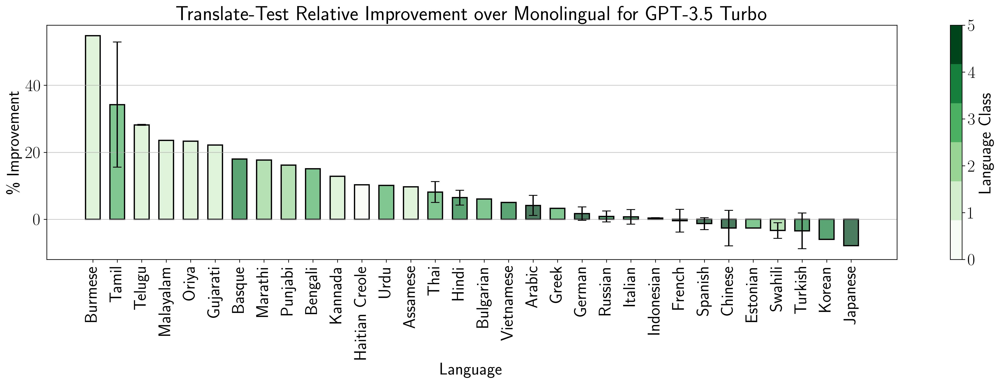

In [ ]:
import matplotlib.colors as mcolors

grouped = df_with_tt_mon_rel.groupby('Language')['Translate-Test Relative Improvement']
mean_values = grouped.mean()
std_values = grouped.std()

# Sort the mean values in descending order
sorted_means = mean_values.sort_values(ascending=False)

# Reorder the language categories based on the sorted mean values
languages = sorted_means.index.tolist()

# Create a list of means and standard deviations in the sorted order
means = mean_values.loc[languages].tolist()
stds = std_values.loc[languages].tolist()

# Get the 'Language Class' values in the sorted order
lang2class = df_with_tt_mon_rel.groupby('Language')['Language Class'].first().to_dict()
language_class = [lang2class[lang] for lang in languages]
# language_class = df_with_tt_mon_rel[df_with_tt_mon_rel['Language'].isin(languages)]['Language Class'].values

# Define a colormap based on the number of unique language classes
num_classes = len(np.unique(language_class))
cmap = plt.cm.get_cmap("Greens", num_classes)

# Set the figure size
fig, ax = plt.subplots(figsize=(22.5, 5))

# Create the bar graph with error bars and varying color shades
alpha = 0.7
bar_width = 0.6
model = "GPT-3.5-Turbo Monolingual"

# Normalize the 'Language Class' values to range from 0 to 1
norm = mcolors.Normalize(vmin=0, vmax=5)


bars = plt.bar(languages, means, yerr=stds, capsize=5,width=bar_width, edgecolor='black', linewidth=1.5,)

# Set the color of each bar based on the language class
for i, bar in enumerate(bars):
    color = cmap(int(language_class[i]))
    bar.set_color((*color[:3], alpha))
    bar.set_edgecolor('k')
    bar.set_width(bar_width)


# Create a colorbar legend for the language classes
cbar = plt.colorbar(plt.cm.ScalarMappable(cmap=cmap, norm = norm))
cbar.set_label('Language Class')

# Set the labels and title
plt.xlabel('Language')
plt.ylabel('\% Improvement')
plt.title('Translate-Test Relative Improvement over Monolingual for GPT-3.5 Turbo')

# Rotate the x-axis labels if needed
plt.xticks(rotation=90)

# Set grid
plt.grid(axis='y', alpha=0.7)

plt.savefig(f"../results/MEGA Results/plots/tt_rel_imp.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/tt_rel_imp.png", bbox_inches = "tight", dpi = 300)

# Show the plot
plt.show()


<Axes: xlabel='Language Class', ylabel='Translate-Test Relative Improvement'>

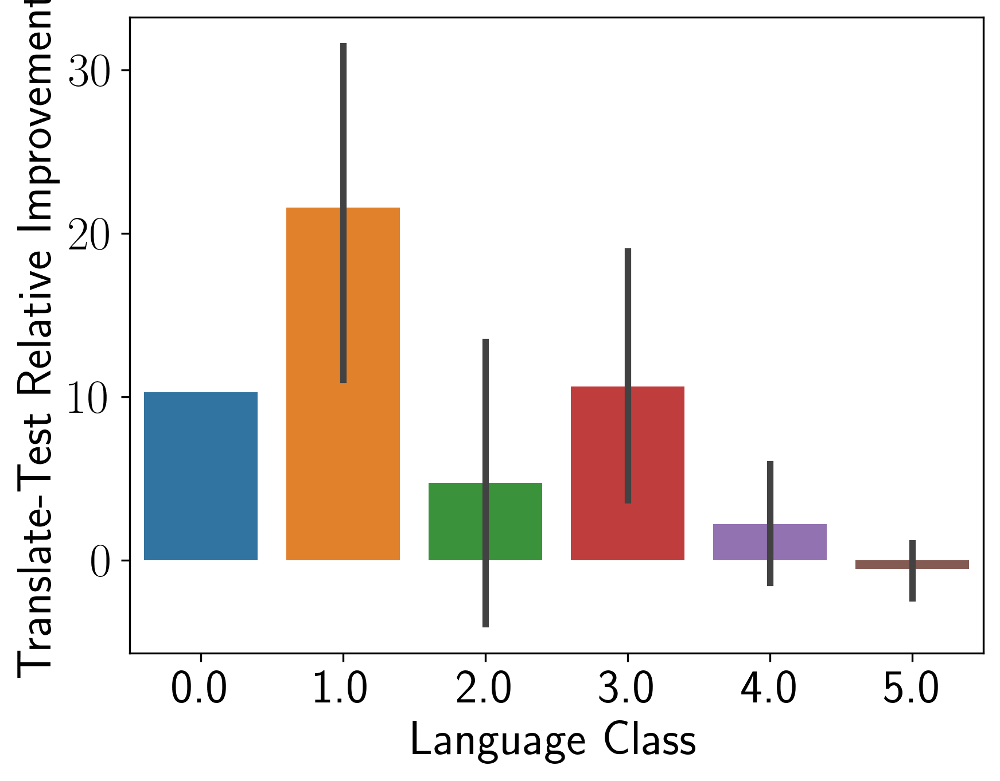

In [ ]:
sns.barplot(data = df_with_tt_mon_rel, x = "Language Class", y = "Translate-Test Relative Improvement")
plt.title("Translate-Test Relative Improvement")
plt.ylabel("Relative Improvement")
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 [Text(0, 0, 'Burmese'),
  Text(1, 0, 'Tamil'),
  Text(2, 0, 'Tegulu'),
  Text(3, 0, 'Malayalam'),
  Text(4, 0, 'Oriya'),
  Text(5, 0, 'Gujarati'),
  Text(6, 0, 'Latin'),
  Text(7, 0, 'Devanagari'),
  Text(8, 0, 'Gurmukhi'),
  Text(9, 0, 'Bengali'),
  Text(10, 0, 'Kannada'),
  Text(11, 0, 'Thai'),
  Text(12, 0, 'Perso-Arabic'),
  Text(13, 0, 'Assamese'),
  Text(14, 0, 'Arabic'),
  Text(15, 0, 'Cyrillic'),
  Text(16, 0, 'Greek'),
  Text(17, 0, 'Chinese'),
  Text(18, 0, 'Hangul'),
  Text(19, 0, 'Japanese')])

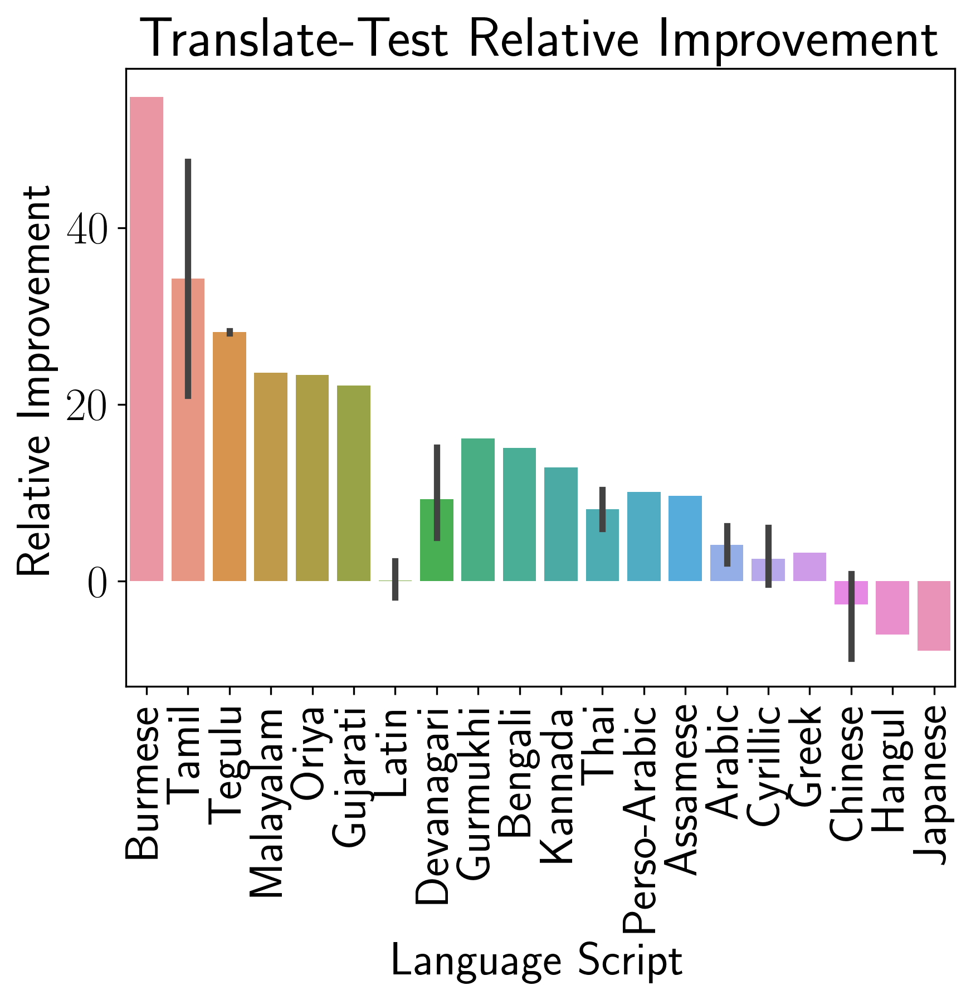

In [ ]:
sns.barplot(data = df_with_tt_mon_rel, x = "Language Script", y = "Translate-Test Relative Improvement")
plt.title("Translate-Test Relative Improvement")
plt.ylabel("Relative Improvement")
plt.xticks(rotation=90)

In [ ]:
df_w_lang_fams.columns

Index(['Dataset', 'Task', 'Language_x', 'Language Code', 'Language Class',
       'Language Script', 'DV003 Monolingual', 'DV003 TranslateTest',
       'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual',
       'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
       'GPT-4 Monolingual', 'GPT-4 Translate-Test',
       'GPT-4 Zero-Shot Cross Lingual', 'TULRv6', 'BLOOMZ', 'XLM-R', 'mBERT',
       'MuRIL', 'XGLM', 'mT5', 'PaLM 2 Zero-Shot', 'PaLM 2 Few-Shot',
       'Bing Translator', 'Google Translator', 'Systran', 'Metrics',
       'Direction', 'Language_y', 'ISO code',
       '# Wikipedia articles (in millions)', 'Script', 'Language family',
       'Diacritics special characters', 'Extensive compound mg',
       'Bound Words clitics', 'Inflection', 'Derivation', '# datasets with'],
      dtype='object')

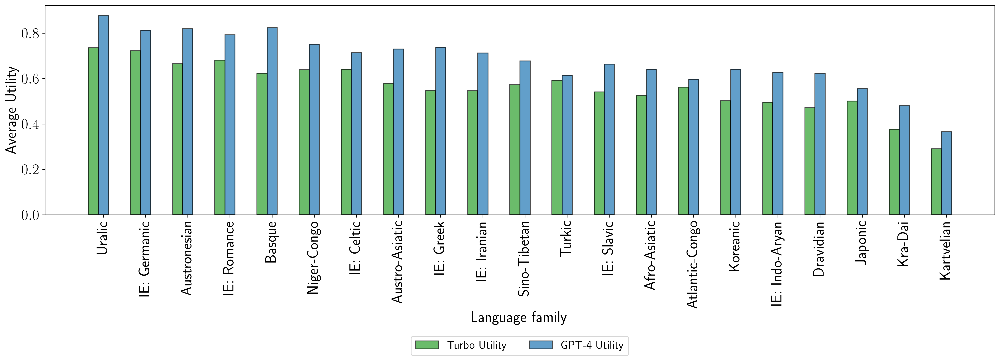

In [ ]:
var_name = "Language family"
# df_w_lang_fams = df_w_lang_fams[df_w_lang_fams["Dataset"] != "UDPOS"]
df_w_lang_fams["SOTA"] = df_w_lang_fams[models].max(axis=1)
df_w_lang_fams["Turbo Utility"] = df_w_lang_fams.apply(lambda x: x["GPT-3.5-Turbo Monolingual"] / dataset2en_best_perf.get(x["Dataset"], 1) ,axis = 1)
df_w_lang_fams["GPT-4 Utility"] = df_w_lang_fams.apply(lambda x: x["GPT-4 Monolingual"] / dataset2en_best_perf.get(x["Dataset"], 1) ,axis = 1)
df_norm_perf = df_w_lang_fams.groupby(var_name)[["Turbo Utility", "GPT-4 Utility"]].mean().reset_index()
df_norm_perf["Average Normalized"] = df_norm_perf[["Turbo Utility", "GPT-4 Utility"]].mean(axis = 1)
df_norm_perf = df_norm_perf.sort_values(by = "Average Normalized", ascending=False)

ut_models = ["Turbo Utility", "GPT-4 Utility"]
colors = [model2color["GPT-3.5-Turbo Monolingual"], model2color["GPT-4 Monolingual"]]

categories = df_norm_perf[var_name].tolist()
group_names = ut_models
bar_width = 0.24
x = np.arange(len(categories))

hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(22.5, 5))

# task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
# lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
#     offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
#     offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    l = ax.bar(x + offset, df_norm_perf[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color=colors[i])



# models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

# categories = task_df['Language'].tolist()
# group_names = [model for model in models if not task_df[model].isna().all()]
# bar_width = 0.12
# if task == "XCOPA":
#     bar_width = 0.1
# x = np.arange(len(categories))

# hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

# alpha = 0.7
# fig, ax = plt.subplots(figsize=(22.5, 5))

# for i, group_name in enumerate(group_names):
#     offset = (i - len(group_names) // 2) * bar_width
#     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
#           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel(var_name)
ax.set_ylabel("Average Utility")
# ax.set_title(task)
plt.xticks(rotation=90)
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.7))
# plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums.pdf", bbox_inches = "tight", dpi = 300)
plt.show()


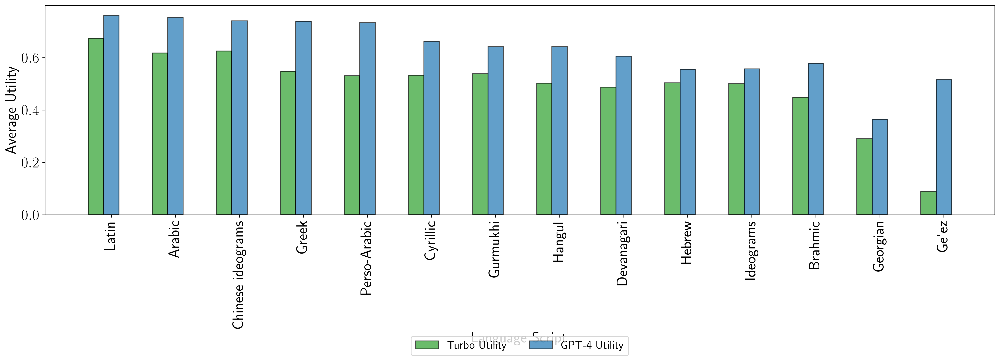

Bad pipe message: %s [b"\x91\x03\x0bI^+W\xf2e\x81\xef\xe9\x82\x1f\x1e+\x83\xff\x00\x00|\xc0,\xc00\x00\xa3\x00\x9f\xcc\xa9\xcc\xa8\xcc\xaa\xc0\xaf\xc0\xad\xc0\xa3\xc0\x9f\xc0]\xc0a\xc0W\xc0S\xc0+\xc0/\x00\xa2\x00\x9e\xc0\xae\xc0\xac\xc0\xa2\xc0\x9e\xc0\\\xc0`\xc0V\xc0R\xc0$\xc0(\x00k\x00j\xc0#\xc0'\x00g\x00@\xc0\n\xc0\x14\x009\x008\xc0\t\xc0\x13\x003\x002\x00\x9d\xc0\xa1\xc0\x9d\xc0Q\x00\x9c\xc0\xa0\xc0\x9c\xc0P\x00=\x00<\x005\x00/\x00\x9a\x00\x99\xc0\x07\xc0\x11\x00\x96\x00\x05\x00\xff\x01\x00\x00j\x00\x00\x00\x0e\x00\x0c\x00\x00\t127.0.0.1\x00\x0b\x00\x04\x03\x00\x01\x02\x00\n\x00\x0c\x00\n\x00\x1d\x00\x17\x00\x1e\x00\x19\x00\x18\x00#\x00\x00\x00\x16\x00\x00\x00\x17\x00\x00\x00\r\x000\x00.\x04\x03\x05\x03\x06\x03\x08\x07"]
Bad pipe message: %s [b'\x08\t\x08\n\x08\x0b\x08']
Bad pipe message: %s [b'\x05\x08\x06']
Bad pipe message: %s [b'\x05\x01\x06', b'', b'\x03\x03']
Bad pipe message: %s [b'']
Bad pipe message: %s [b'\x87\xa5&0\xd9wI\xc8\xa0\xa4\xca"\xf5\xfc\x06\xe0n\x96\x00\x00\xa6\x

In [ ]:
var_name = "Language Script"
# df_w_lang_fams = df_w_lang_fams[df_w_lang_fams["Dataset"] != "UDPOS"]
df_w_lang_fams["SOTA"] = df_w_lang_fams[models].max(axis=1)
df_w_lang_fams["Turbo Utility"] = df_w_lang_fams.apply(lambda x: x["GPT-3.5-Turbo Monolingual"] / dataset2en_best_perf.get(x["Dataset"], 1) ,axis = 1)
df_w_lang_fams["GPT-4 Utility"] = df_w_lang_fams.apply(lambda x: x["GPT-4 Monolingual"] / dataset2en_best_perf.get(x["Dataset"], 1) ,axis = 1)
df_norm_perf = df_w_lang_fams.groupby(var_name)[["Turbo Utility", "GPT-4 Utility"]].mean().reset_index()
df_norm_perf["Average Normalized"] = df_norm_perf[["Turbo Utility", "GPT-4 Utility"]].mean(axis = 1)
df_norm_perf = df_norm_perf.sort_values(by = "Average Normalized", ascending=False)

ut_models = ["Turbo Utility", "GPT-4 Utility"]
colors = [model2color["GPT-3.5-Turbo Monolingual"], model2color["GPT-4 Monolingual"]]

categories = df_norm_perf[var_name].tolist()
group_names = ut_models
bar_width = 0.24
x = np.arange(len(categories))

hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(22.5, 5))

# task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
# lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
#     offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
#     offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    l = ax.bar(x + offset, df_norm_perf[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color=colors[i])



# models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

# categories = task_df['Language'].tolist()
# group_names = [model for model in models if not task_df[model].isna().all()]
# bar_width = 0.12
# if task == "XCOPA":
#     bar_width = 0.1
# x = np.arange(len(categories))

# hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

# alpha = 0.7
# fig, ax = plt.subplots(figsize=(22.5, 5))

# for i, group_name in enumerate(group_names):
#     offset = (i - len(group_names) // 2) * bar_width
#     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
#           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel(var_name)
ax.set_ylabel("Average Utility")
# ax.set_title(task)
plt.xticks(rotation=90)
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.7))
# plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums.pdf", bbox_inches = "tight", dpi = 300)
plt.show()
